# __Part A: Generative Adversarial Networks__

<a class="anchor" id="1"></a>
## <font color='#71a1e3'> __Problem Understanding__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### __What is GAN?__

Gan represnts Generative Adversarial Networks which is all about creating here. Generally it is harder compared to other deep learning fields.

The main focus of GAN is to generate data be it images or videos or music from scratch and generally what does GAN consist of?

GAN are algorithic architectures that uses 2 neural networks, putting one against the other. This is to generate new, synthetic instances of data that can be pass as real data.

Generally, widely use in image generation, voice generation etc. 

GAN also work with competition of two different parts


__Generator__
1. For this, you can input random images, known as random noise. This random images can be anything.
2. Through the generator, it will generate a sample that hopefully ends up like the real dataset if the generator and discrimintor and discriminator both are trained good enough
3. Output is sometimes refered to as latent space or a latent vector

What can we do to optimise?
1. Output must be pass through the generator through the discriminator, which then backpropagate and calculate the erros both the generator and discriminator 
2. Gan is also a form of decovolution and parameters, such as stride, padding, kernel size



__Discriminator__ 
1. For this, input the real images from actual data tha needs to be generated like CIFAR1
2. Also, you input the output of generator into the discriminator
3. Convolutional layer of discrimnator is the normal convolution we are used to.
4. This are downscaled to the input that is suitable for classification. 



__How can we optimise both as a whole?__
After data is passed through both generator and discriminator, optimisation with backpropagation begins, the goal is to kepp improving at a level pace for both models to be good at its role, equilibrium point is exactly when the discriminator is leaning 50% to both sides, meaning that both images could either be real or fake, where the generator model tries to minimize the probability that the discriminator will predict the generator's output as fake. On the other side, the discriminator tries to maximize the probability that it will correctly classify both real and fake image

<a class="anchor" id="1"></a>
## <font color='#71a1e3'> __Import Libraries__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [1]:
!pip install -q keras-tuner pandas matplotlib seaborn scikit-learn tqdm tensorflow_addons scikit-image imblearn

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


### Other Imports

In [2]:
import numpy as np
import pandas as pd

import seaborn as sns
from matplotlib import pyplot as plt

from sklearn.metrics import classification_report,accuracy_score, confusion_matrix
from sklearn.decomposition import PCA

from sklearn.preprocessing import Normalizer
from sklearn.metrics import classification_report, accuracy_score

import os, time, math, datetime, warnings, pytz, glob
from IPython.display import display
from functools import reduce
import absl.logging
from tqdm import tqdm
import logging
from scipy.linalg import sqrtm
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.linalg import sqrtm
from skimage.transform import resize
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
from sklearn.utils import resample
from sklearn.neighbors import NearestNeighbors
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
import numpy as np
from PIL import Image, ImageFilter
absl.logging.set_verbosity(absl.logging.ERROR)
logging.getLogger('tensorflow').disabled = True
warnings.filterwarnings('ignore')

### Tensorflow Import

In [3]:
import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
from tensorflow.keras.models import Model
import numpy as np
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.utils import Sequence, to_categorical
from tensorflow import expand_dims
from tensorflow.keras import Sequential
from tensorflow.keras import layers as L
from tensorflow.keras import backend as K
from tensorflow.image import random_flip_left_right, random_crop, resize_with_crop_or_pad
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import (Embedding, Dense, Input, InputLayer, Normalization, Flatten,BatchNormalization,
    Dropout,Conv2D, GlobalAveragePooling2D, MaxPooling2D, ReLU, Layer,Activation, Multiply, AveragePooling2D,
    Add, RandomRotation,Resizing, Rescaling, Reshape, Concatenate, concatenate, Lambda,LeakyReLU)
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau, TerminateOnNaN, TensorBoard, CSVLogger, Callback
from tensorflow.keras.backend import clear_session
from tensorflow.keras.optimizers import RMSprop, SGD, Adam, Adagrad, Adamax
from tensorflow.keras.regularizers import l2, L2
from tensorflow.keras.optimizers.schedules import *
from tensorflow.keras.metrics import FalseNegatives, categorical_crossentropy, sparse_categorical_crossentropy,BinaryCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.image import *
from tensorflow_addons.optimizers import SWA
from tensorflow.keras.layers import Dense, Reshape, LeakyReLU, UpSampling2D, Conv2D
from tensorflow.keras.optimizers import Adam
from sklearn.metrics.pairwise import pairwise_kernels
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import PReLU,Dense, GlobalAveragePooling2D, Input, Conv2DTranspose
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, LeakyReLU, GlobalAveragePooling2D, Dense, Concatenate
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.initializers import RandomNormal
from tensorflow_addons.layers import SpectralNormalization
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input

from tensorflow.keras.datasets import cifar10
from kerastuner.tuners import Hyperband
from kerastuner import HyperModel
# Setting a seaborn style
sns.set(style="whitegrid")







### Set the seed of this notebook

In [4]:
seed = 32
tf.random.set_seed(seed)
np.random.seed(seed)

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Check for GPU__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">

Here is check the available GPUs and set the memory growth

In [5]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(f"{len(gpus)} Physical GPUs, {len(logical_gpus)} Logical GPU")
    except RuntimeError as e:
        print(e)

1 Physical GPUs, 1 Logical GPU


In [6]:
!nvidia-smi

Fri Feb  2 00:06:01 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.154.05             Driver Version: 535.154.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 4090        On  | 00000000:81:00.0 Off |                  Off |
|  0%   45C    P2              55W / 450W |    545MiB / 24564MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Import Dataset__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [7]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data

In [8]:
y_train = to_categorical(y_train)

In [9]:
x_train.shape

(50000, 32, 32, 3)

### Set the labels for the Classes

This is so that we are able to use it for EDA and model training later on

In [10]:
cifarLab = ["airplane", "automobile", "bird", "cat", "deer", "dog", "frog", "horse", "ship", "truck"]
class_labels = {idx: label for idx, label in enumerate(cifarLab)}
print(class_labels)

{0: 'airplane', 1: 'automobile', 2: 'bird', 3: 'cat', 4: 'deer', 5: 'dog', 6: 'frog', 7: 'horse', 8: 'ship', 9: 'truck'}


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Feature Engineering__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


Below is the idea of feature engineering

1. **Convert Data Type**:
    ```python
    x_train = x_train.astype('float32')
    ```
    This line converts the data type of `x_train` elements to `float32`. It's a standard practice to use floating-point numbers in computations involving neural networks due to their capability to represent decimal values, which are crucial for the granularity of learning.

2. **Scale the Data**:
    ```python
    x_train /= (255/2)
    ```
    Here, the pixel values of the images (assuming `x_train` contains image data) are scaled. Usually, image data comes in the format of integers ranging from 0 to 255 (8-bit representation). This operation scales the data to a new range. Dividing by `(255/2)` scales the data to a range of [0, 2].

3. **Shift the Data**:
    ```python
    x_train -= 1
    ```
    This operation shifts the data range from [0, 2] to [-1, 1]. Shifting data to be centered around zero (mean = 0) can significantly improve the convergence during training, as it ensures that the input features have similar scales.




In [11]:
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
latent_dim = 128

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Evaluation Metrics__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### KID (Kernel Inception Distance)
1. Metrics used for evaluting the quality of images generated by GAN. This measures the similarity between two sets of images by comparing the statistics of deep features. These uses the pre trained Inception model

   $$
   MMD^2 = \frac{1}{m^2} \sum_{i=1}^{m} \sum_{j=1}^{m} K(x_i, x_j) + \frac{1}{n^2} \sum_{i=1}^{n} \sum_{j=1}^{n} K(y_i, y_j) - \frac{2}{mn} \sum_{i=1}^{m} \sum_{j=1}^{n} K(x_i, y_j)
   $$

- Compute the kernel metrics using kernel function
- Calculate the mean Maximum Mean Discrepancy
- Final average KID values computed over entire dataset
### FID
- Metrics that compares the statistics of generated images to real images in the feature space of a deep learning model (Inception model) and calculate the distance betwen the feature vectors of the real and generated images, lower FID implies that better quality of generated images

$$
FID = ||\mu_x - \mu_y||^2 + Tr(\Sigma_x + \Sigma_y - 2(\Sigma_x \Sigma_y)^{1/2})
$$
- Includes the Euclidean distance between mean vectors of real and generated images
- Tr denotes the trace of matrix
$$
(\Sigma_x \Sigma_y)^{1/2}
$$
 Denotes the sqaure root of the product of the covariance matrices which is computed using methods eigen decomposition




In [12]:

class Evaluation:
    def __init__(self, generator, latent_dim, sizeOfBatch, sample_size, sizeOfBuffer):
        self.generator = generator
        self.latent_dim = latent_dim
        self.sizeOfBatch = sizeOfBatch
        self.sample_size = sample_size
        self.sizeOfBuffer = sizeOfBuffer

        self.inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
        self.AUTO = tf.data.experimental.AUTOTUNE

    def generate_images(self, num_images,labels=None):
        print(labels)
        if labels is not None:
            random_latent_vectors = tf.random.normal(shape=(num_images, self.latent_dim))
            labels = tf.one_hot(labels, depth=10)  # Adjust 'self.num_classes' as per your class count# Adjust shape as needed
            generated_images = self.generator.predict([random_latent_vectors, labels])
        else:
            random_latent_vectors = tf.random.normal(shape=(num_images, self.latent_dim))
            generated_images = self.generator.predict(random_latent_vectors)
        return generated_images

    def plot_loss_curve(self, history, title='Loss Curve'):
        plt.figure(figsize=(10, 5))
        plt.plot(history['g_loss'], label='Generator Loss')
        plt.plot(history['d_loss'], label='Discriminator Loss')
        plt.title(title)
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True)
        plt.show()

    def compute_metrics(self, train_data,cgan=False):
        # Preparing real and generated images
        real_images = tf.data.Dataset.from_tensor_slices(train_data).shuffle(self.sizeOfBuffer).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        
        if cgan:
            class_labels = np.arange(10)
            class_labels = np.repeat(class_labels, self.sample_size / 10).flatten()
            generated_images = self.generate_images(self.sample_size, class_labels)
            generated_images = tf.data.Dataset.from_tensor_slices(generated_images).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        else:
            generated_images = self.generate_images(self.sample_size)
            generated_images = tf.data.Dataset.from_tensor_slices(generated_images).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        real_embeddings = self.__compute_embeddings(real_images, math.ceil(len(train_data) / self.sizeOfBatch))
        generated_embeddings = self.__compute_embeddings(generated_images, math.ceil(self.sample_size / self.sizeOfBatch))

        fid = self.__calculate_fid(real_embeddings, generated_embeddings)
        kid = self.__calculate_kid(real_embeddings, generated_embeddings)
        return fid, kid

        
    def __calculate_kid(self,real_embeddings, generated_embeddings):
        # Polynomial kernel computation
        kernel_real = pairwise_kernels(real_embeddings, metric='polynomial', degree=3)
        kernel_gen = pairwise_kernels(generated_embeddings, metric='polynomial', degree=3)
        kernel_real_gen = pairwise_kernels(real_embeddings, generated_embeddings, metric='polynomial', degree=3)

        m = real_embeddings.shape[0]
        n = generated_embeddings.shape[0]

        # KID calculation
        kid = (np.sum(kernel_real) / (m * (m - 1)) +
               np.sum(kernel_gen) / (n * (n - 1)) -
               2 * np.sum(kernel_real_gen) / (m * n))
        return kid
    def __scale_and_preprocess(self, image):
        image = (image + 1) / 2 * 255.0
        image = preprocess_input(image)
        return tf.image.resize(image, (299, 299))

    def __compute_embeddings(self, dataloader, count):
        embeddings = []
        for batch in (dataloader.take(count)):
            batch_embeddings = self.inception_model.predict(batch, verbose=0)
            embeddings.extend(batch_embeddings)
        return np.array(embeddings)

    def __calculate_fid(self, real_embeddings, generated_embeddings):
        mu1, sigma1 = real_embeddings.mean(axis=0), np.cov(real_embeddings, rowvar=False)
        mu2, sigma2 = generated_embeddings.mean(axis=0), np.cov(generated_embeddings, rowvar=False)
        ssdiff = np.sum((mu1 - mu2)**2.0)
        covmean = sqrtm(sigma1.dot(sigma2))
        if np.iscomplexobj(covmean):
            covmean = covmean.real
        return ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)


### Visual Approach
1. Even with metrics above, human approach is required to be able to see and tell what the images is 
2. Below function is to generate 1000 images to be able to view the diversity and how well the image is representing the data

In [115]:
def generate_1000(generator, num_iterations=10, saveDisk=False):
    for iteration in range(num_iterations):
        latent_z = np.random.normal(size=(100, 128))
        imgs = generator.predict(latent_z)
        fig, axes = plt.subplots(10, 10, figsize=(30, 30))  # Increased figure size for more spread out images
        fig.patch.set_facecolor('#abdbe3')
        fig.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, hspace=0.1, wspace=0.1)
        
        for idx, ax in enumerate(axes.flatten()):
            ax.imshow((imgs[idx] + 1) / 2, interpolation='nearest')
            ax.axis('off')
    
        if saveDisk:
            plt.savefig(f'generated_images_set_{iteration + 1}.png', bbox_inches='tight', pad_inches=0.5)  # Adjust padding
        else:
            plt.show()

        plt.close(fig) 

In [14]:
def train_gan(d, g, latent_dim, model_name, data, e, learning_rate=2e-4, beta_1=0.5, use_multiprocessing=True, workers=16, callbacks=None):
    gan = DCGAN(discriminator=d,generator=g,latent_dim=128,model_name=model_name)
    gan.compile(
        d_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
        g_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
        loss_fn=tf.keras.losses.BinaryCrossentropy(),
    )
    gan_hist = gan.fit(
        dataset,
        epochs=e,
        use_multiprocessing=True,
        workers=16,
        callbacks=callbacks
    )
    return gan_hist, gan


In [15]:
import tensorflow as tf
model_c = tf.keras.models.load_model('efficientNetClassifier.h5')

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering 1 (Outlier Testing))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [16]:
full_scores = pd.DataFrame()

In [17]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
latent_dim = 128

### Defining the variables

In [18]:
sizeOfBatch = 64
AUTO = tf.data.AUTOTUNE
sizeOfBuffer = 1024
noise = 128
numberClass = 10

### Creating the dataset

In [19]:
dataset = tf.data.Dataset.from_tensor_slices(x_train)
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

### Training Loop and Callbacks

#### Model Training

In [20]:
class DCGAN(tf.keras.Model):
    def __init__(self, model_name, discriminator, generator, latent_dim):
        super(DCGAN, self).__init__()
        self.model_name = model_name
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_fake_loss_metric = tf.keras.metrics.Mean(name="disc_fake_loss")
        self.d_real_loss_metric = tf.keras.metrics.Mean(name="disc_real_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="gen_loss")
        self.d_acc_metric = tf.keras.metrics.BinaryAccuracy(name="disc_acc")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
    
    def train_step(self, real_images):
        batch_s = tf.shape(real_images)[0]
        real_labels = tf.zeros((batch_s, 1))  

        # Training the discriminator
        with tf.GradientTape() as tape:
            real_predictions = self.discriminator(real_images)
            d_real_loss = self.loss_fn(real_labels, real_predictions)
            real_output = tf.reduce_mean(real_predictions)

        grads = tape.gradient(d_real_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        # Training the generator
        random_latent_vectors = tf.random.normal(shape=(batch_s, self.latent_dim))
        generated_images = self.generator(random_latent_vectors)
        fake_labels = tf.ones((batch_s, 1)) 
        with tf.GradientTape() as tape:
            fake_predictions = self.discriminator(generated_images)
            d_fake_loss = self.loss_fn(fake_labels, fake_predictions)
            fake_output = tf.reduce_mean(fake_predictions)

        grads = tape.gradient(d_fake_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        # Getting the prediction
        misleading_labels = tf.zeros((batch_s, 1))
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)

        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        # Updating the metrics
        self.d_real_loss_metric.update_state(d_real_loss)
        self.d_fake_loss_metric.update_state(d_fake_loss)
        self.g_loss_metric.update_state(g_loss)
        self.d_acc_metric.update_state(tf.concat([real_labels, fake_labels], axis=0), tf.concat([real_predictions, fake_predictions], axis=0))

        return {
            "d_real_loss": self.d_real_loss_metric.result(),
            "d_fake_loss": self.d_fake_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
            "d_acc": self.d_acc_metric.result(),
            "d_realO": real_output,
            "d_fakeO": fake_output
        }

#### Callback

- Two callback of image generation and checkpoint to save models was created here

In [21]:
class ImageGenerationCallback(tf.keras.callbacks.Callback):
    def __init__(self, num_img=10, noise=128,  vmin=-1, vmax=1):
        self.num_img = num_img
        self.noise = noise
        self.vmin = vmin
        self.vmax = vmax
        self.constant_noise = tf.random.normal(shape=(self.num_img, self.noise))
    
    # Generating the plot
    def generate_plot(self):
        generated_images = self.model.generator(self.constant_noise)
        generated_images = (generated_images - self.vmin) / (self.vmax - self.vmin)

        fig = plt.figure(figsize=(12, 6))
        gs = gridspec.GridSpec(2, 5)
        for i in range(self.num_img):
            ax = plt.subplot(gs[i])
            ax.imshow(generated_images[i, :, :, :])
            ax.axis('off')
        fig.patch.set_facecolor('#f0f0f0')  
        plt.suptitle("Generated Images", fontsize=16)
        plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
        plt.show()

    # Generate plots every 10 epoch
    def on_epoch_end(self, epoch, logs=None):
        if epoch % 10 == 0:
            self.generate_plot()

In [22]:
class ModelCheckpointCallback(tf.keras.callbacks.Callback):
    def __init__(self, save_freq=10, model_dir='GAN'):
        self.save_freq = save_freq
        self.model_dir = model_dir

    # Saving the weights
    def save(self, epoch=None):
        if epoch is not None:
            name = f'generator-{epoch}.h5'
            full_path = os.path.join(self.model_dir, name)
            os.makedirs(self.model_dir, exist_ok=True)
            self.model.generator.save(filepath=full_path, save_format='h5')
    
    # Saving after end 
    def on_train_end(self, logs=None):
        if not os.path.exists(self.model_dir):
            os.makedirs(self.model_dir)
        self.save('final')

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.save_freq == 0:
            self.save(epoch)




## __Key Ideas__
1. Outlier testing in GANs is crucial for ensuring the generative model produces high-quality and diverse outputs, identifying instances where the model deviates significantly from the expected data distribution.
2. By integrating outlier detection mechanisms, researchers can monitor and improve the stability of GAN training, mitigating common issues like mode collapse, where the model generates limited varieties of outputs.
4. Techniques like statistical outlier detection, distance metrics in latent space, or comparison against a validation set are commonly used to identify anomalies in the data generated by GANs.
5. Incorporating outlier testing into the GAN framework not only enhances the reliability of the model but also provides valuable insights into the model's learning dynamics and potential areas for improvement
6. This is done with the use of auto encoder
    - Auto Encoder are a type of deep-learning architectures that are used to learn how to compress and decompress data faithfully.
    - The compression layers are referred to as the encoding layers, and the decompression layers are referred to as the decoding layer

Below shows how it generally looks like 


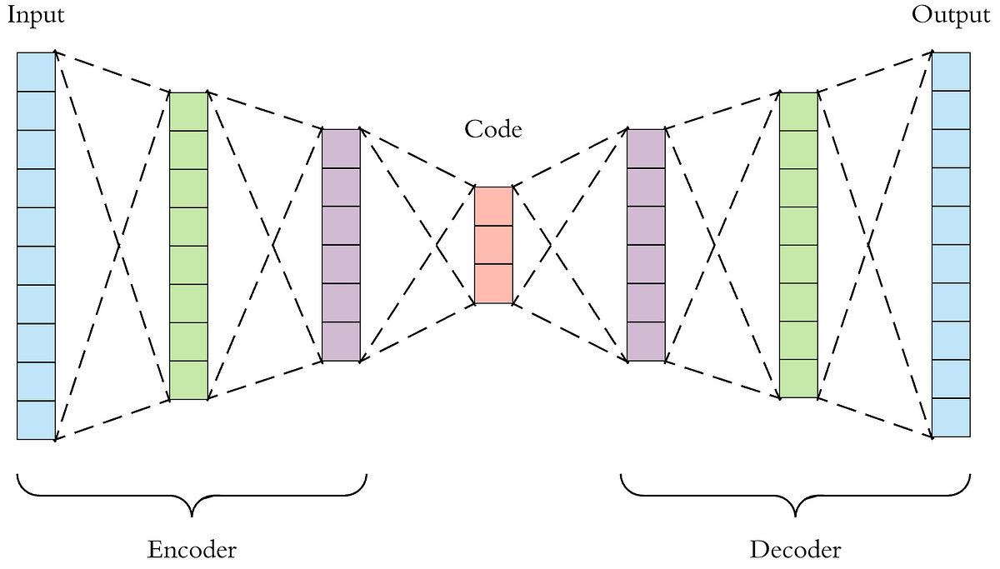





In [23]:
encoder = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=x_train.shape[1:]),  # Adjusted for CIFAR-10 shape
    tf.keras.layers.Conv2D(16, (3, 3), activation='relu', padding='same', strides=2),
    tf.keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same', strides=2)
])

decoder = tf.keras.Sequential([
    tf.keras.layers.Conv2DTranspose(8, kernel_size=3, strides=2, activation='relu', padding='same'),
    tf.keras.layers.Conv2DTranspose(16, kernel_size=3, strides=2, activation='relu', padding='same'),
    tf.keras.layers.Conv2D(3, kernel_size=(3, 3), activation='sigmoid', padding='same')  # Adjusted for 3 color channels
])
autoencoder = tf.keras.Sequential([encoder, decoder])
autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
history = autoencoder.fit(
    x_train, x_train, 
    epochs=10,
    batch_size=128,
    validation_split=0.1
)



Epoch 1/10
352/352 [==============================] - 6s 6ms/step - loss: -406185.7188 - val_loss: -2865811.5000
Epoch 2/10
352/352 [==============================] - 2s 5ms/step - loss: -42198716.0000 - val_loss: -136901136.0000
Epoch 3/10
352/352 [==============================] - 2s 5ms/step - loss: -501368512.0000 - val_loss: -1097098752.0000
Epoch 4/10
352/352 [==============================] - 2s 5ms/step - loss: -2485238016.0000 - val_loss: -4379674624.0000
Epoch 5/10
352/352 [==============================] - 2s 5ms/step - loss: -7859506176.0000 - val_loss: -12166355968.0000
Epoch 6/10
352/352 [==============================] - 2s 5ms/step - loss: -19165509632.0000 - val_loss: -27279532032.0000
Epoch 7/10
352/352 [==============================] - 2s 5ms/step - loss: -39455252480.0000 - val_loss: -52883804160.0000
Epoch 8/10
352/352 [==============================] - 2s 6ms/step - loss: -72171511808.0000 - val_loss: -92612919296.0000
Epoch 9/10
352/352 [========================

1563/1563 [==============================] - 3s 2ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

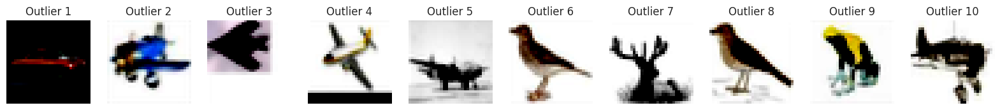

In [24]:
reconstructed = autoencoder.predict(x_train)
reconstruction_error = np.mean(np.power(x_train - reconstructed, 2), axis=(1,2,3))
threshold = np.quantile(reconstruction_error, 0.99)
outliers = x_train[reconstruction_error > threshold]

n = 10  
plt.figure(figsize=(20, 8))
for i in range(n):
    ax = plt.subplot(1, n, i + 1)
    plt.imshow(outliers[i])
    plt.axis('off')
    ax.set_title(f'Outlier {i+1}')
plt.show()
non_outliers_labels = y_train[reconstruction_error<=threshold]
non_outliers= x_train[reconstruction_error<=threshold]

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Outlier image seems to be mix with half clear and half unclear


</div>

In [26]:
def build_generator(latent_dim):
    model = Sequential()
    n_nodes = 128 * 8 * 8
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((8, 8, 128)))
    model.add(UpSampling2D())
    model.add(Conv2D(128, (3,3), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(UpSampling2D())
    model.add(Conv2D(3, (3,3), padding='same', activation='tanh'))
    return model


In [27]:
def build_discriminator(in_shape=(32, 32, 3)):
    model = Sequential()
    model.add(Conv2D(64, (3,3), strides=(2,2), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])
    return model

#### Creating Checkpoint

In [28]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='baselineDCGAN-3')]

#### Training

In [29]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

In [30]:
dataset = tf.data.Dataset.from_tensor_slices(non_outliers)
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [31]:
tf.keras.backend.clear_session()
K.clear_session()

Epoch 1/90
774/774 [==============================] - ETA: 0s - d_real_loss: 0.6023 - d_fake_loss: 0.6918 - g_loss: 0.8503 - d_acc: 0.5930 - d_realO: 0.4723 - d_fakeO: 0.5122

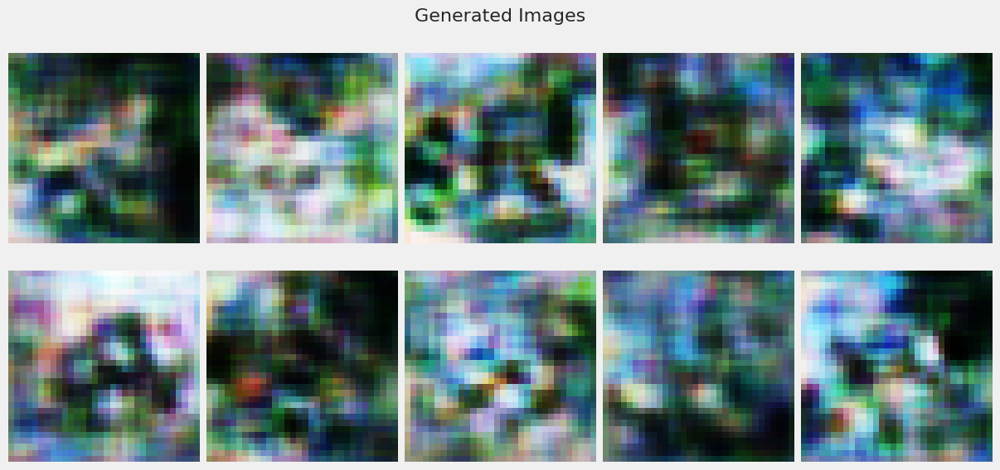

774/774 [==============================] - 11s 12ms/step - d_real_loss: 0.6024 - d_fake_loss: 0.6917 - g_loss: 0.8502 - d_acc: 0.5929 - d_realO: 0.4723 - d_fakeO: 0.5122
Epoch 2/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.7130 - d_fake_loss: 0.6831 - g_loss: 0.7247 - d_acc: 0.4669 - d_realO: 0.5037 - d_fakeO: 0.5032
Epoch 3/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6710 - d_fake_loss: 0.6849 - g_loss: 0.7514 - d_acc: 0.5816 - d_realO: 0.4759 - d_fakeO: 0.5167
Epoch 4/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6446 - d_fake_loss: 0.6595 - g_loss: 0.8156 - d_acc: 0.6108 - d_realO: 0.4661 - d_fakeO: 0.5255
Epoch 5/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6791 - d_fake_loss: 0.6579 - g_loss: 0.8051 - d_acc: 0.5756 - d_realO: 0.4869 - d_fakeO: 0.5162
Epoch 6/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6708 - d_fake_loss: 0.6786

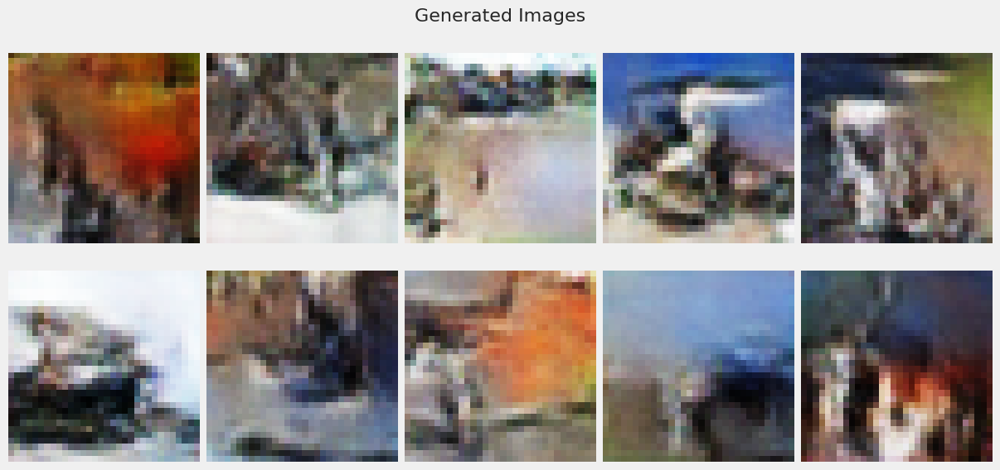

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.7013 - d_fake_loss: 0.6921 - g_loss: 0.7387 - d_acc: 0.4880 - d_realO: 0.4999 - d_fakeO: 0.5032
Epoch 12/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6943 - d_fake_loss: 0.6886 - g_loss: 0.7519 - d_acc: 0.5123 - d_realO: 0.4971 - d_fakeO: 0.5047
Epoch 13/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6969 - d_fake_loss: 0.6853 - g_loss: 0.7499 - d_acc: 0.5156 - d_realO: 0.4981 - d_fakeO: 0.5054
Epoch 14/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6947 - d_fake_loss: 0.6896 - g_loss: 0.7429 - d_acc: 0.5066 - d_realO: 0.4974 - d_fakeO: 0.5044
Epoch 15/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6962 - d_fake_loss: 0.6849 - g_loss: 0.7469 - d_acc: 0.5222 - d_realO: 0.4975 - d_fakeO: 0.5056
Epoch 16/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6921 - d_fake_loss: 0.

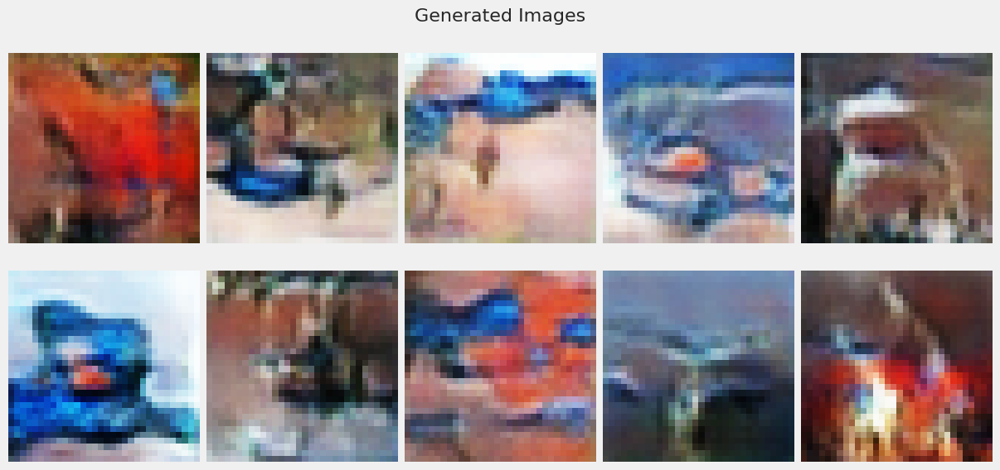

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6966 - d_fake_loss: 0.6906 - g_loss: 0.7315 - d_acc: 0.4987 - d_realO: 0.4992 - d_fakeO: 0.5023
Epoch 22/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6961 - d_fake_loss: 0.6906 - g_loss: 0.7330 - d_acc: 0.4977 - d_realO: 0.4994 - d_fakeO: 0.5022
Epoch 23/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6959 - d_fake_loss: 0.6906 - g_loss: 0.7312 - d_acc: 0.4980 - d_realO: 0.4998 - d_fakeO: 0.5021
Epoch 24/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6948 - d_fake_loss: 0.6916 - g_loss: 0.7308 - d_acc: 0.4993 - d_realO: 0.4992 - d_fakeO: 0.5022
Epoch 25/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6960 - d_fake_loss: 0.6907 - g_loss: 0.7289 - d_acc: 0.4987 - d_realO: 0.4995 - d_fakeO: 0.5021
Epoch 26/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6957 - d_fake_loss: 0.

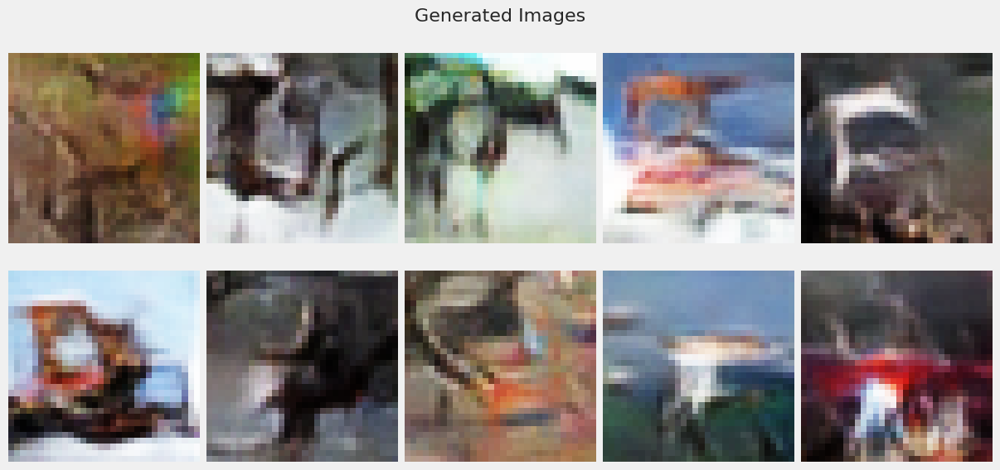

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6932 - d_fake_loss: 0.6929 - g_loss: 0.7329 - d_acc: 0.5027 - d_realO: 0.4989 - d_fakeO: 0.5022
Epoch 32/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6939 - d_fake_loss: 0.6910 - g_loss: 0.7253 - d_acc: 0.5013 - d_realO: 0.4989 - d_fakeO: 0.5023
Epoch 33/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6937 - d_fake_loss: 0.6906 - g_loss: 0.7246 - d_acc: 0.5008 - d_realO: 0.4991 - d_fakeO: 0.5024
Epoch 34/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6931 - d_fake_loss: 0.6917 - g_loss: 0.7281 - d_acc: 0.5049 - d_realO: 0.4987 - d_fakeO: 0.5021
Epoch 35/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6934 - d_fake_loss: 0.6900 - g_loss: 0.7313 - d_acc: 0.5078 - d_realO: 0.4990 - d_fakeO: 0.5027
Epoch 36/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6933 - d_fake_loss: 0.

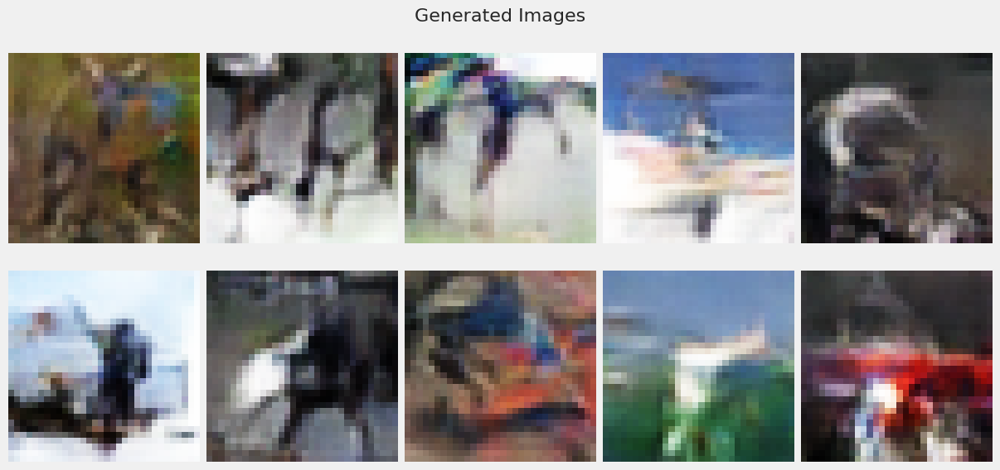

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6927 - d_fake_loss: 0.6900 - g_loss: 0.7248 - d_acc: 0.5103 - d_realO: 0.4985 - d_fakeO: 0.5024
Epoch 42/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6937 - d_fake_loss: 0.6895 - g_loss: 0.7325 - d_acc: 0.5102 - d_realO: 0.4984 - d_fakeO: 0.5030
Epoch 43/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6937 - d_fake_loss: 0.6894 - g_loss: 0.7266 - d_acc: 0.5089 - d_realO: 0.4984 - d_fakeO: 0.5025
Epoch 44/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6946 - d_fake_loss: 0.6894 - g_loss: 0.7246 - d_acc: 0.5034 - d_realO: 0.4990 - d_fakeO: 0.5026
Epoch 45/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.6902 - g_loss: 0.7267 - d_acc: 0.5096 - d_realO: 0.4985 - d_fakeO: 0.5024
Epoch 46/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6933 - d_fake_loss: 0.

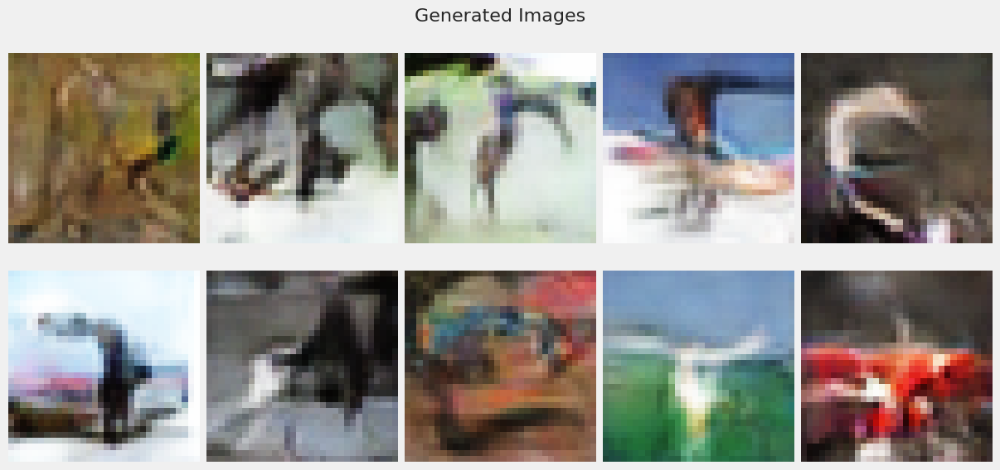

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6930 - d_fake_loss: 0.6906 - g_loss: 0.7284 - d_acc: 0.5096 - d_realO: 0.4987 - d_fakeO: 0.5024
Epoch 52/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6933 - d_fake_loss: 0.6906 - g_loss: 0.7269 - d_acc: 0.5044 - d_realO: 0.4986 - d_fakeO: 0.5022
Epoch 53/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6925 - d_fake_loss: 0.6917 - g_loss: 0.7297 - d_acc: 0.5064 - d_realO: 0.4985 - d_fakeO: 0.5025
Epoch 54/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6923 - d_fake_loss: 0.6904 - g_loss: 0.7276 - d_acc: 0.5093 - d_realO: 0.4985 - d_fakeO: 0.5025
Epoch 55/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6922 - d_fake_loss: 0.6903 - g_loss: 0.7283 - d_acc: 0.5097 - d_realO: 0.4981 - d_fakeO: 0.5024
Epoch 56/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6924 - d_fake_loss: 0.

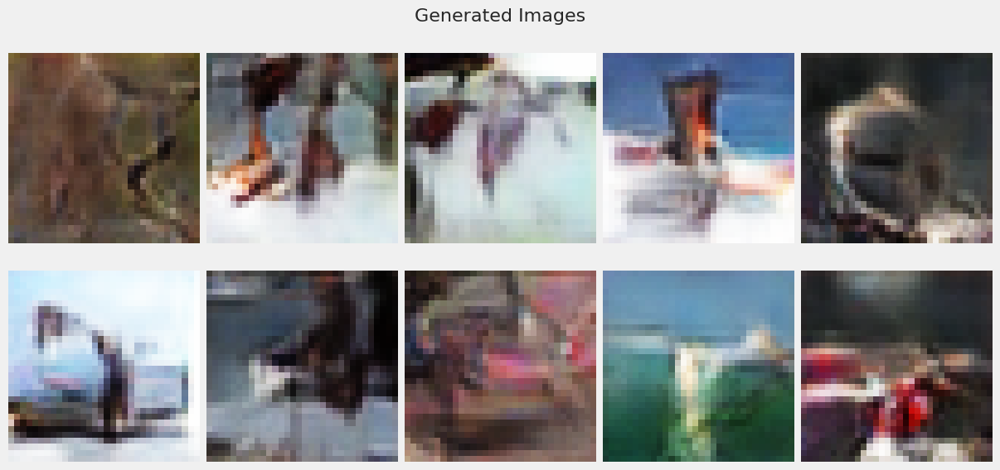

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6913 - d_fake_loss: 0.6894 - g_loss: 0.7275 - d_acc: 0.5139 - d_realO: 0.4980 - d_fakeO: 0.5030
Epoch 62/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6915 - d_fake_loss: 0.6906 - g_loss: 0.7289 - d_acc: 0.5102 - d_realO: 0.4980 - d_fakeO: 0.5029
Epoch 63/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6915 - d_fake_loss: 0.6886 - g_loss: 0.7303 - d_acc: 0.5163 - d_realO: 0.4979 - d_fakeO: 0.5033
Epoch 64/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6909 - d_fake_loss: 0.6884 - g_loss: 0.7331 - d_acc: 0.5187 - d_realO: 0.4976 - d_fakeO: 0.5033
Epoch 65/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6907 - d_fake_loss: 0.6895 - g_loss: 0.7353 - d_acc: 0.5217 - d_realO: 0.4976 - d_fakeO: 0.5033
Epoch 66/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6904 - d_fake_loss: 0.

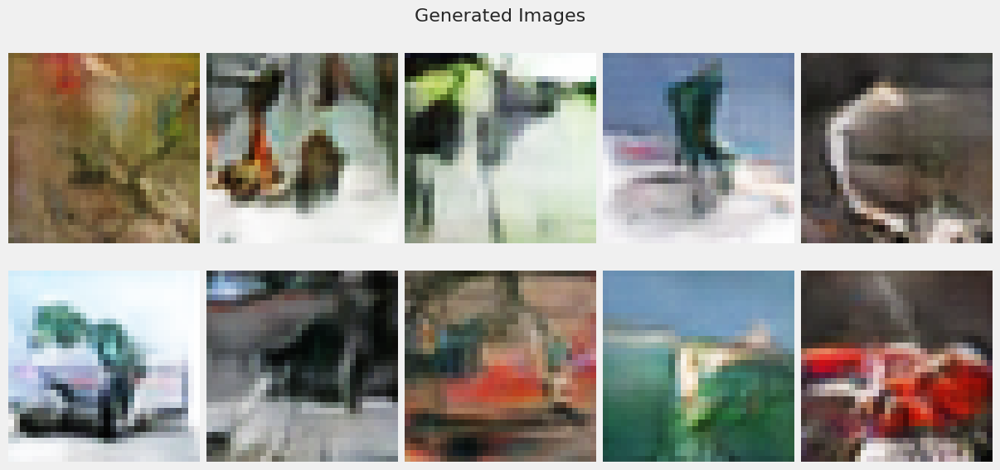

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6904 - d_fake_loss: 0.6878 - g_loss: 0.7362 - d_acc: 0.5211 - d_realO: 0.4970 - d_fakeO: 0.5038
Epoch 72/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6905 - d_fake_loss: 0.6869 - g_loss: 0.7365 - d_acc: 0.5250 - d_realO: 0.4969 - d_fakeO: 0.5043
Epoch 73/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6899 - d_fake_loss: 0.6872 - g_loss: 0.7372 - d_acc: 0.5232 - d_realO: 0.4969 - d_fakeO: 0.5042
Epoch 74/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6898 - d_fake_loss: 0.6876 - g_loss: 0.7394 - d_acc: 0.5249 - d_realO: 0.4965 - d_fakeO: 0.5044
Epoch 75/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6902 - d_fake_loss: 0.6870 - g_loss: 0.7401 - d_acc: 0.5260 - d_realO: 0.4966 - d_fakeO: 0.5046
Epoch 76/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6900 - d_fake_loss: 0.

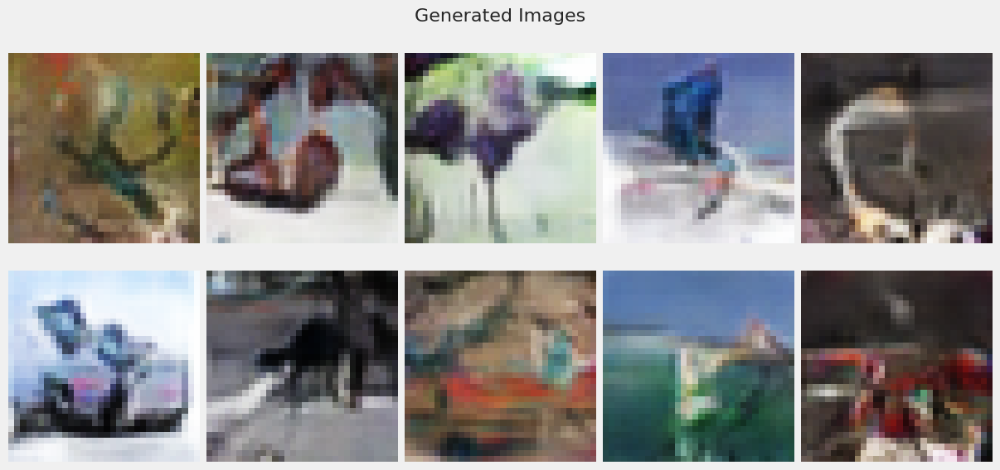

774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6893 - d_fake_loss: 0.6864 - g_loss: 0.7394 - d_acc: 0.5258 - d_realO: 0.4961 - d_fakeO: 0.5046
Epoch 82/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6892 - d_fake_loss: 0.6869 - g_loss: 0.7468 - d_acc: 0.5285 - d_realO: 0.4961 - d_fakeO: 0.5049
Epoch 83/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6895 - d_fake_loss: 0.6865 - g_loss: 0.7439 - d_acc: 0.5280 - d_realO: 0.4959 - d_fakeO: 0.5051
Epoch 84/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6885 - d_fake_loss: 0.6869 - g_loss: 0.7467 - d_acc: 0.5286 - d_realO: 0.4955 - d_fakeO: 0.5051
Epoch 85/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6889 - d_fake_loss: 0.6857 - g_loss: 0.7423 - d_acc: 0.5298 - d_realO: 0.4956 - d_fakeO: 0.5054
Epoch 86/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6887 - d_fake_loss: 0.

In [32]:
gan_3 = train_gan(discriminator_dcgan3, generator_dcgan3, noise, 'Non-Outlier DCGAN 3', dataset, 90, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  52% accuracy 
- No Model Collapse


</div>

87910968/87910968 [==============================] - 6s 0us/step


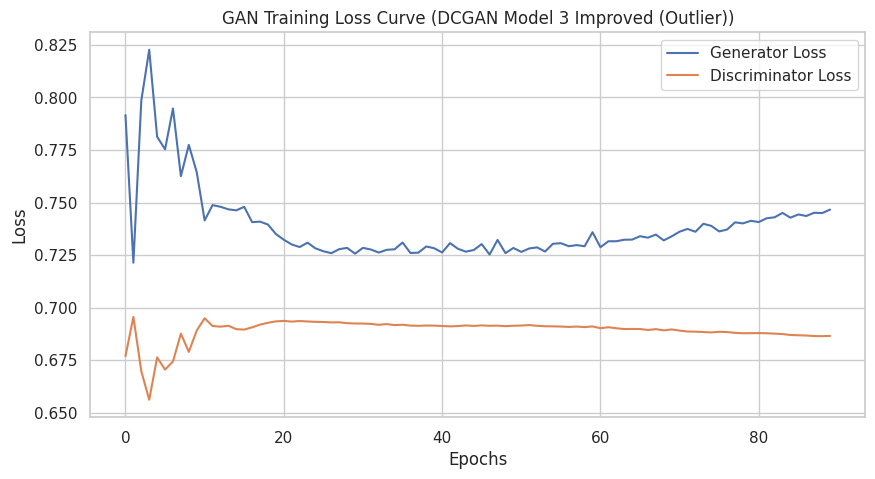

In [33]:
gan_history_3 = gan_3[0].history
generator = gan_3[1].generator  
gan_history_3['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_3['d_real_loss'], gan_history_3['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_3, title='GAN Training Loss Curve (DCGAN Model 3 Improved (Outlier))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively high and drops quickly and then to increase steadily as the epochs increases
- Generator loss
    - For the generator loss, it remains around the same with minor drop at the start


</div>

In [34]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 2ms/step
FID Score: 46.075019206367315
KID Score: 0.029453184378054775


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 46 
- KID Score is 0.03
    
Around the same as baseline results

</div>

2/2 [==============================] - 2s 203ms/step


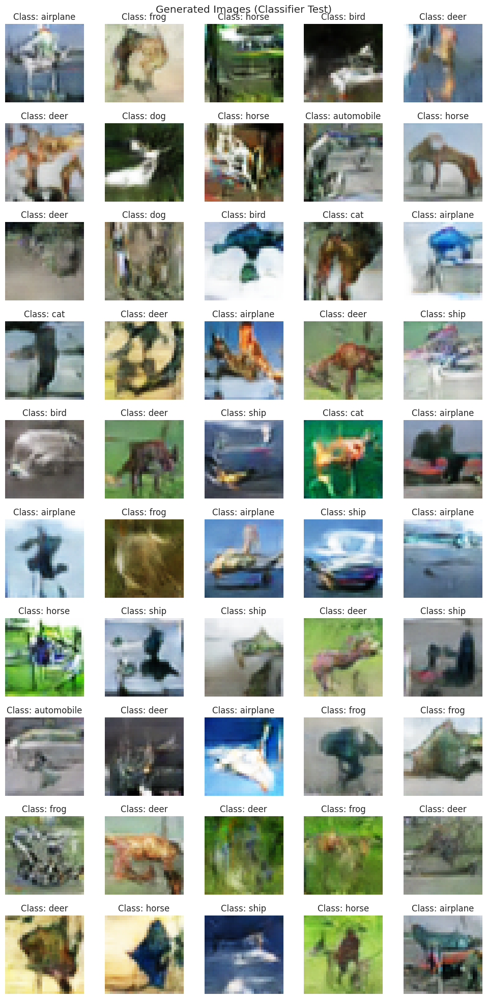

In [35]:
latent_dim = 128  
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Generally, the images only some can be seen like what it suppose to be

</div>

4/4 [==============================] - 0s 5ms/step


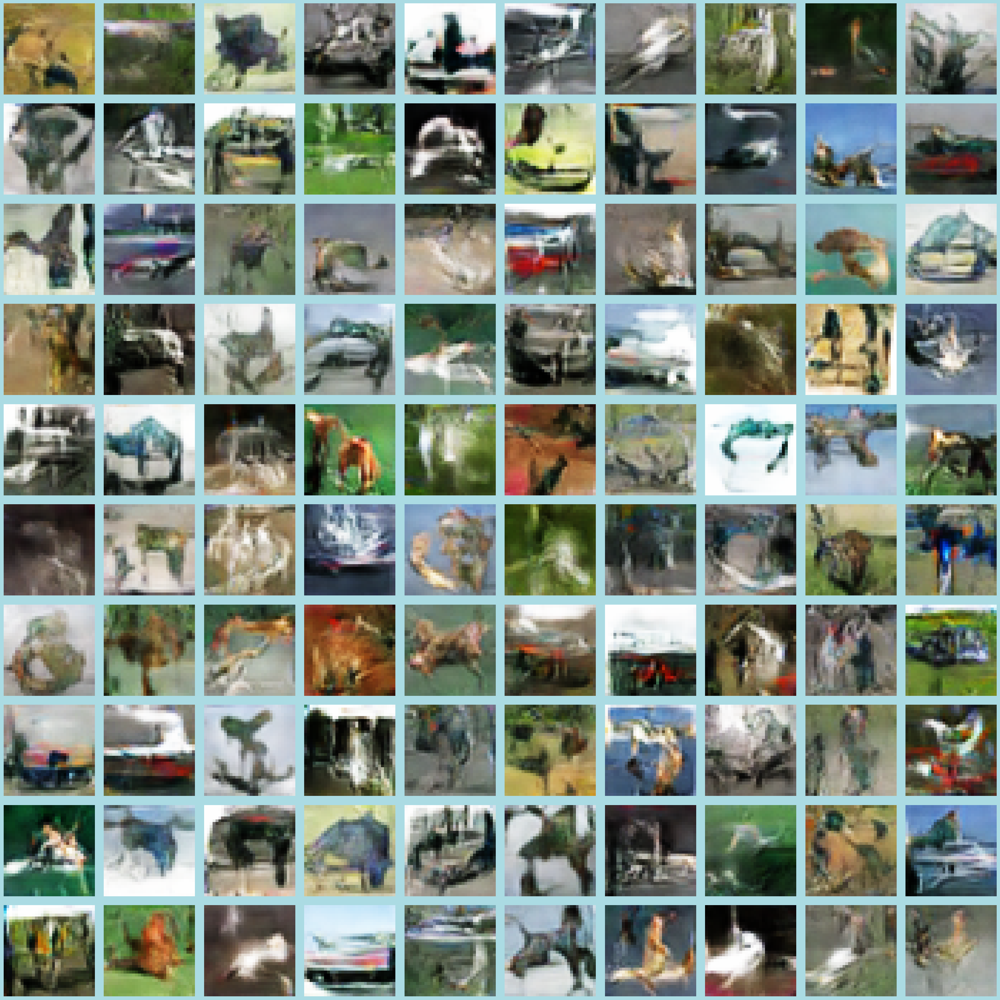

4/4 [==============================] - 0s 2ms/step


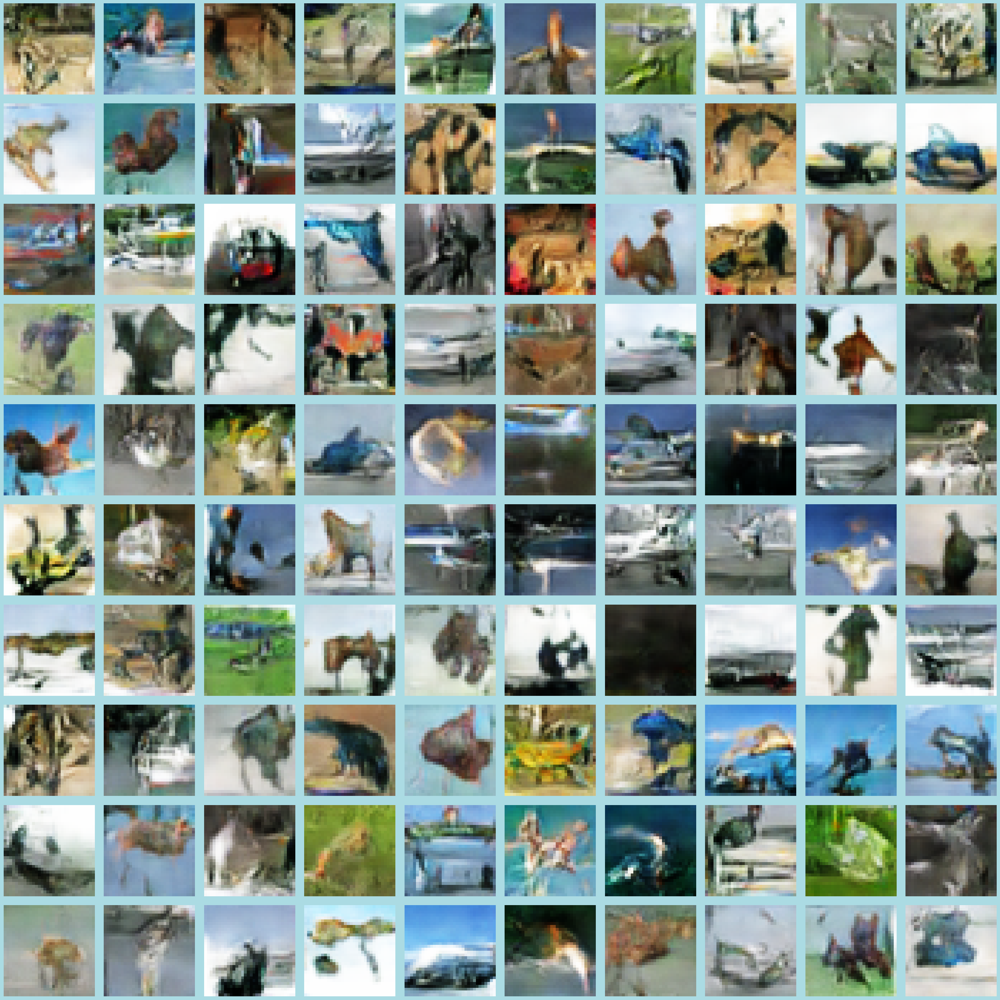

4/4 [==============================] - 0s 3ms/step


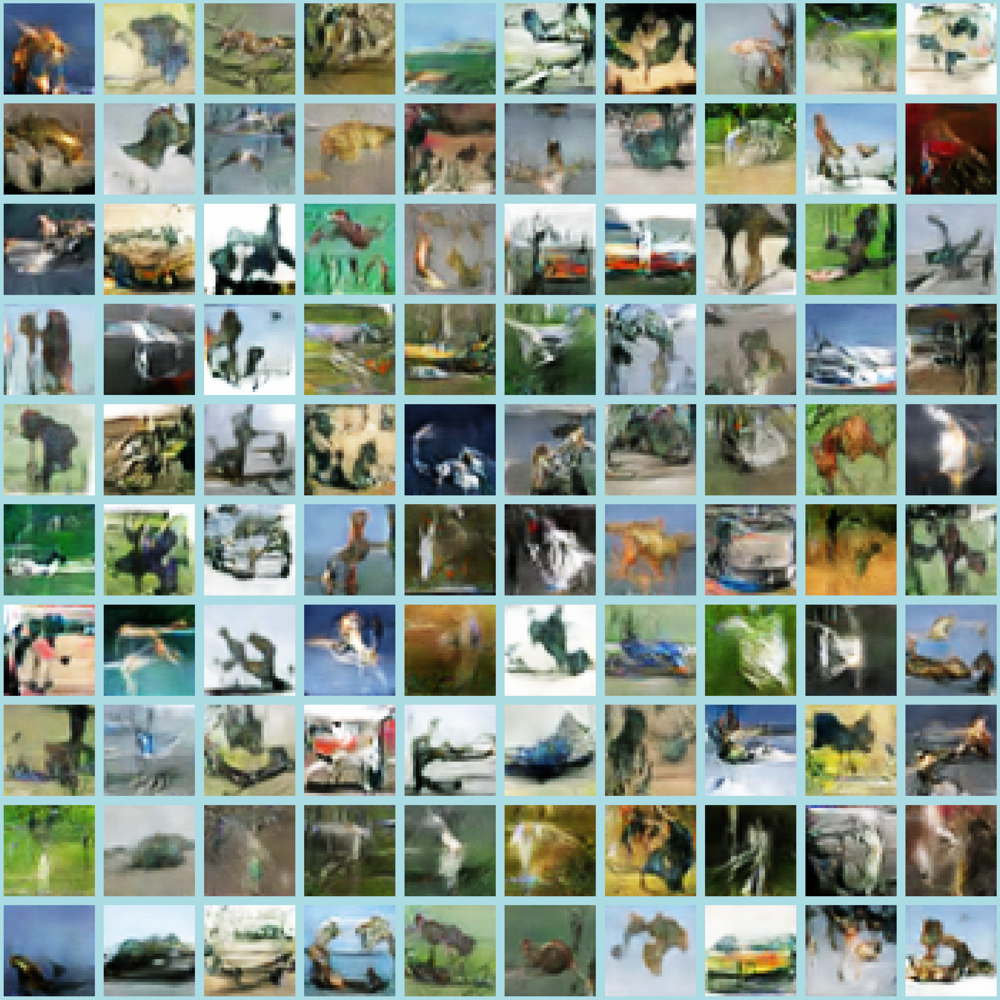

4/4 [==============================] - 0s 2ms/step


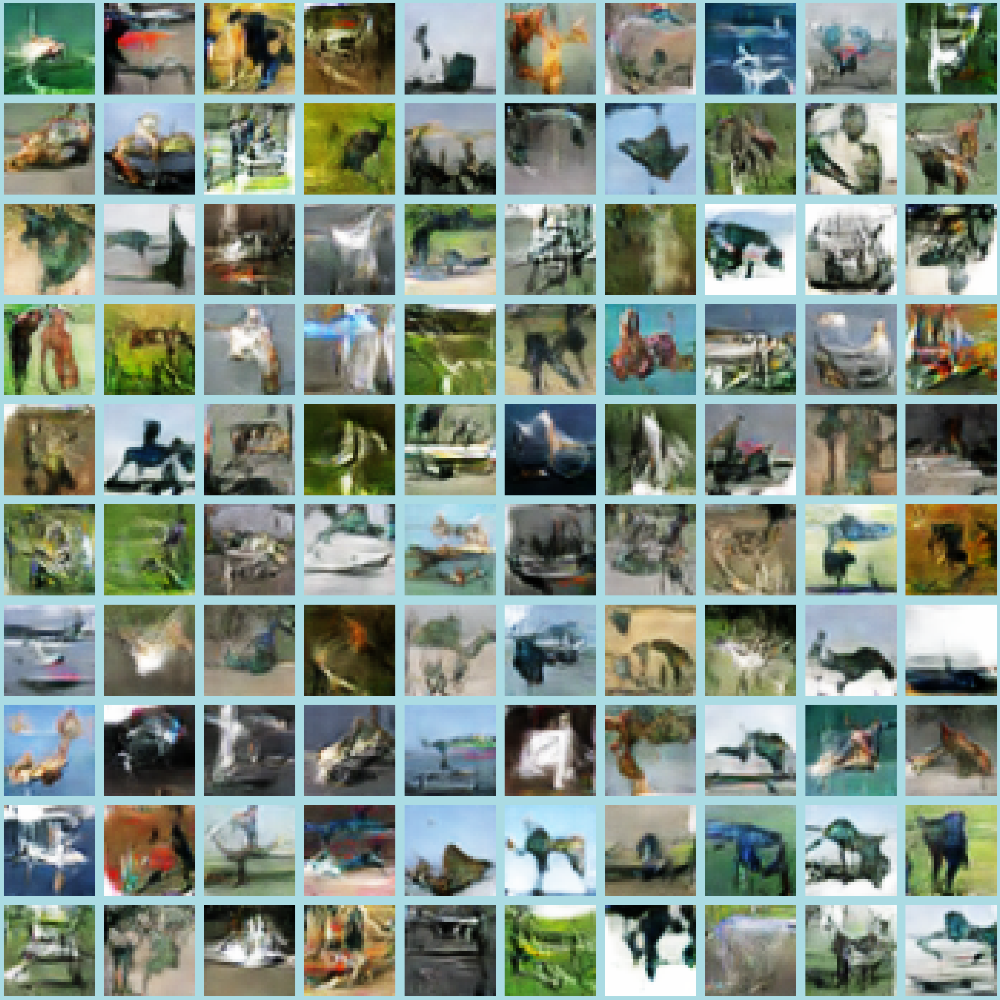

4/4 [==============================] - 0s 3ms/step


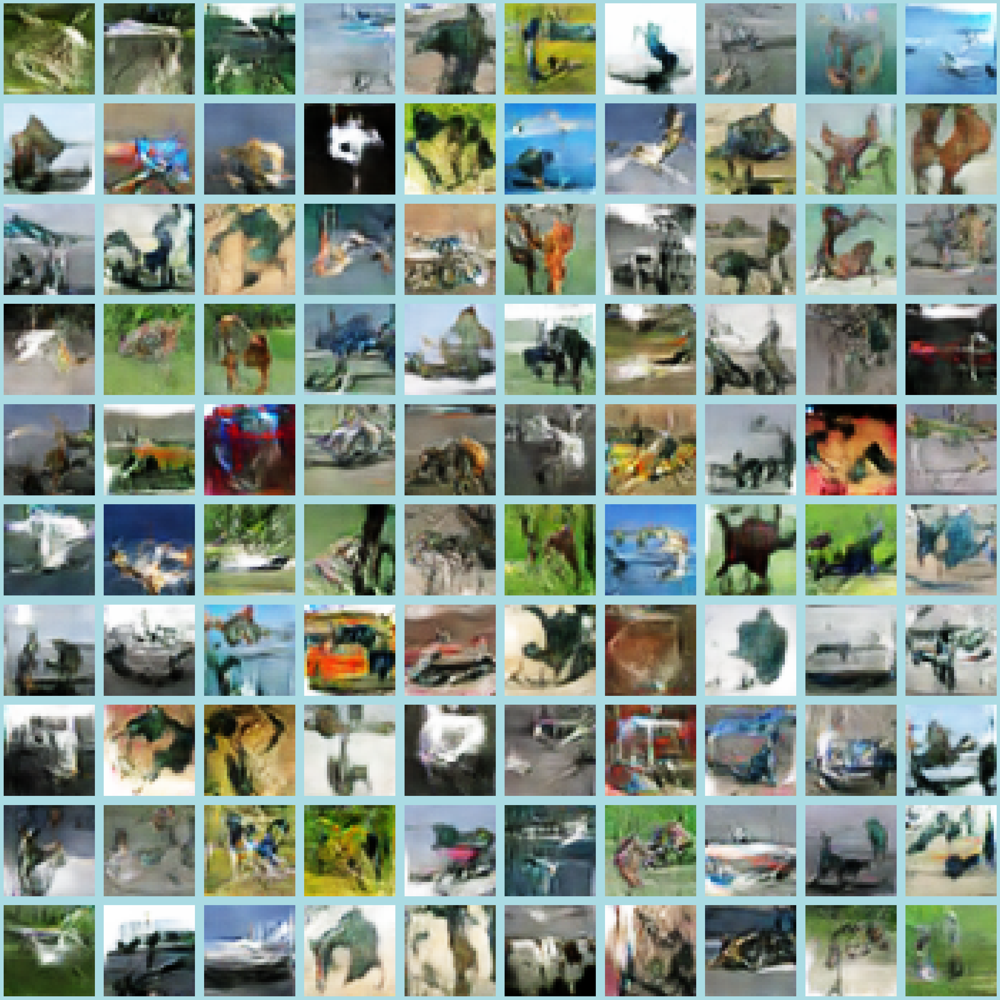

4/4 [==============================] - 0s 3ms/step


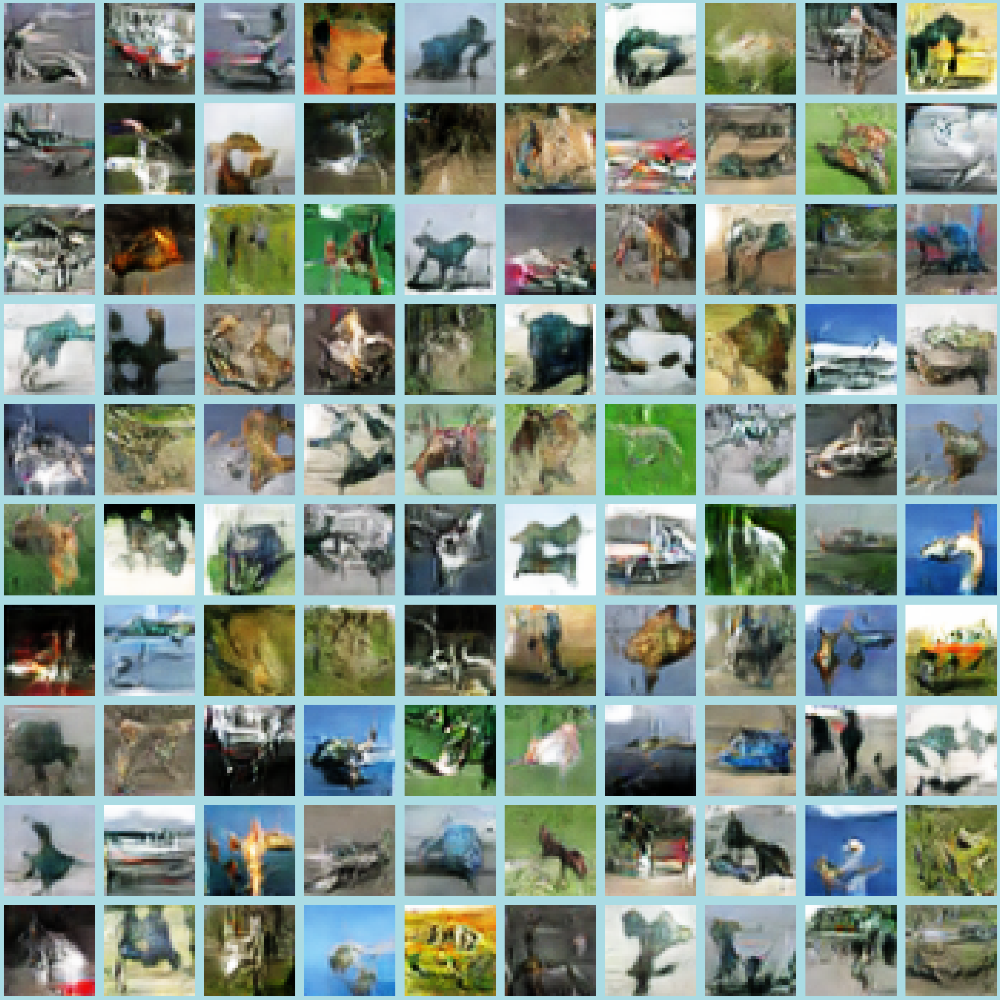

4/4 [==============================] - 0s 3ms/step


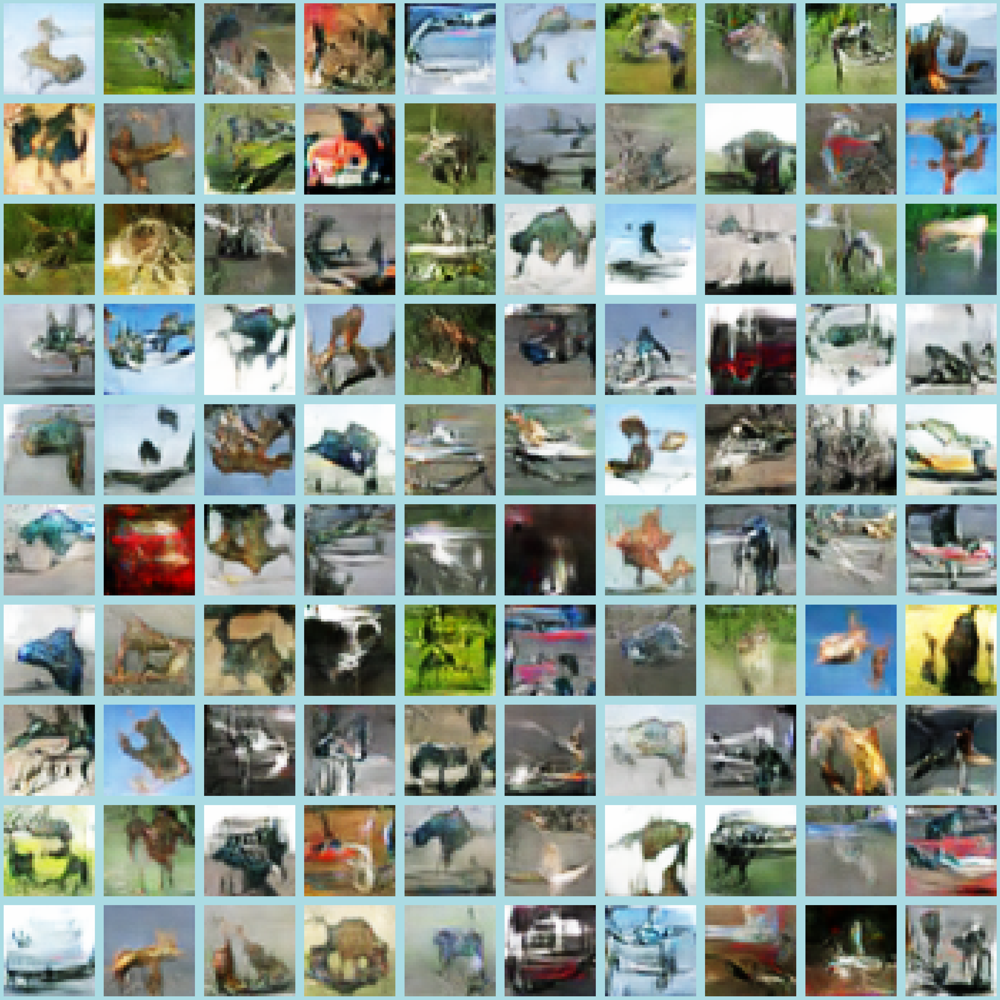

4/4 [==============================] - 0s 3ms/step


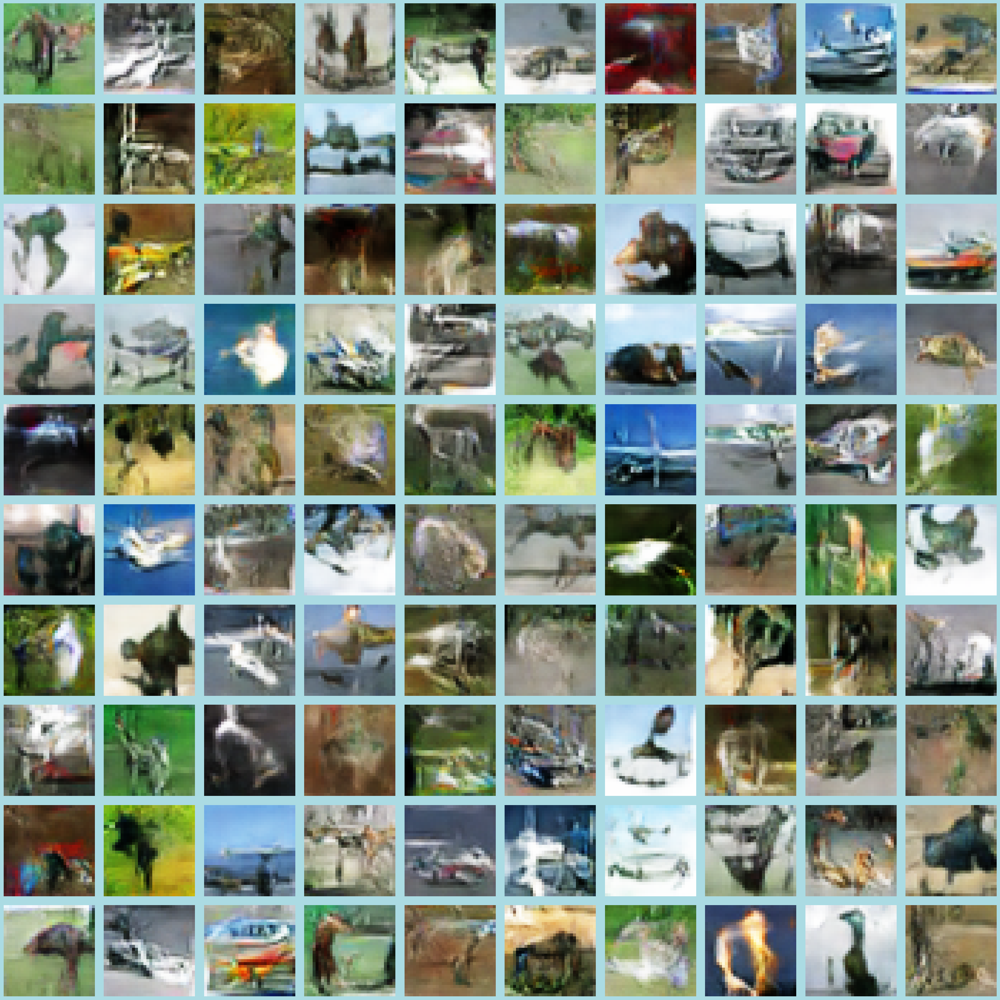

4/4 [==============================] - 0s 2ms/step


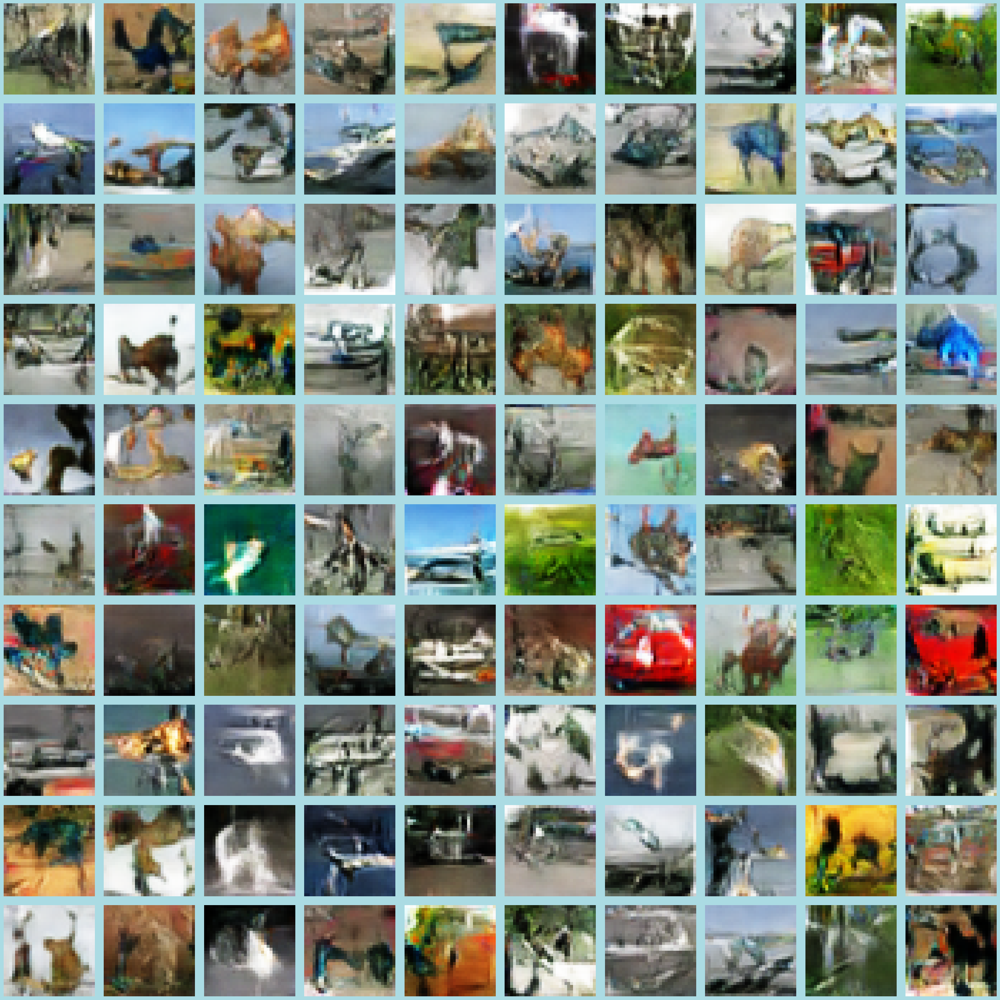

4/4 [==============================] - 0s 2ms/step


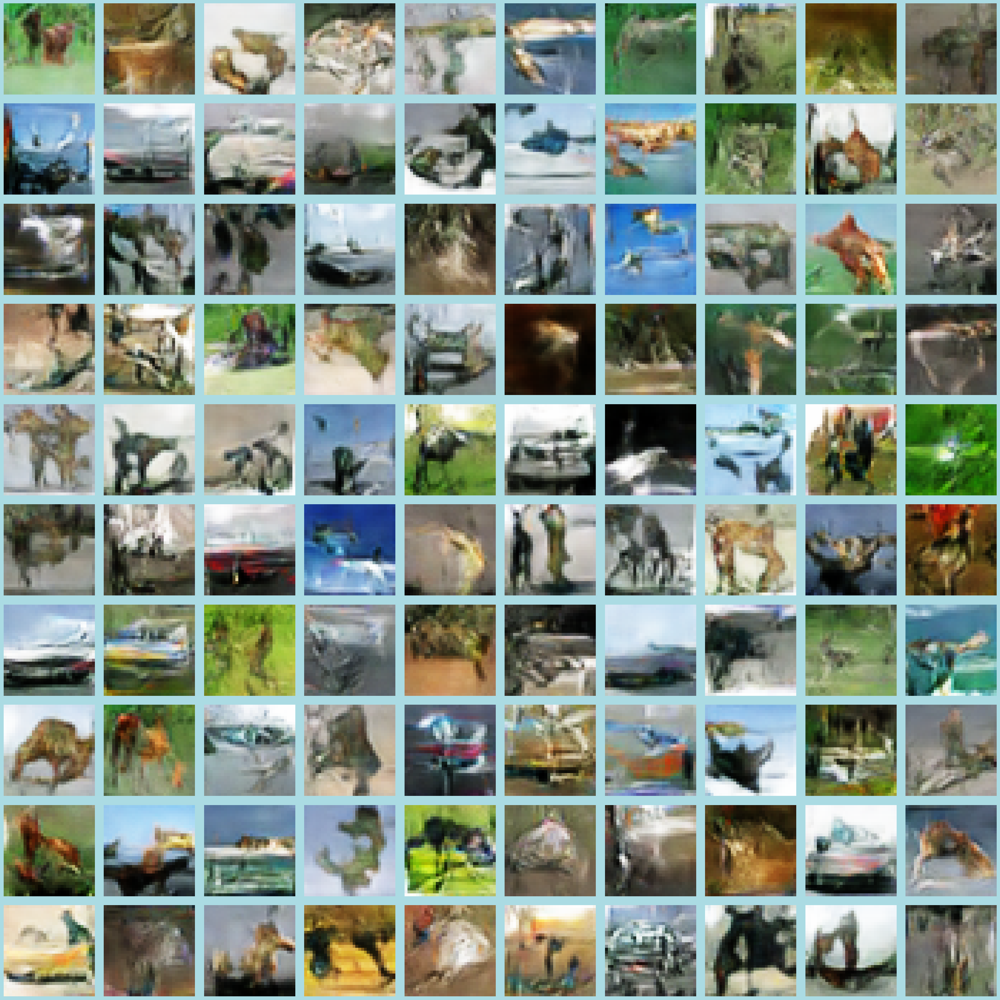

In [36]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [37]:
new_row = {'Model':'Non-Outlier DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_3['d_loss'][-1], 'g_loss':gan_history_3['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,0.029453,0.686637,0.746695


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering (Sharpened Image))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">

### 

## __Key Ideas__

1. Sharpening images in GANs is a post-processing step aimed at enhancing the clarity and detail of generated images, often addressing common issues like blurriness or lack of texture definition
2. This technique involves applying image processing filters, such as unsharp masking or high-pass filters, to emphasize edges and fine details, making the generated images more realistic and visually appealing
3. Image sharpening can be particularly beneficial in applications where GANs are used for super-resolution tasks, converting low-resolution images to high-resolution counterparts while maintaining high-quality details
4. Incorporating sharpening techniques into GAN frameworks can also aid in improving the perceptual quality of generated images, making them more convincing to the human eye and useful for practical applications

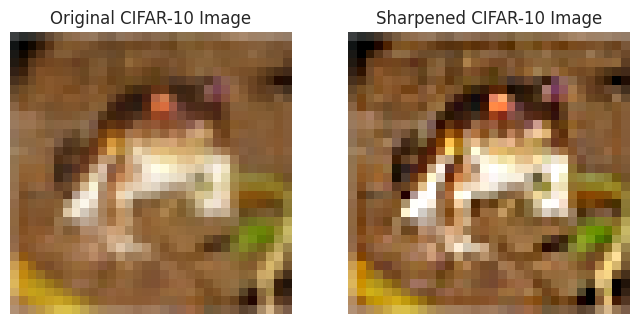

In [38]:
(x_train, _), (_, _) = tf.keras.datasets.cifar10.load_data()

image_index = 0
cifar_image = x_train[image_index]
pil_image = Image.fromarray(cifar_image)
sharpened_image = pil_image.filter(ImageFilter.SHARPEN)

plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
plt.title('Original CIFAR-10 Image')
plt.imshow(pil_image)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Sharpened CIFAR-10 Image')
plt.imshow(sharpened_image)
plt.axis('off')

plt.show()


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Image are sharpened even clearer here


</div>

In [39]:
def sharpen_images(batch):
    sharpened_batch = np.array([np.array(Image.fromarray(img).filter(ImageFilter.SHARPEN)) for img in batch])
    return sharpened_batch

#### Creating Checkpoint

In [40]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='Sharpened Image DCGAN3')]

#### Training

In [41]:
x_train_sharpened = sharpen_images(x_train)

In [42]:
dataset_s = tf.data.Dataset.from_tensor_slices(x_train_sharpened)
dataset_s = dataset_s.shuffle(buffer_size=sizeOfBuffer).batch(batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [43]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

Epoch 1/90
770/774 [============================>.] - ETA: 0s - d_real_loss: 0.6028 - d_fake_loss: 0.7174 - g_loss: 0.8249 - d_acc: 0.5588 - d_realO: 0.4746 - d_fakeO: 0.5066

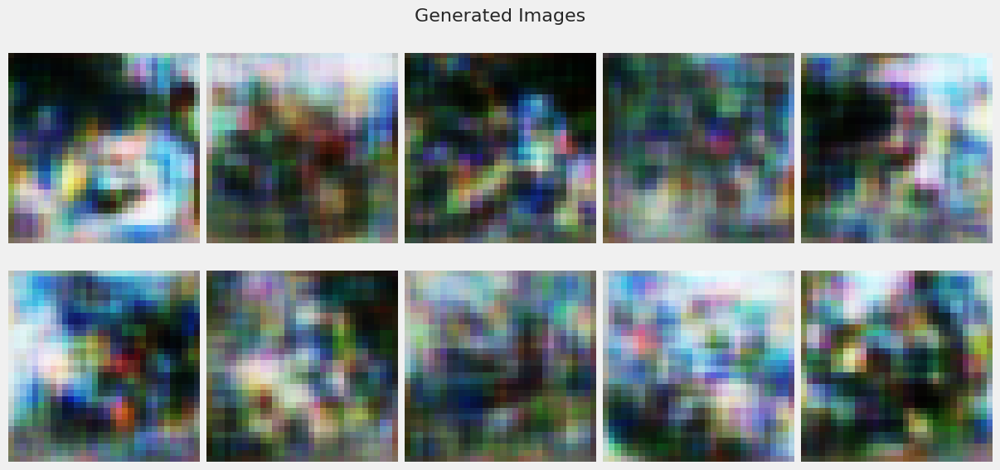

774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6032 - d_fake_loss: 0.7172 - g_loss: 0.8246 - d_acc: 0.5585 - d_realO: 0.4750 - d_fakeO: 0.5067
Epoch 2/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.7133 - d_fake_loss: 0.6821 - g_loss: 0.7266 - d_acc: 0.4781 - d_realO: 0.5064 - d_fakeO: 0.5047
Epoch 3/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6860 - d_fake_loss: 0.6764 - g_loss: 0.7477 - d_acc: 0.5622 - d_realO: 0.4816 - d_fakeO: 0.5135
Epoch 4/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6617 - d_fake_loss: 0.6685 - g_loss: 0.8119 - d_acc: 0.5772 - d_realO: 0.4756 - d_fakeO: 0.5248
Epoch 5/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6624 - d_fake_loss: 0.6688 - g_loss: 0.7998 - d_acc: 0.5903 - d_realO: 0.4776 - d_fakeO: 0.5192
Epoch 6/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6698 - d_fake_loss: 0.6800

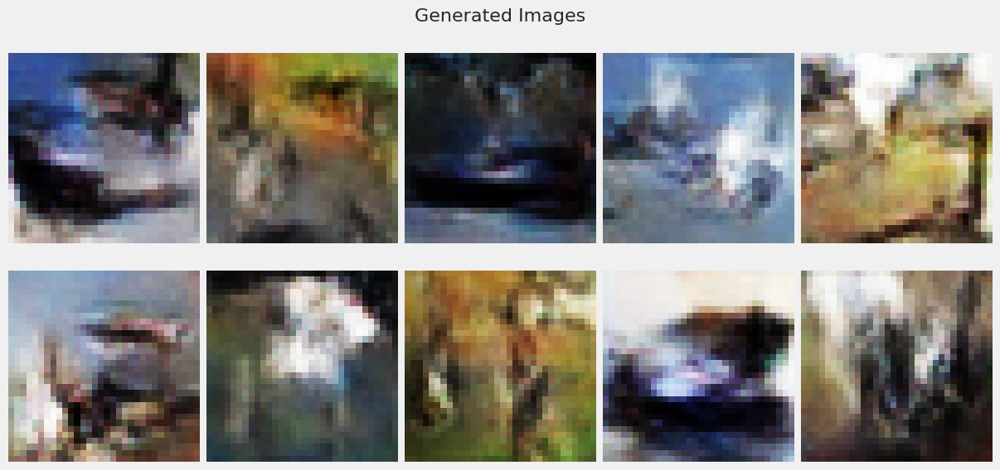

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6974 - d_fake_loss: 0.6842 - g_loss: 0.7511 - d_acc: 0.5145 - d_realO: 0.4983 - d_fakeO: 0.5058
Epoch 12/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6952 - d_fake_loss: 0.6859 - g_loss: 0.7517 - d_acc: 0.5212 - d_realO: 0.4974 - d_fakeO: 0.5061
Epoch 13/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6959 - d_fake_loss: 0.6862 - g_loss: 0.7515 - d_acc: 0.5165 - d_realO: 0.4976 - d_fakeO: 0.5054
Epoch 14/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6955 - d_fake_loss: 0.6869 - g_loss: 0.7463 - d_acc: 0.5137 - d_realO: 0.4978 - d_fakeO: 0.5051
Epoch 15/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6940 - d_fake_loss: 0.6872 - g_loss: 0.7431 - d_acc: 0.5183 - d_realO: 0.4988 - d_fakeO: 0.5043
Epoch 16/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6947 - d_fake_loss: 0.

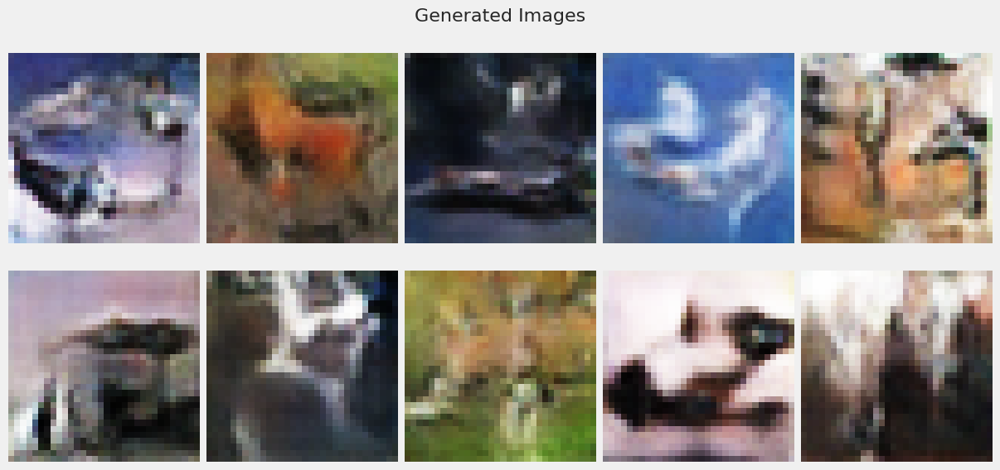

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6950 - d_fake_loss: 0.6894 - g_loss: 0.7356 - d_acc: 0.5015 - d_realO: 0.4983 - d_fakeO: 0.5034
Epoch 22/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6942 - d_fake_loss: 0.6897 - g_loss: 0.7315 - d_acc: 0.5060 - d_realO: 0.4993 - d_fakeO: 0.5033
Epoch 23/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6939 - d_fake_loss: 0.6899 - g_loss: 0.7362 - d_acc: 0.5112 - d_realO: 0.4983 - d_fakeO: 0.5034
Epoch 24/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6915 - d_fake_loss: 0.6925 - g_loss: 0.7456 - d_acc: 0.5096 - d_realO: 0.4979 - d_fakeO: 0.5033
Epoch 25/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6942 - d_fake_loss: 0.6901 - g_loss: 0.7341 - d_acc: 0.5041 - d_realO: 0.4992 - d_fakeO: 0.5029
Epoch 26/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6944 - d_fake_loss: 0.

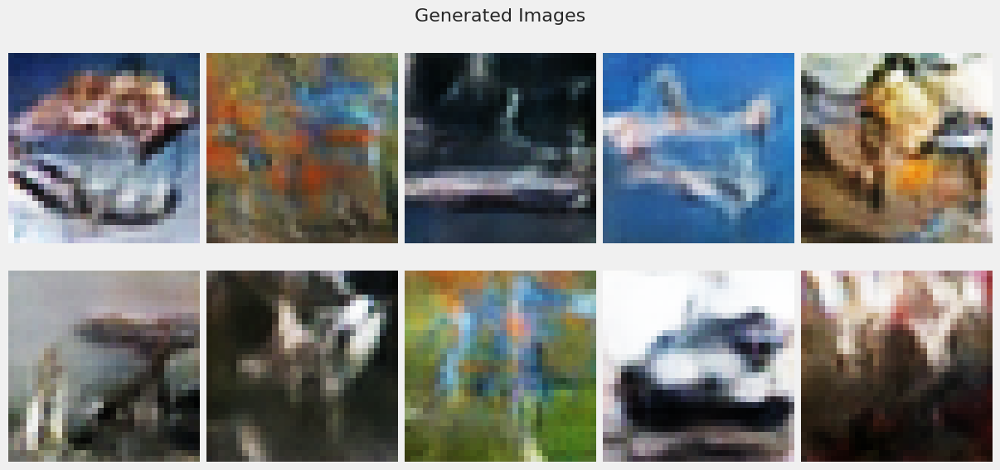

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6949 - d_fake_loss: 0.6915 - g_loss: 0.7233 - d_acc: 0.4957 - d_realO: 0.4995 - d_fakeO: 0.5019
Epoch 32/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6953 - d_fake_loss: 0.6911 - g_loss: 0.7249 - d_acc: 0.4958 - d_realO: 0.4997 - d_fakeO: 0.5020
Epoch 33/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6938 - d_fake_loss: 0.6911 - g_loss: 0.7252 - d_acc: 0.5030 - d_realO: 0.4993 - d_fakeO: 0.5021
Epoch 34/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6947 - d_fake_loss: 0.6911 - g_loss: 0.7250 - d_acc: 0.5010 - d_realO: 0.4996 - d_fakeO: 0.5020
Epoch 35/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6944 - d_fake_loss: 0.6904 - g_loss: 0.7259 - d_acc: 0.5025 - d_realO: 0.4996 - d_fakeO: 0.5020
Epoch 36/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6945 - d_fake_loss: 0.

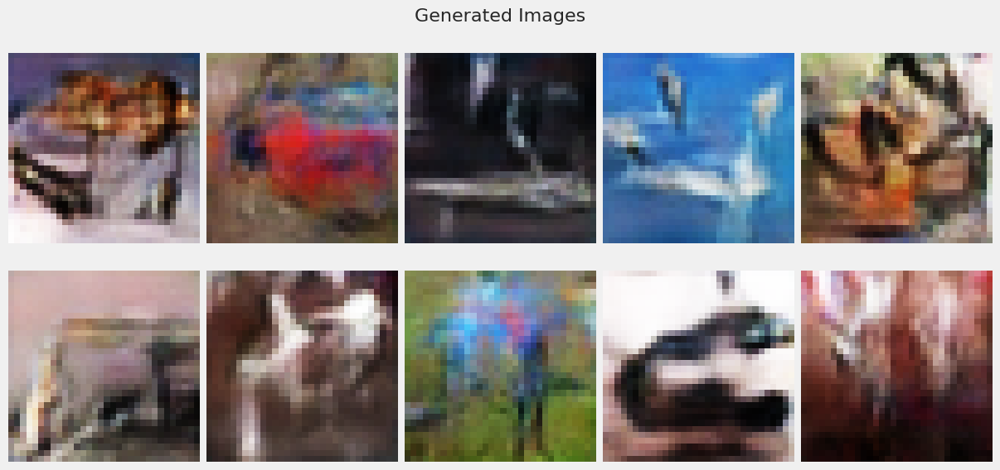

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6961 - d_fake_loss: 0.6877 - g_loss: 0.7309 - d_acc: 0.5103 - d_realO: 0.4995 - d_fakeO: 0.5025
Epoch 42/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6927 - d_fake_loss: 0.6907 - g_loss: 0.7257 - d_acc: 0.5065 - d_realO: 0.4988 - d_fakeO: 0.5022
Epoch 43/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6939 - d_fake_loss: 0.6894 - g_loss: 0.7263 - d_acc: 0.5083 - d_realO: 0.4988 - d_fakeO: 0.5023
Epoch 44/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6942 - d_fake_loss: 0.6888 - g_loss: 0.7258 - d_acc: 0.5096 - d_realO: 0.4990 - d_fakeO: 0.5025
Epoch 45/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6936 - d_fake_loss: 0.6895 - g_loss: 0.7272 - d_acc: 0.5068 - d_realO: 0.4989 - d_fakeO: 0.5026
Epoch 46/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.

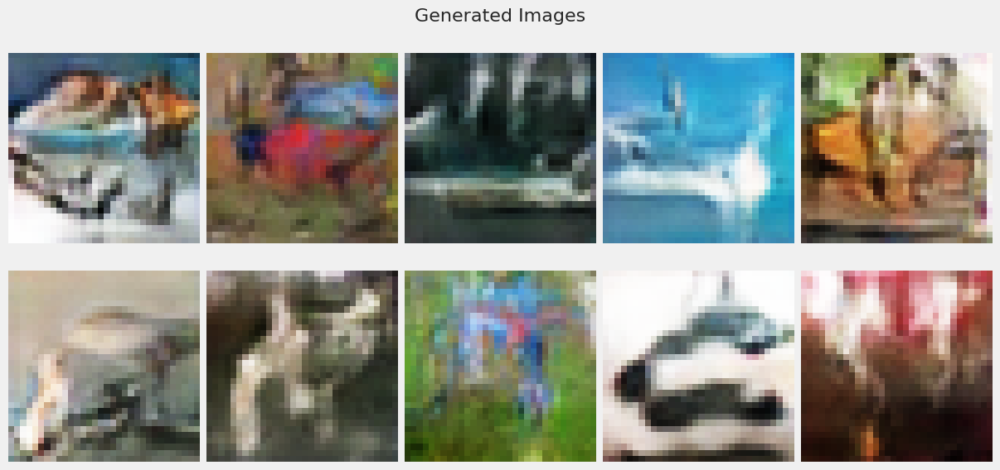

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6926 - d_fake_loss: 0.6903 - g_loss: 0.7253 - d_acc: 0.5049 - d_realO: 0.4987 - d_fakeO: 0.5025
Epoch 52/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6922 - d_fake_loss: 0.6905 - g_loss: 0.7272 - d_acc: 0.5079 - d_realO: 0.4985 - d_fakeO: 0.5024
Epoch 53/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6928 - d_fake_loss: 0.6898 - g_loss: 0.7262 - d_acc: 0.5110 - d_realO: 0.4982 - d_fakeO: 0.5026
Epoch 54/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6938 - d_fake_loss: 0.6909 - g_loss: 0.7316 - d_acc: 0.5073 - d_realO: 0.4986 - d_fakeO: 0.5029
Epoch 55/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6918 - d_fake_loss: 0.6899 - g_loss: 0.7285 - d_acc: 0.5110 - d_realO: 0.4983 - d_fakeO: 0.5028
Epoch 56/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.

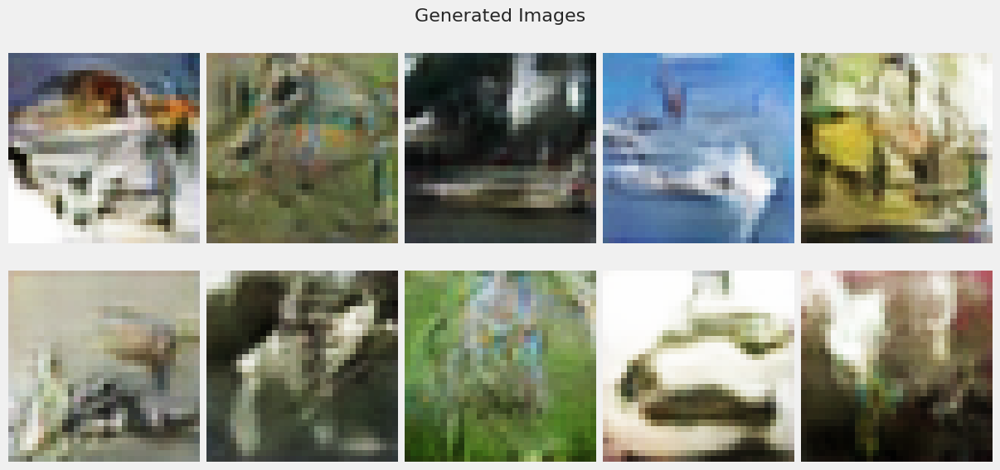

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6917 - d_fake_loss: 0.6884 - g_loss: 0.7299 - d_acc: 0.5156 - d_realO: 0.4977 - d_fakeO: 0.5032
Epoch 62/90
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6893 - g_loss: 0.7303 - d_acc: 0.5143 - d_realO: 0.4977 - d_fakeO: 0.5034
Epoch 63/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6890 - g_loss: 0.7345 - d_acc: 0.5207 - d_realO: 0.4977 - d_fakeO: 0.5033
Epoch 64/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6885 - g_loss: 0.7362 - d_acc: 0.5210 - d_realO: 0.4973 - d_fakeO: 0.5036
Epoch 65/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6918 - d_fake_loss: 0.6873 - g_loss: 0.7308 - d_acc: 0.5193 - d_realO: 0.4977 - d_fakeO: 0.5036
Epoch 66/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6907 - d_fake_loss: 0.

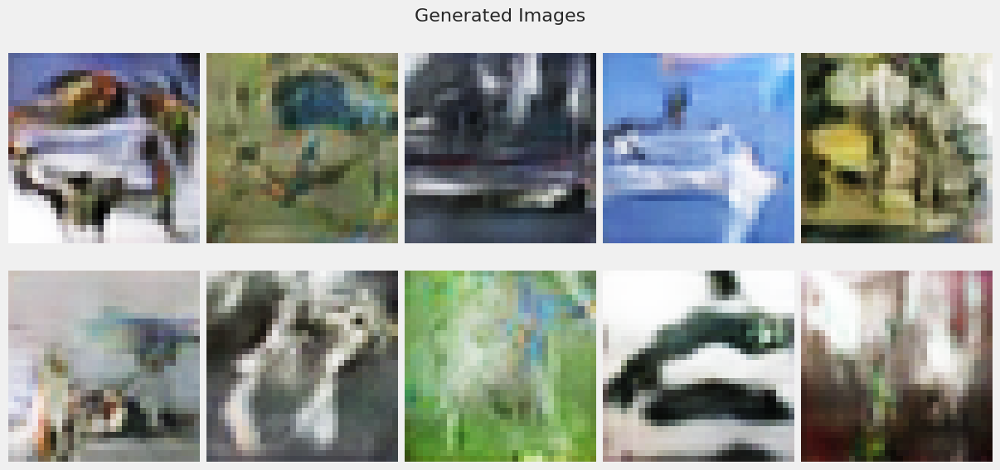

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6890 - d_fake_loss: 0.6884 - g_loss: 0.7348 - d_acc: 0.5240 - d_realO: 0.4964 - d_fakeO: 0.5042
Epoch 72/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6887 - d_fake_loss: 0.6887 - g_loss: 0.7442 - d_acc: 0.5247 - d_realO: 0.4964 - d_fakeO: 0.5045
Epoch 73/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6887 - d_fake_loss: 0.6874 - g_loss: 0.7367 - d_acc: 0.5279 - d_realO: 0.4963 - d_fakeO: 0.5045
Epoch 74/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6883 - d_fake_loss: 0.6879 - g_loss: 0.7390 - d_acc: 0.5271 - d_realO: 0.4959 - d_fakeO: 0.5046
Epoch 75/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6898 - d_fake_loss: 0.6859 - g_loss: 0.7372 - d_acc: 0.5283 - d_realO: 0.4963 - d_fakeO: 0.5045
Epoch 76/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6893 - d_fake_loss: 0.

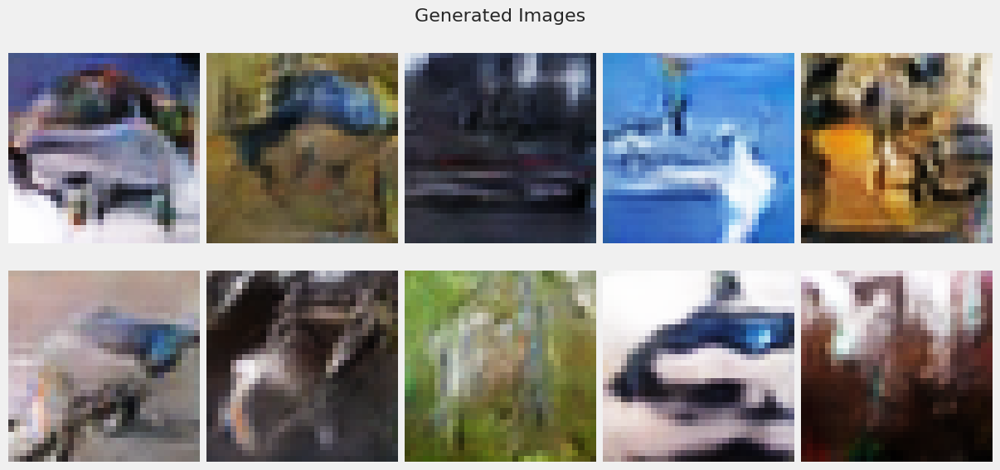

774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6882 - d_fake_loss: 0.6852 - g_loss: 0.7439 - d_acc: 0.5354 - d_realO: 0.4953 - d_fakeO: 0.5054
Epoch 82/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6879 - d_fake_loss: 0.6848 - g_loss: 0.7418 - d_acc: 0.5367 - d_realO: 0.4949 - d_fakeO: 0.5056
Epoch 83/90
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6888 - d_fake_loss: 0.6845 - g_loss: 0.7430 - d_acc: 0.5336 - d_realO: 0.4951 - d_fakeO: 0.5058
Epoch 84/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6871 - d_fake_loss: 0.6853 - g_loss: 0.7438 - d_acc: 0.5336 - d_realO: 0.4949 - d_fakeO: 0.5060
Epoch 85/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6870 - d_fake_loss: 0.6842 - g_loss: 0.7438 - d_acc: 0.5393 - d_realO: 0.4948 - d_fakeO: 0.5060
Epoch 86/90
774/774 [==============================] - 9s 11ms/step - d_real_loss: 0.6864 - d_fake_loss: 0.

In [44]:
gan_4 = train_gan(discriminator_dcgan3, generator_dcgan3, noise, 'Sharpened-Image DCGAN 3', dataset_s, 90, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  54% accuracy
- No model collapse


</div>

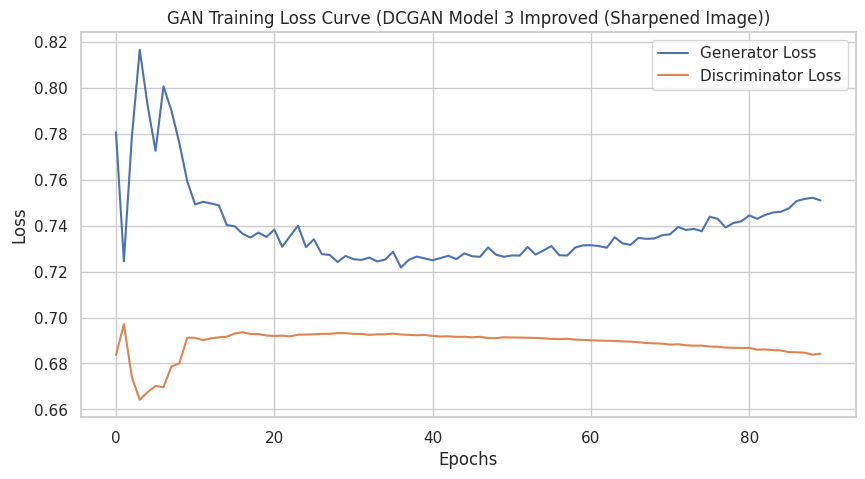

In [45]:
gan_history_4 = gan_4[0].history
generator = gan_4[1].generator  
gan_history_4['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4['d_real_loss'], gan_history_4['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4, title='GAN Training Loss Curve (DCGAN Model 3 Improved (Sharpened Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [46]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 2ms/step
FID Score: 680163.7777268632
KID Score: 33706985.226693675


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID and KID score may not be too good for evaluating this
    

</div>

2/2 [==============================] - 0s 19ms/step


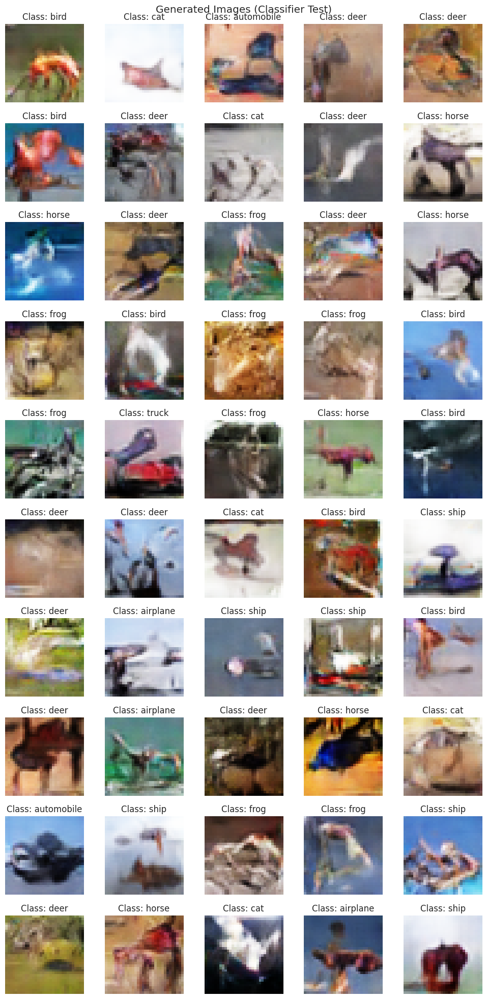

In [47]:
latent_dim = 128 
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Image are much more clear but is not super realistic

</div>

4/4 [==============================] - 0s 3ms/step


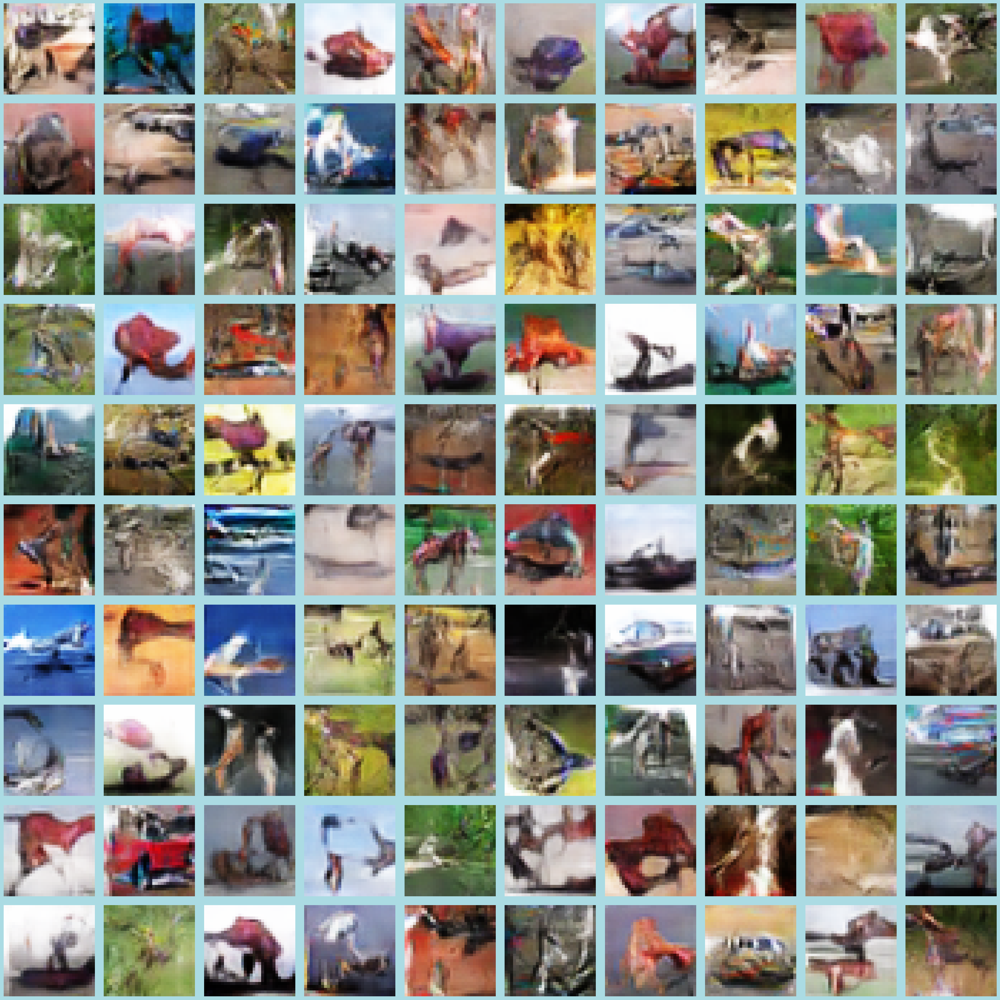

4/4 [==============================] - 0s 2ms/step


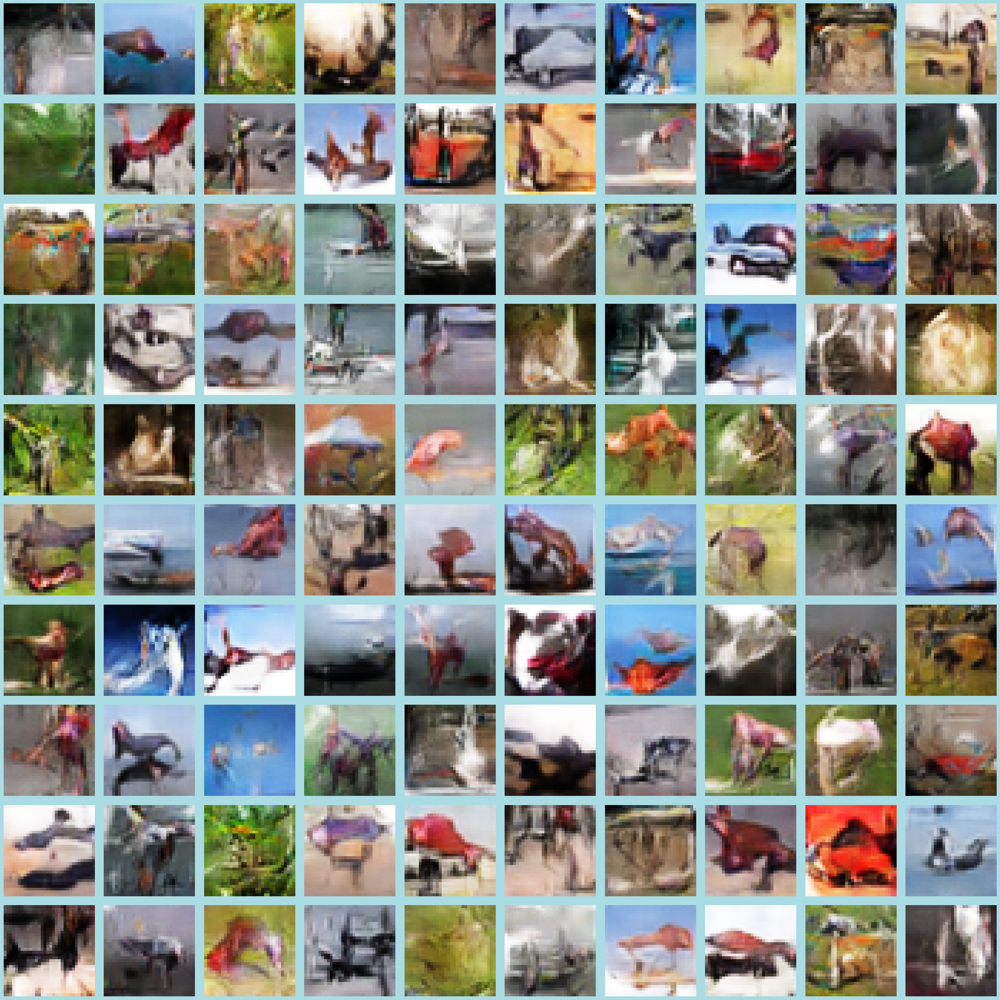

4/4 [==============================] - 0s 3ms/step


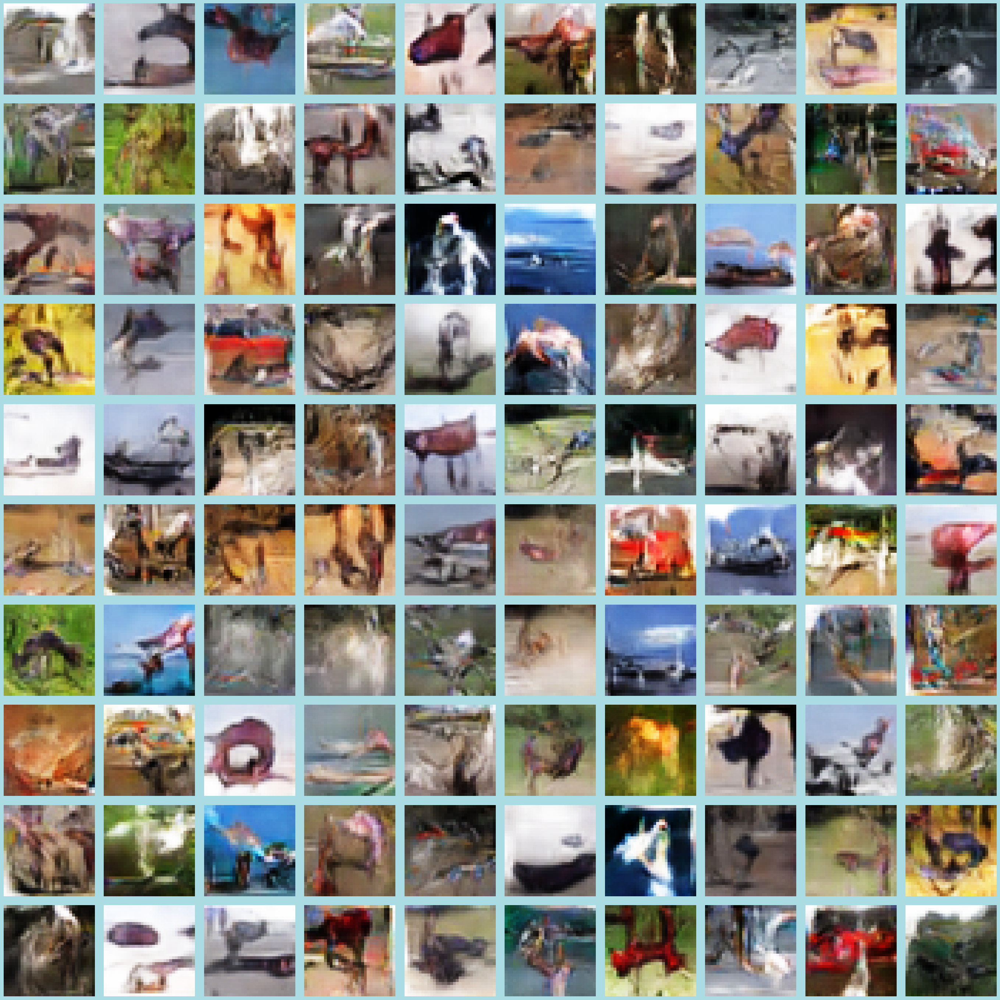

4/4 [==============================] - 0s 3ms/step


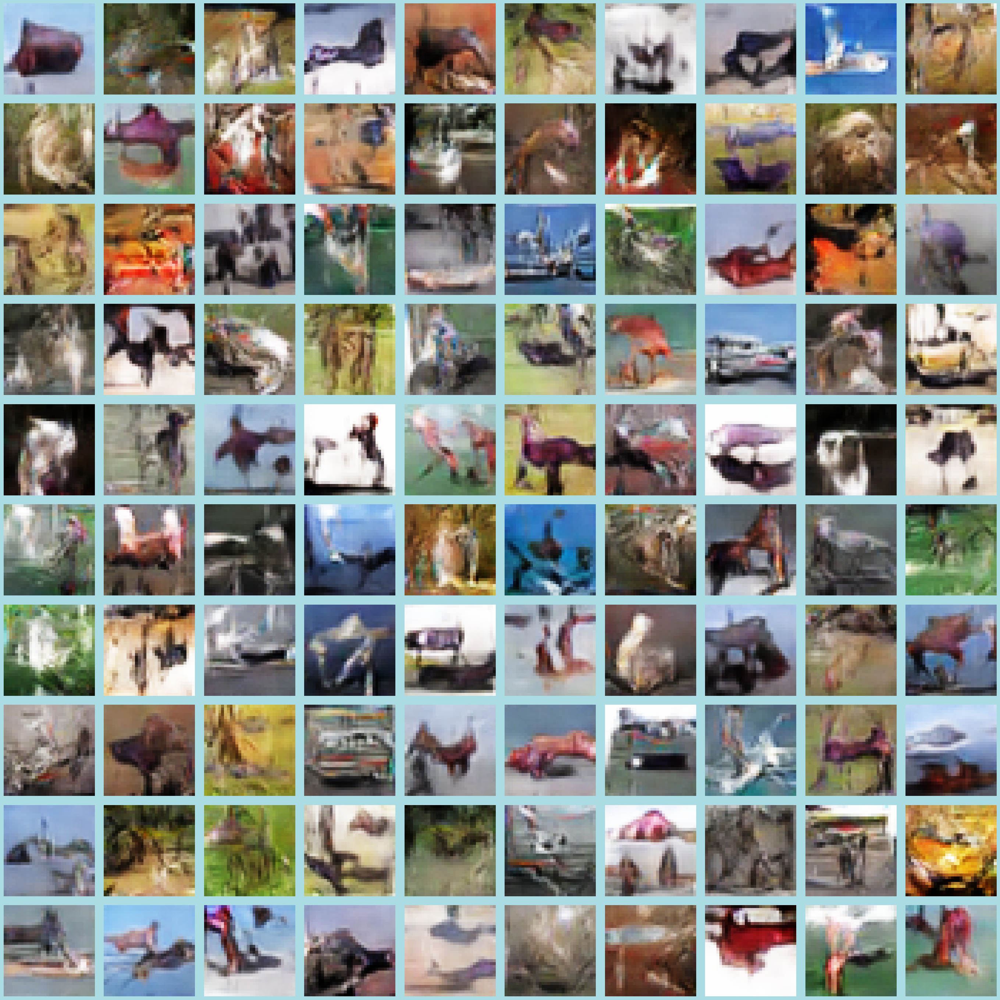

4/4 [==============================] - 0s 2ms/step


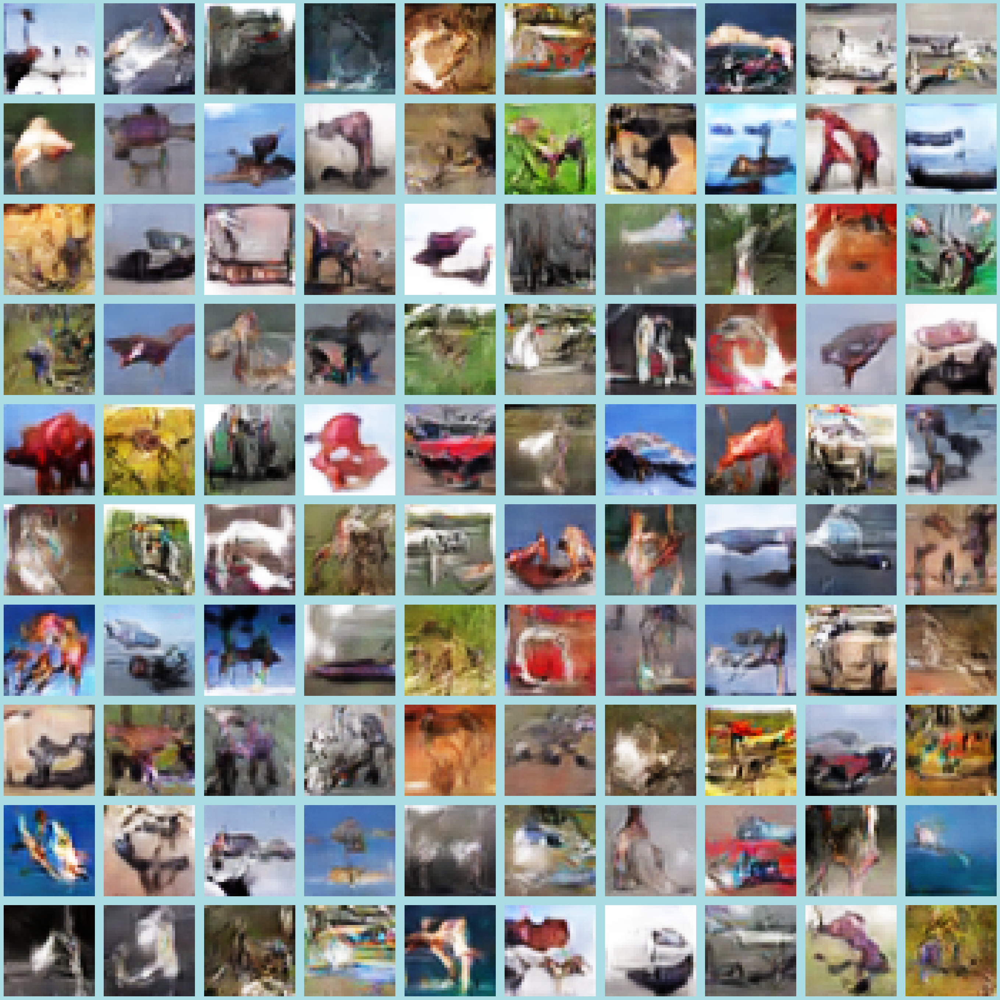

4/4 [==============================] - 0s 2ms/step


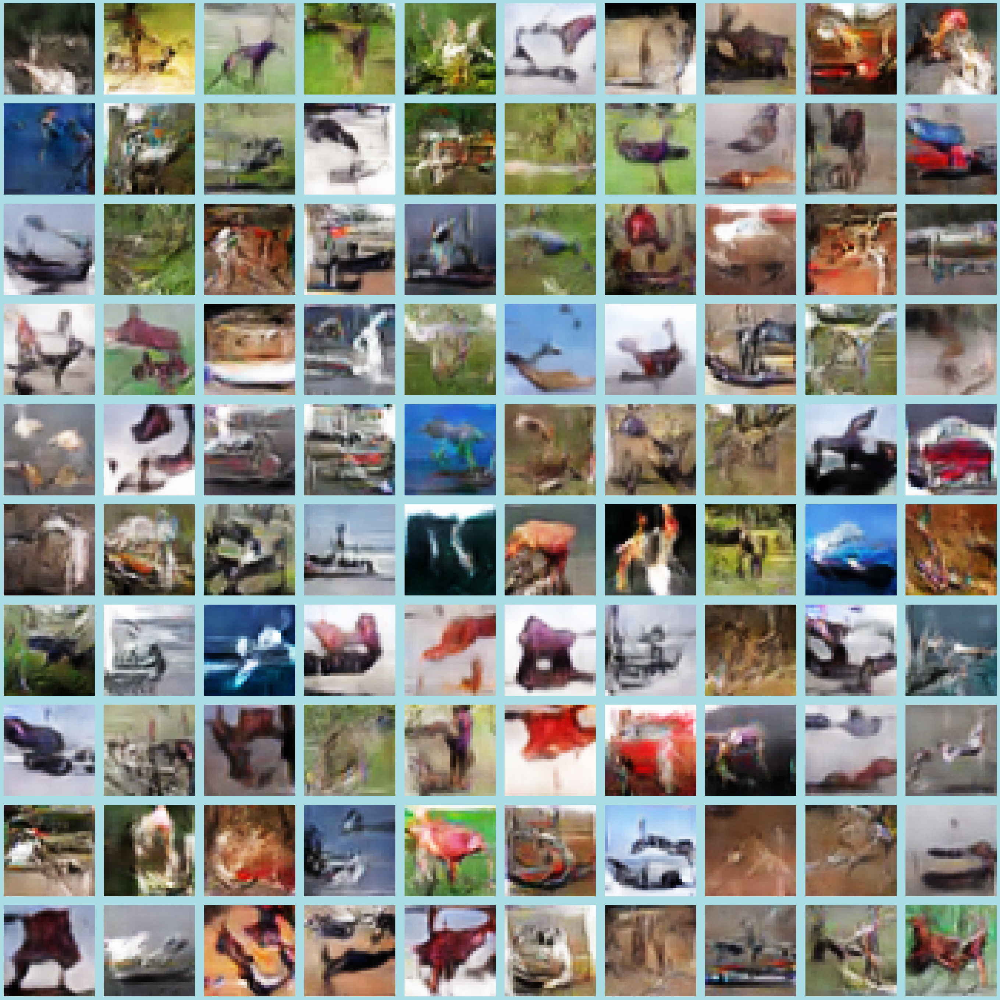

4/4 [==============================] - 0s 4ms/step


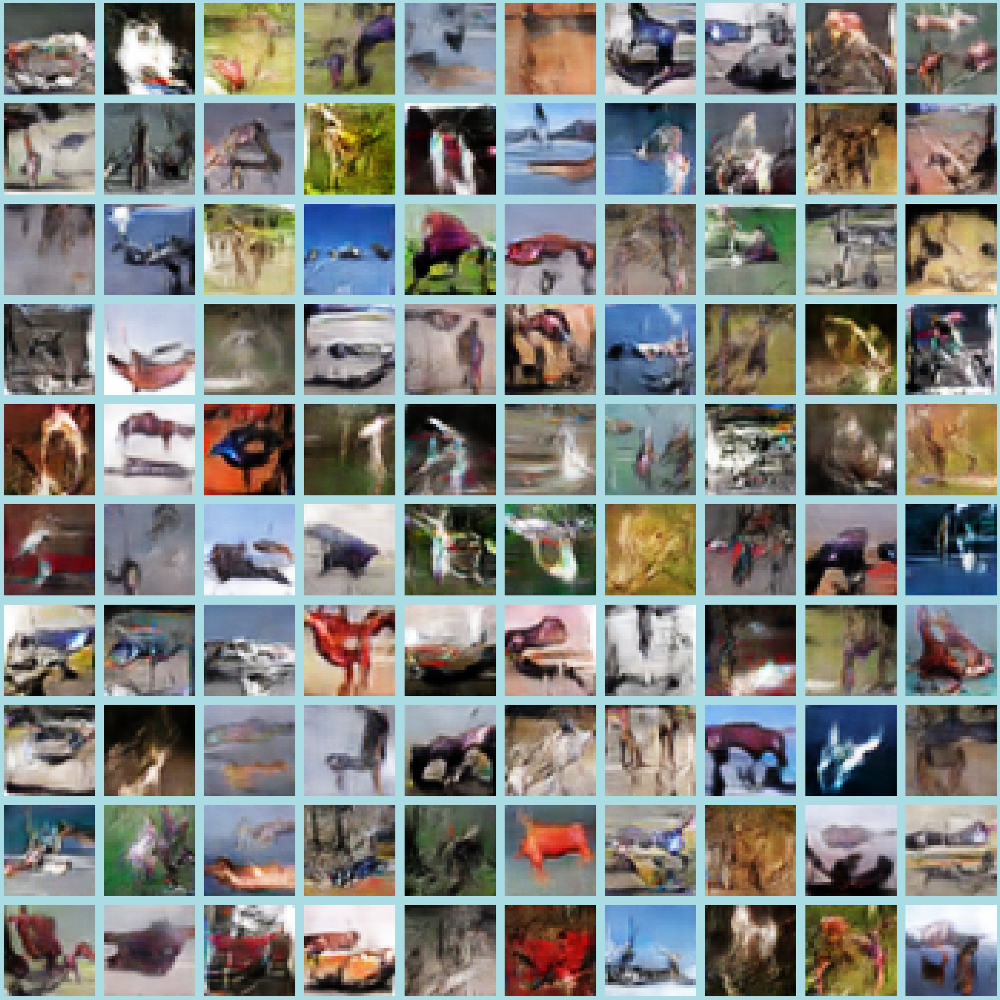

4/4 [==============================] - 0s 2ms/step


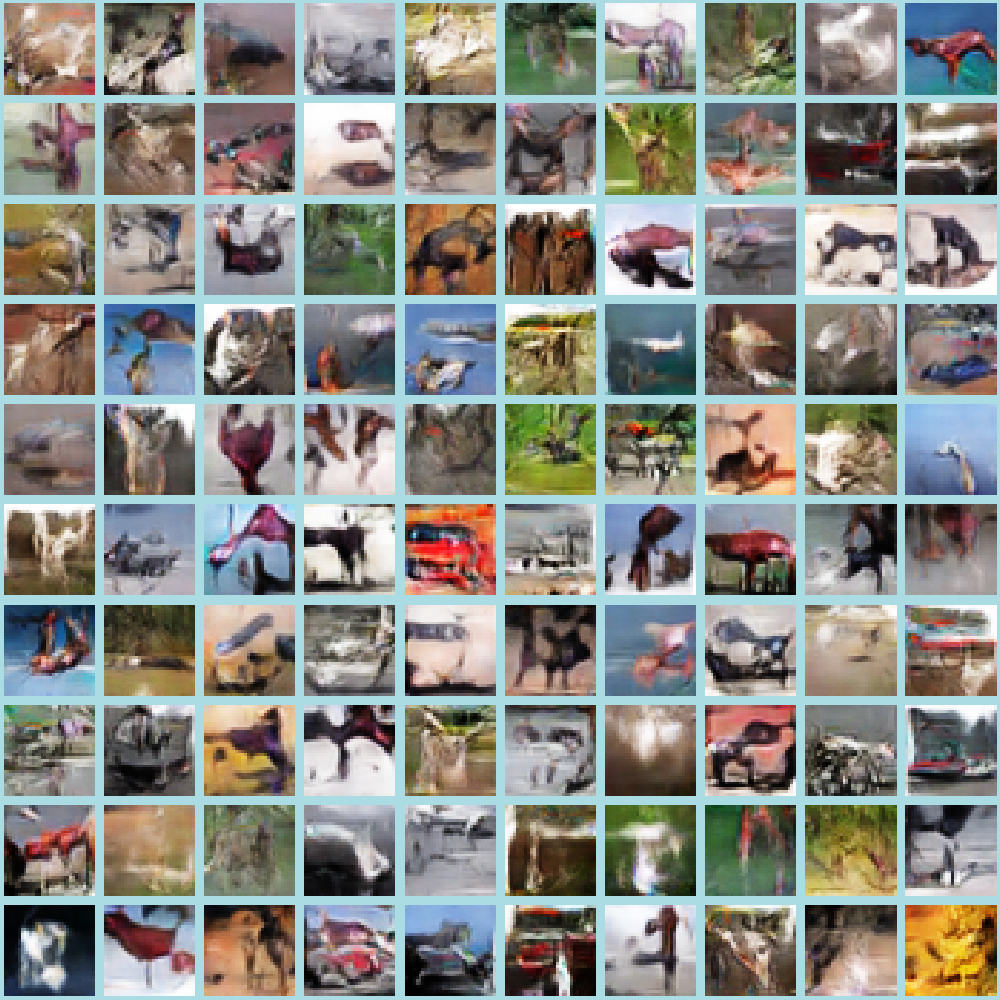

4/4 [==============================] - 0s 3ms/step


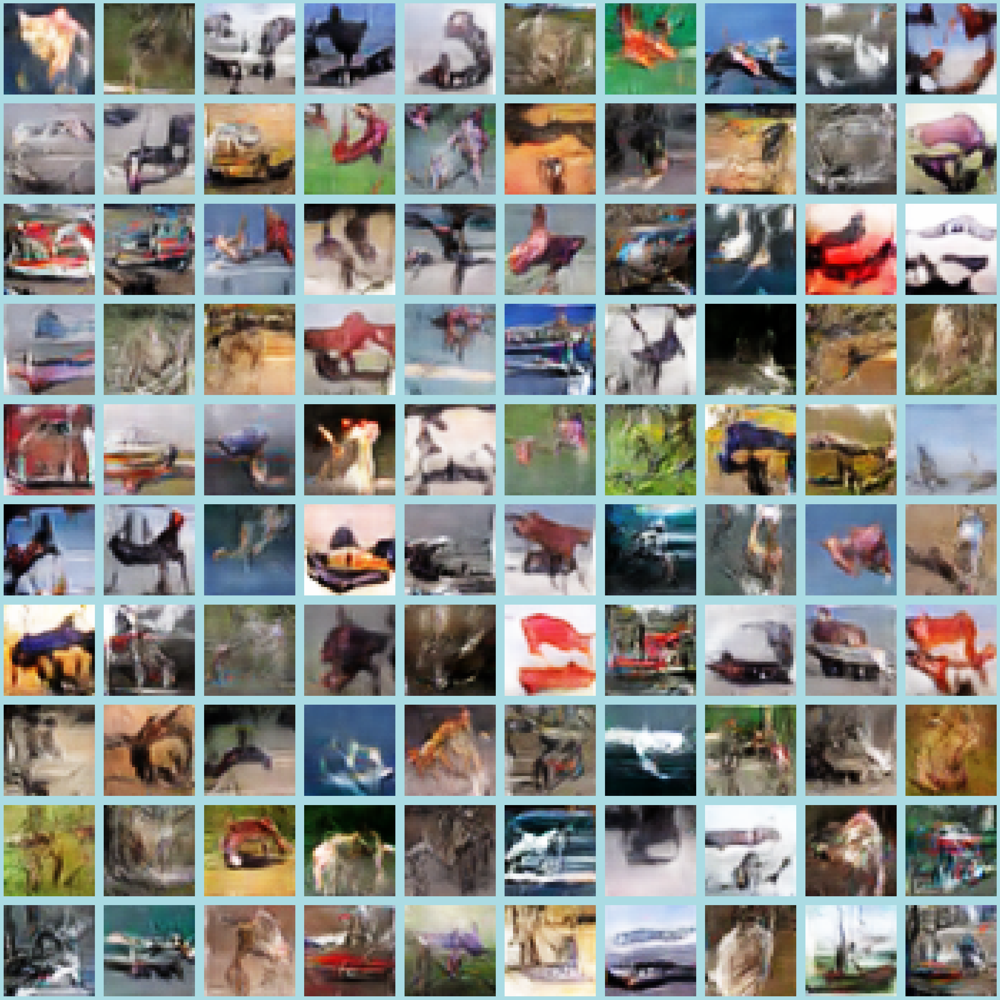

4/4 [==============================] - 0s 3ms/step


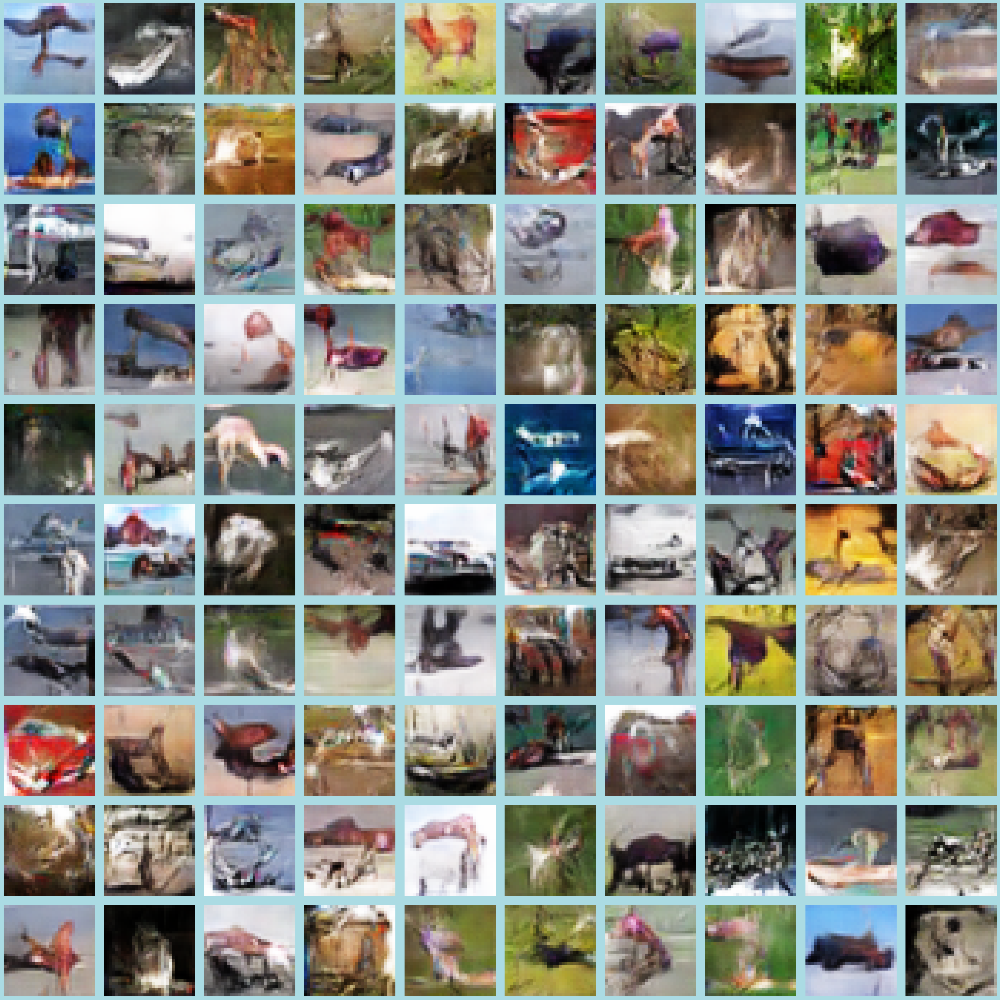

In [48]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [49]:
new_row = {'Model':'Sharpened Image DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4['d_loss'][-1], 'g_loss':gan_history_4['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,2.945318e-02,0.686637,0.746695
1,Sharpened Image DCGAN 3,680163.777727,3.370699e+07,0.684277,0.750914


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering (Data Augmentation))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">



## __Key Ideas__
1. Data augmentation in GANs involves artificially expanding the dataset by generating altered versions of the training images, utilizing techniques such as rotation, width and height shifts, and horizontal flipping, as seen by `ImageDataGenerator`
2. By applying transformations like a 15-degree rotation range, 10% width and height shift range, and enabling horizontal flips, `ImageDataGenerator` enhances the diversity of the training data, helping the model generalize better and reducing overfitting
3. This augmentation process makes the GAN model more robust to variations in input data, effectively teaching the model to recognize and generate images that maintain their identity despite alterations in orientation, position, and perspective
4. Incorporating such data augmentation strategies is particularly useful in scenarios where the dataset is limited, as it artificially expands the dataset size, providing the GAN with more varied examples to learn from




In [68]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1

### Increasing of size and range, contrast

In [69]:
def load_and_preprocess_data():
    (train_images, _), (_, _) = cifar10.load_data()
    train_images = train_images.astype('float32') / 127.5 - 1
    return train_images

def getAugData(batch_size):
    train_images = load_and_preprocess_data()
    data_augmentation = ImageDataGenerator(
        rotation_range=15,       
        width_shift_range=0.1,   
        height_shift_range=0.1,  
        horizontal_flip=True,  
    )

    augmented_data_generator = data_augmentation.flow(train_images, batch_size=batch_size)
    
    return augmented_data_generator

batch_size = 64
augmented_data_generator = getAugData(batch_size)

In [70]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

Epoch 1/100
778/782 [============================>.] - ETA: 0s - d_real_loss: 0.5963 - d_fake_loss: 0.7045 - g_loss: 0.8251 - d_acc: 0.5773 - d_realO: 0.4705 - d_fakeO: 0.5088

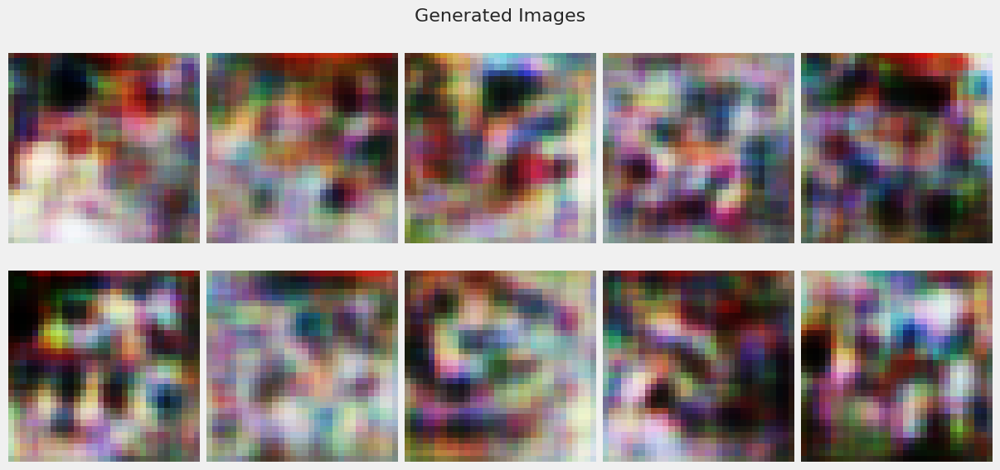

782/782 [==============================] - 16s 17ms/step - d_real_loss: 0.5967 - d_fake_loss: 0.7044 - g_loss: 0.8248 - d_acc: 0.5770 - d_realO: 0.4707 - d_fakeO: 0.5088
Epoch 2/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.7130 - d_fake_loss: 0.6885 - g_loss: 0.7199 - d_acc: 0.4558 - d_realO: 0.5064 - d_fakeO: 0.5040
Epoch 3/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6934 - d_fake_loss: 0.6831 - g_loss: 0.7262 - d_acc: 0.5398 - d_realO: 0.4936 - d_fakeO: 0.5056
Epoch 4/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6741 - d_fake_loss: 0.6832 - g_loss: 0.7667 - d_acc: 0.5606 - d_realO: 0.4872 - d_fakeO: 0.5105
Epoch 5/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6836 - d_fake_loss: 0.6750 - g_loss: 0.7537 - d_acc: 0.5500 - d_realO: 0.4931 - d_fakeO: 0.5093
Epoch 6/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6799 - d_fake_lo

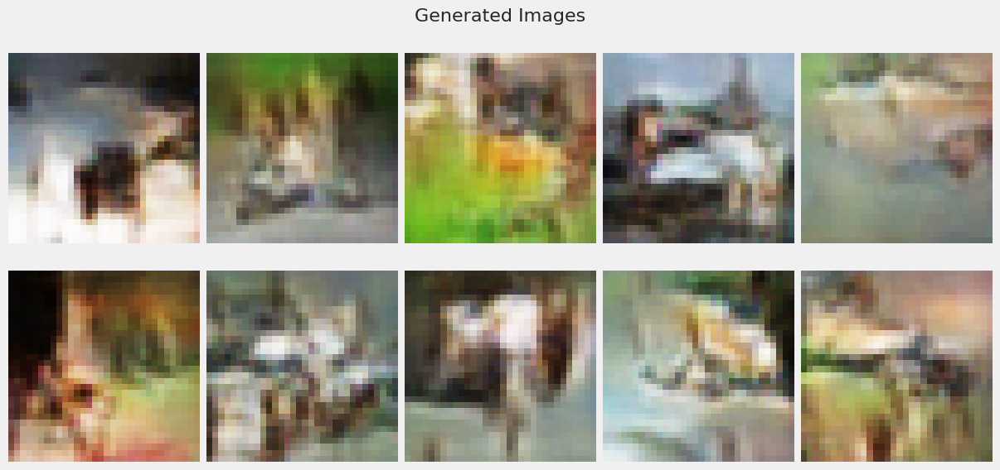

782/782 [==============================] - 15s 17ms/step - d_real_loss: 0.6969 - d_fake_loss: 0.6919 - g_loss: 0.7207 - d_acc: 0.4855 - d_realO: 0.5009 - d_fakeO: 0.5015
Epoch 12/100
782/782 [==============================] - 11s 11ms/step - d_real_loss: 0.6993 - d_fake_loss: 0.6911 - g_loss: 0.7264 - d_acc: 0.4813 - d_realO: 0.5016 - d_fakeO: 0.5017
Epoch 13/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6983 - d_fake_loss: 0.6932 - g_loss: 0.7196 - d_acc: 0.4704 - d_realO: 0.5014 - d_fakeO: 0.5009
Epoch 14/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6978 - d_fake_loss: 0.6925 - g_loss: 0.7177 - d_acc: 0.4767 - d_realO: 0.5008 - d_fakeO: 0.5008
Epoch 15/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6988 - d_fake_loss: 0.6911 - g_loss: 0.7172 - d_acc: 0.4749 - d_realO: 0.5013 - d_fakeO: 0.5010
Epoch 16/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6967 - d_fa

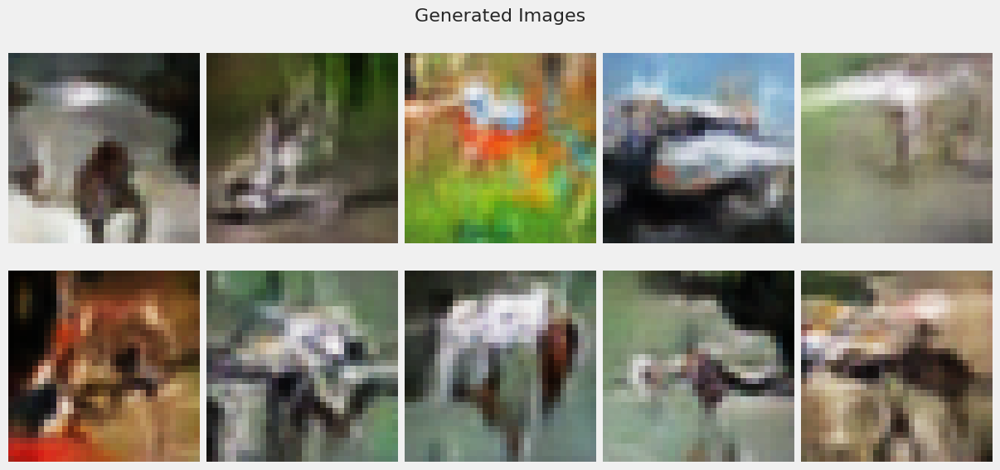

782/782 [==============================] - 15s 17ms/step - d_real_loss: 0.6957 - d_fake_loss: 0.6928 - g_loss: 0.7128 - d_acc: 0.4847 - d_realO: 0.5008 - d_fakeO: 0.5006
Epoch 22/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6960 - d_fake_loss: 0.6930 - g_loss: 0.7125 - d_acc: 0.4781 - d_realO: 0.5008 - d_fakeO: 0.5005
Epoch 23/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6953 - d_fake_loss: 0.6931 - g_loss: 0.7122 - d_acc: 0.4802 - d_realO: 0.5008 - d_fakeO: 0.5006
Epoch 24/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6951 - d_fake_loss: 0.6933 - g_loss: 0.7108 - d_acc: 0.4807 - d_realO: 0.5005 - d_fakeO: 0.5004
Epoch 25/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6952 - d_fake_loss: 0.6932 - g_loss: 0.7147 - d_acc: 0.4812 - d_realO: 0.5007 - d_fakeO: 0.5005
Epoch 26/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6962 - d_fa

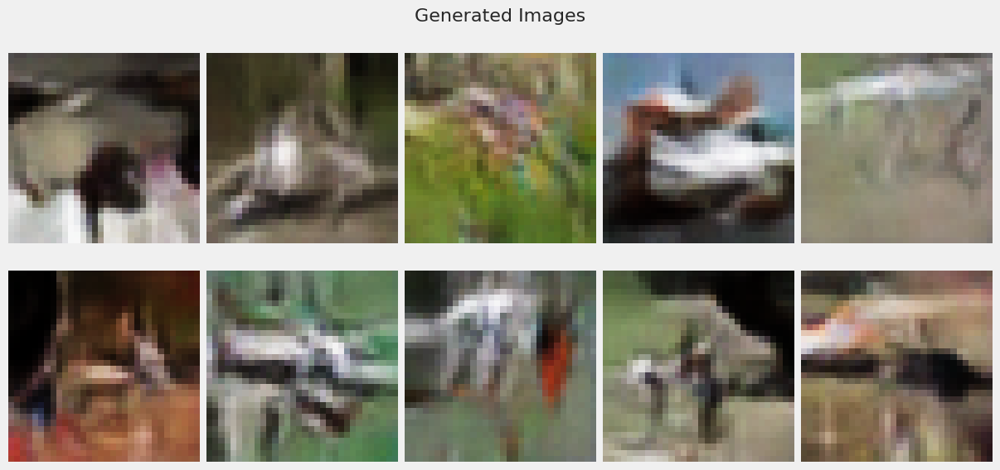

782/782 [==============================] - 16s 17ms/step - d_real_loss: 0.6963 - d_fake_loss: 0.6930 - g_loss: 0.7074 - d_acc: 0.4634 - d_realO: 0.5011 - d_fakeO: 0.5002
Epoch 32/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6955 - d_fake_loss: 0.6940 - g_loss: 0.7065 - d_acc: 0.4660 - d_realO: 0.5010 - d_fakeO: 0.4999
Epoch 33/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6953 - d_fake_loss: 0.6938 - g_loss: 0.7072 - d_acc: 0.4693 - d_realO: 0.5008 - d_fakeO: 0.5000
Epoch 34/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6954 - d_fake_loss: 0.6938 - g_loss: 0.7071 - d_acc: 0.4711 - d_realO: 0.5008 - d_fakeO: 0.5000
Epoch 35/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6952 - d_fake_loss: 0.6938 - g_loss: 0.7062 - d_acc: 0.4682 - d_realO: 0.5009 - d_fakeO: 0.5000
Epoch 36/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6945 - d_fa

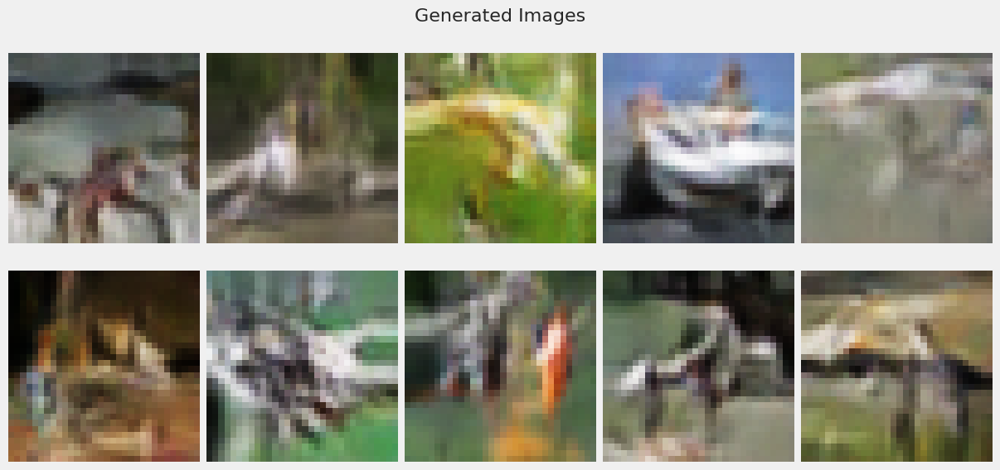

782/782 [==============================] - 15s 17ms/step - d_real_loss: 0.6952 - d_fake_loss: 0.6932 - g_loss: 0.7070 - d_acc: 0.4764 - d_realO: 0.5007 - d_fakeO: 0.5002
Epoch 42/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6949 - d_fake_loss: 0.6932 - g_loss: 0.7064 - d_acc: 0.4771 - d_realO: 0.5007 - d_fakeO: 0.5002
Epoch 43/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6946 - d_fake_loss: 0.6934 - g_loss: 0.7065 - d_acc: 0.4760 - d_realO: 0.5006 - d_fakeO: 0.5001
Epoch 44/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6946 - d_fake_loss: 0.6934 - g_loss: 0.7066 - d_acc: 0.4811 - d_realO: 0.5004 - d_fakeO: 0.5000
Epoch 45/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6947 - d_fake_loss: 0.6934 - g_loss: 0.7076 - d_acc: 0.4825 - d_realO: 0.5007 - d_fakeO: 0.5003
Epoch 46/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6947 - d_fa

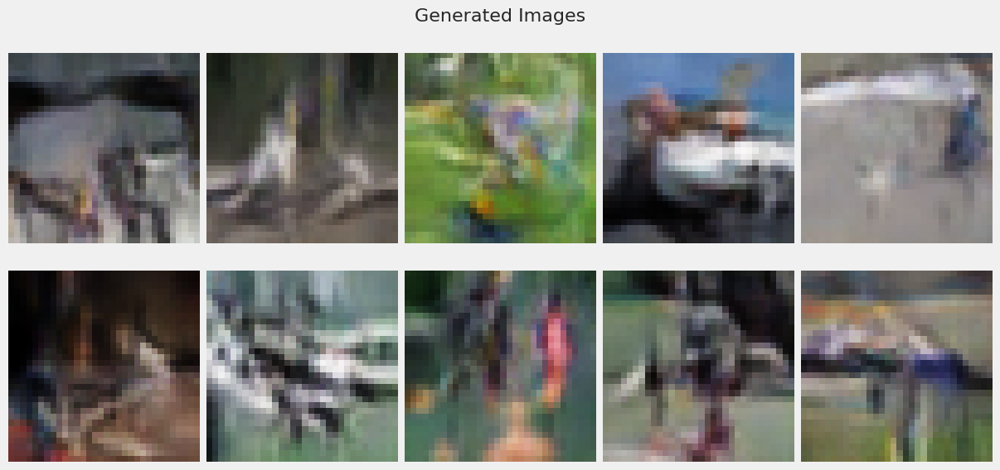

782/782 [==============================] - 15s 17ms/step - d_real_loss: 0.6950 - d_fake_loss: 0.6919 - g_loss: 0.7086 - d_acc: 0.4893 - d_realO: 0.5006 - d_fakeO: 0.5006
Epoch 52/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6938 - d_fake_loss: 0.6935 - g_loss: 0.7065 - d_acc: 0.4843 - d_realO: 0.5002 - d_fakeO: 0.5002
Epoch 53/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6946 - d_fake_loss: 0.6922 - g_loss: 0.7079 - d_acc: 0.4876 - d_realO: 0.5005 - d_fakeO: 0.5005
Epoch 54/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6942 - d_fake_loss: 0.6931 - g_loss: 0.7076 - d_acc: 0.4843 - d_realO: 0.5003 - d_fakeO: 0.5004
Epoch 55/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6945 - d_fake_loss: 0.6925 - g_loss: 0.7081 - d_acc: 0.4847 - d_realO: 0.5003 - d_fakeO: 0.5004
Epoch 56/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6950 - d_fa

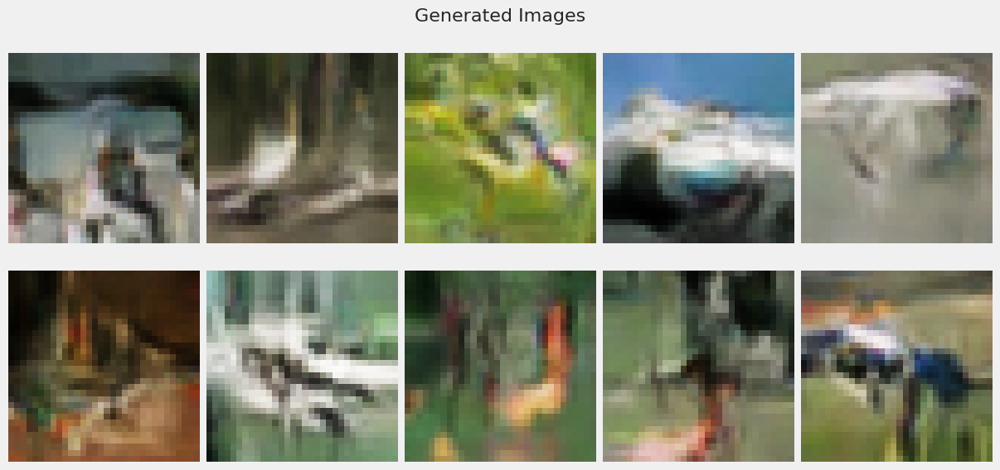

782/782 [==============================] - 16s 18ms/step - d_real_loss: 0.6938 - d_fake_loss: 0.6932 - g_loss: 0.7085 - d_acc: 0.4881 - d_realO: 0.5002 - d_fakeO: 0.5003
Epoch 62/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6941 - d_fake_loss: 0.6927 - g_loss: 0.7083 - d_acc: 0.4896 - d_realO: 0.5003 - d_fakeO: 0.5005
Epoch 63/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6940 - d_fake_loss: 0.6927 - g_loss: 0.7087 - d_acc: 0.4890 - d_realO: 0.5001 - d_fakeO: 0.5004
Epoch 64/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6939 - d_fake_loss: 0.6927 - g_loss: 0.7086 - d_acc: 0.4894 - d_realO: 0.5001 - d_fakeO: 0.5005
Epoch 65/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6940 - d_fake_loss: 0.6923 - g_loss: 0.7095 - d_acc: 0.4922 - d_realO: 0.5001 - d_fakeO: 0.5007
Epoch 66/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6937 - d_fa

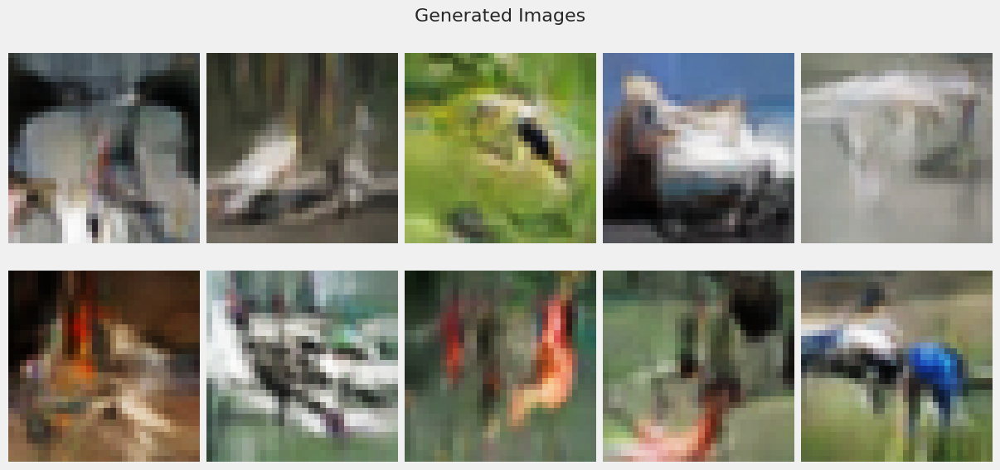

782/782 [==============================] - 16s 17ms/step - d_real_loss: 0.6935 - d_fake_loss: 0.6920 - g_loss: 0.7112 - d_acc: 0.4997 - d_realO: 0.4999 - d_fakeO: 0.5010
Epoch 72/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6931 - d_fake_loss: 0.6922 - g_loss: 0.7109 - d_acc: 0.4991 - d_realO: 0.4996 - d_fakeO: 0.5009
Epoch 73/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6939 - d_fake_loss: 0.6912 - g_loss: 0.7125 - d_acc: 0.5045 - d_realO: 0.4999 - d_fakeO: 0.5011
Epoch 74/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6932 - d_fake_loss: 0.6918 - g_loss: 0.7120 - d_acc: 0.5059 - d_realO: 0.4996 - d_fakeO: 0.5012
Epoch 75/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6930 - d_fake_loss: 0.6922 - g_loss: 0.7120 - d_acc: 0.5000 - d_realO: 0.4997 - d_fakeO: 0.5010
Epoch 76/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6932 - d_fa

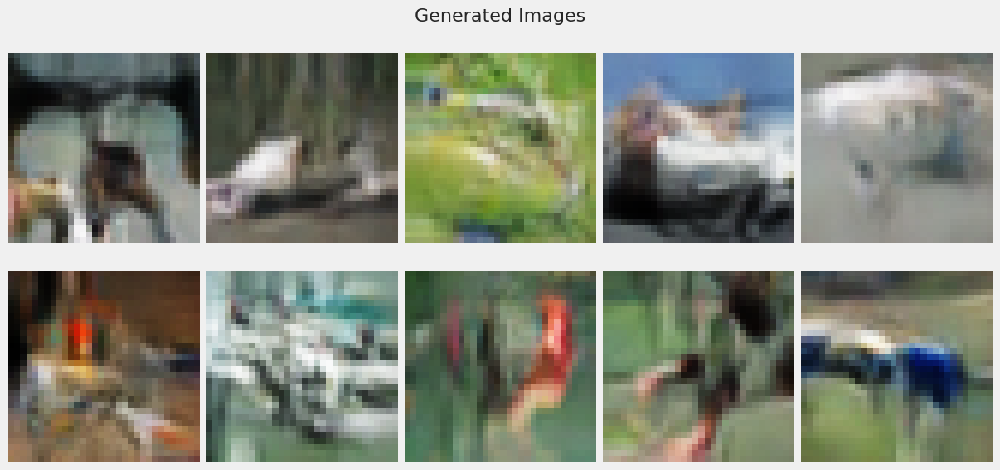

782/782 [==============================] - 16s 17ms/step - d_real_loss: 0.6934 - d_fake_loss: 0.6905 - g_loss: 0.7146 - d_acc: 0.5062 - d_realO: 0.4994 - d_fakeO: 0.5016
Epoch 82/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6927 - d_fake_loss: 0.6907 - g_loss: 0.7154 - d_acc: 0.5090 - d_realO: 0.4994 - d_fakeO: 0.5015
Epoch 83/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.6904 - g_loss: 0.7158 - d_acc: 0.5075 - d_realO: 0.4992 - d_fakeO: 0.5017
Epoch 84/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6926 - d_fake_loss: 0.6913 - g_loss: 0.7161 - d_acc: 0.5107 - d_realO: 0.4992 - d_fakeO: 0.5015
Epoch 85/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.6901 - g_loss: 0.7189 - d_acc: 0.5124 - d_realO: 0.4991 - d_fakeO: 0.5019
Epoch 86/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6921 - d_fa

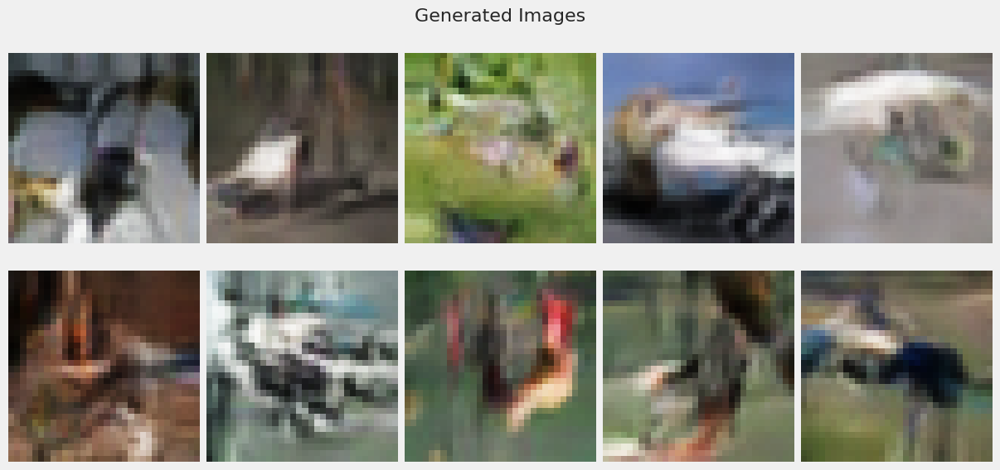

782/782 [==============================] - 16s 17ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6895 - g_loss: 0.7198 - d_acc: 0.5194 - d_realO: 0.4987 - d_fakeO: 0.5023
Epoch 92/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6894 - g_loss: 0.7199 - d_acc: 0.5146 - d_realO: 0.4986 - d_fakeO: 0.5024
Epoch 93/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6917 - d_fake_loss: 0.6891 - g_loss: 0.7203 - d_acc: 0.5211 - d_realO: 0.4985 - d_fakeO: 0.5024
Epoch 94/100
782/782 [==============================] - 11s 11ms/step - d_real_loss: 0.6921 - d_fake_loss: 0.6898 - g_loss: 0.7202 - d_acc: 0.5147 - d_realO: 0.4986 - d_fakeO: 0.5024
Epoch 95/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6907 - d_fake_loss: 0.6892 - g_loss: 0.7208 - d_acc: 0.5239 - d_realO: 0.4982 - d_fakeO: 0.5025
Epoch 96/100
782/782 [==============================] - 12s 12ms/step - d_real_loss: 0.6909 - d_fa

In [53]:
gan_4_1 = DCGAN(discriminator=discriminator_dcgan3,generator=generator_dcgan3,latent_dim=128,model_name='CUTMIX DCGAN-3')
gan_4_1.compile(d_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),g_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),loss_fn=tf.keras.losses.BinaryCrossentropy(),)
gan_history_4_1 = gan_4_1.fit(augmented_data_generator,epochs=100,use_multiprocessing=True,workers=16,callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  72% accuracy
- No model collapse


</div>

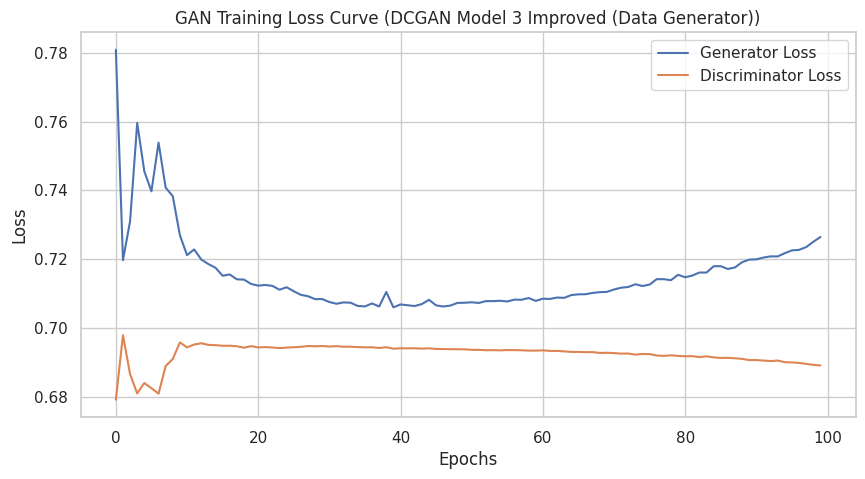

In [55]:
gan_history_4_1 = gan_4_1.history.history
generator = gan_4_1.generator  
gan_history_4_1['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4_1['d_real_loss'], gan_history_4_1['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4_1, title='GAN Training Loss Curve (DCGAN Model 3 Improved (Data Generator))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [56]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 2ms/step
FID Score: 700665.8908980214
KID Score: 37649378.87660855


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 70000
- KID Score is 370000
    
It may not be the best to use this metrics here
</div>

2/2 [==============================] - 0s 18ms/step


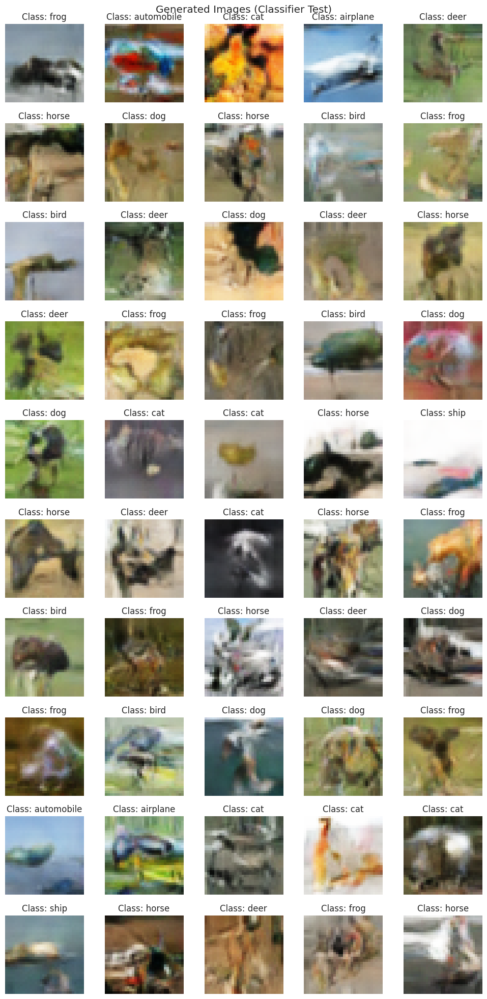

In [57]:
latent_dim = 128 
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Seeing the image, the technique did not exactly help

</div>

4/4 [==============================] - 0s 2ms/step


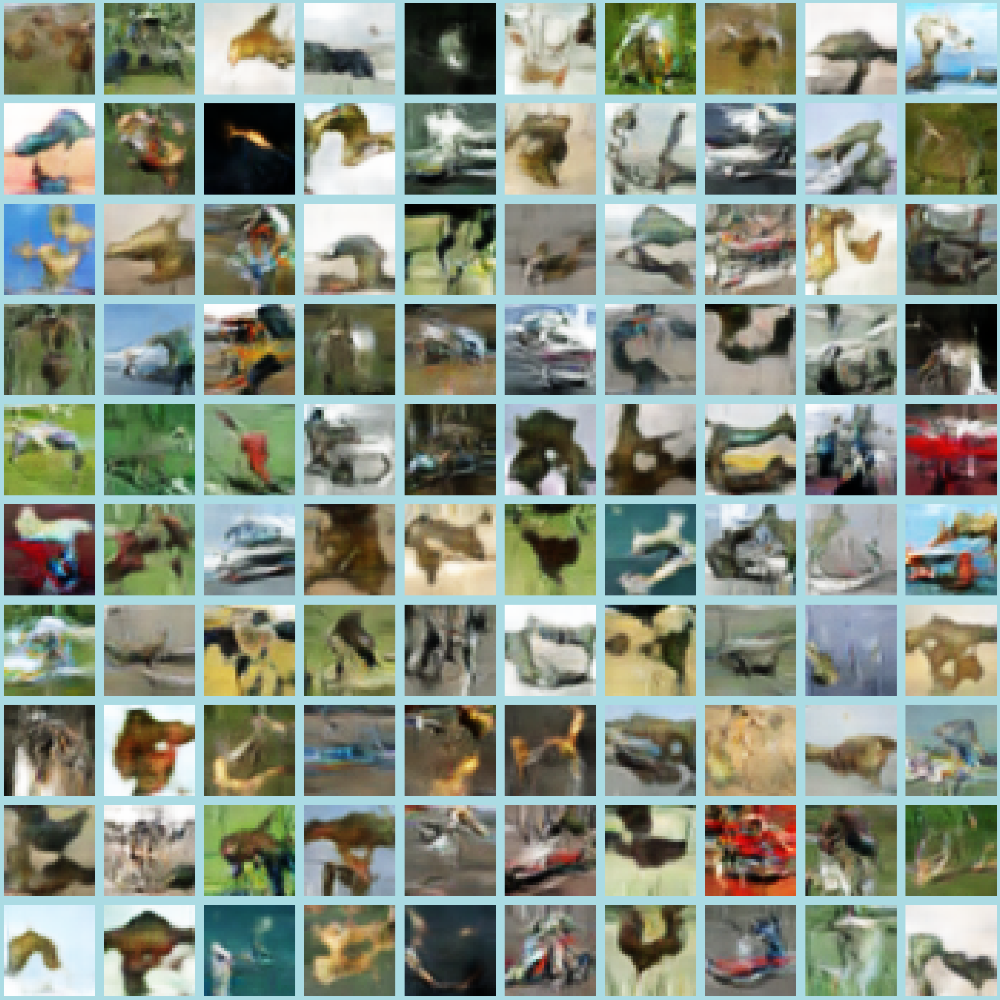

4/4 [==============================] - 0s 1ms/step


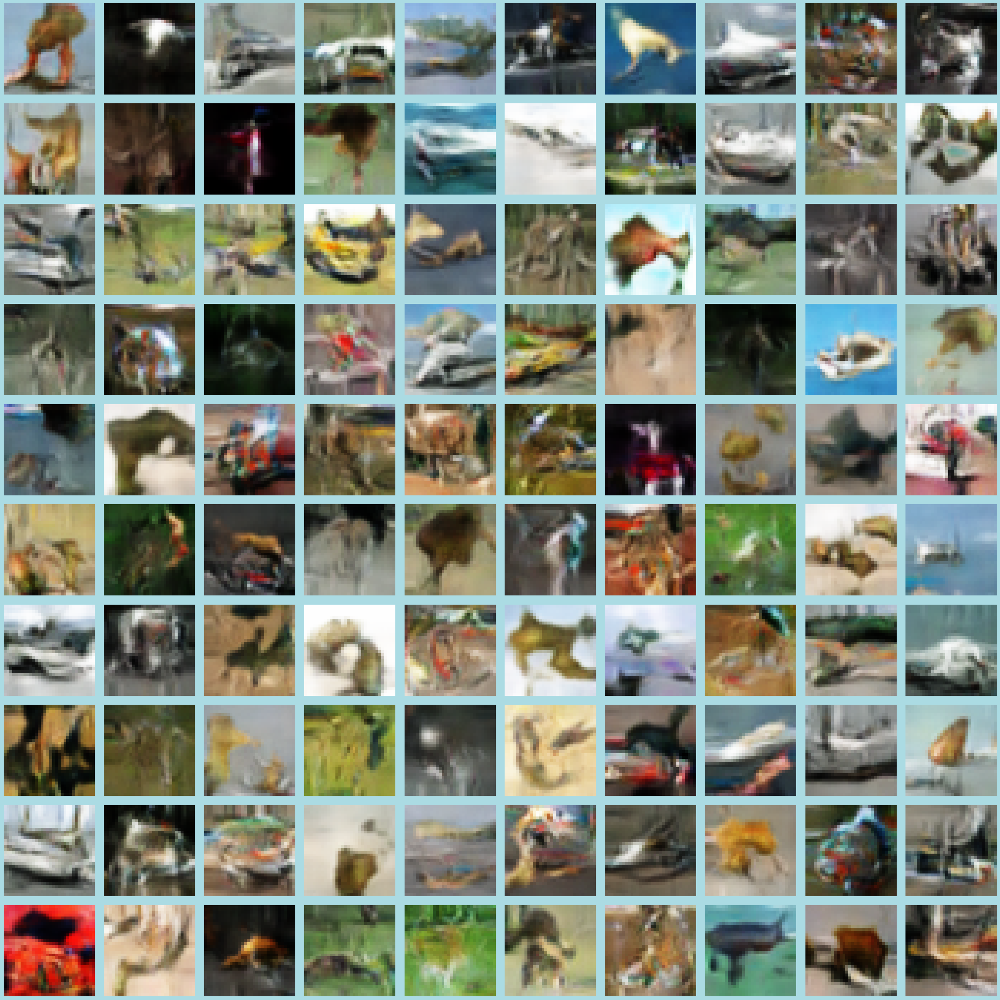

4/4 [==============================] - 0s 2ms/step


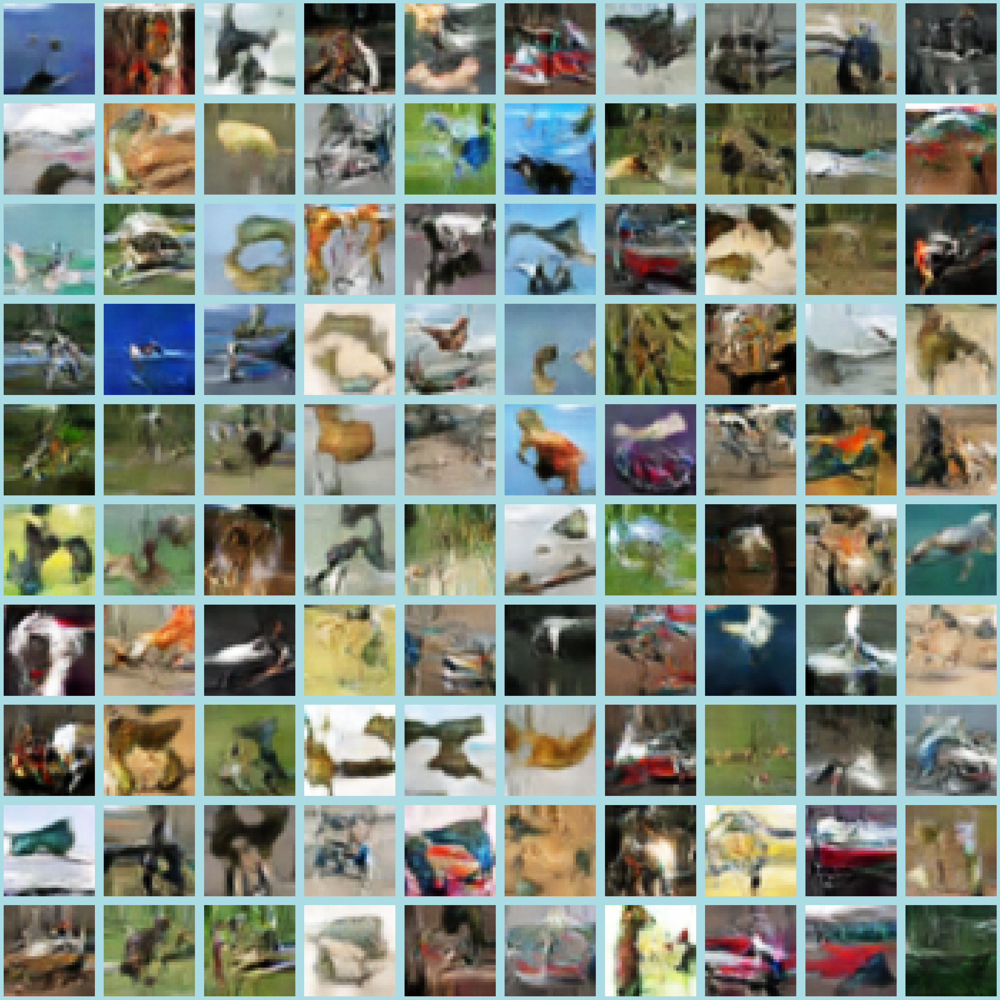

4/4 [==============================] - 0s 2ms/step


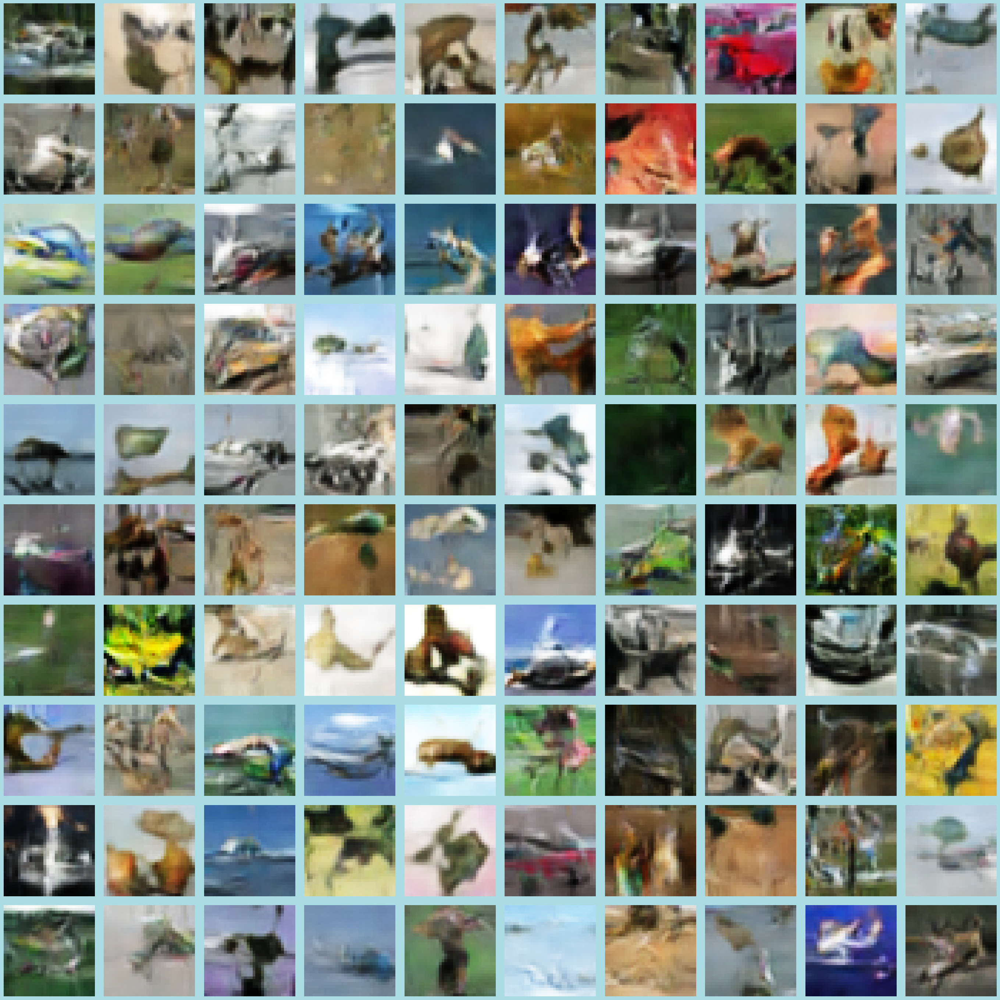

4/4 [==============================] - 0s 2ms/step


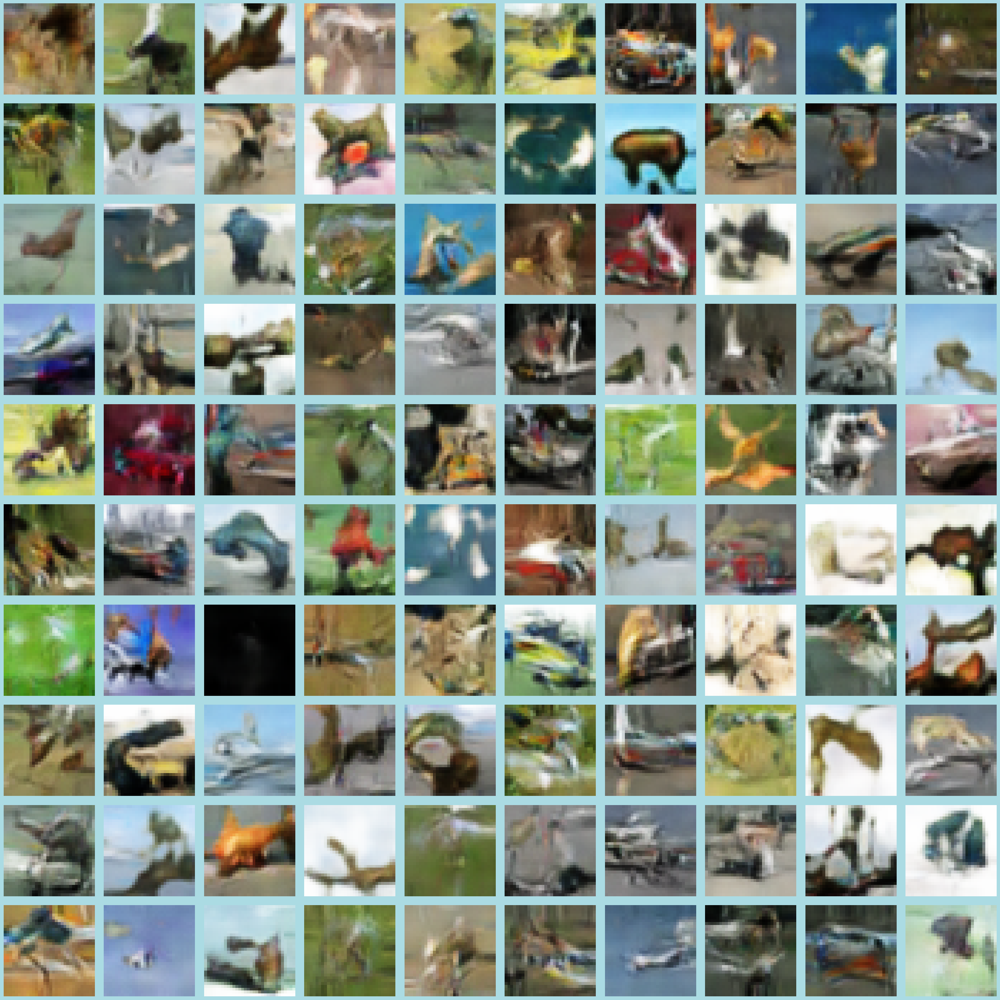

4/4 [==============================] - 0s 2ms/step


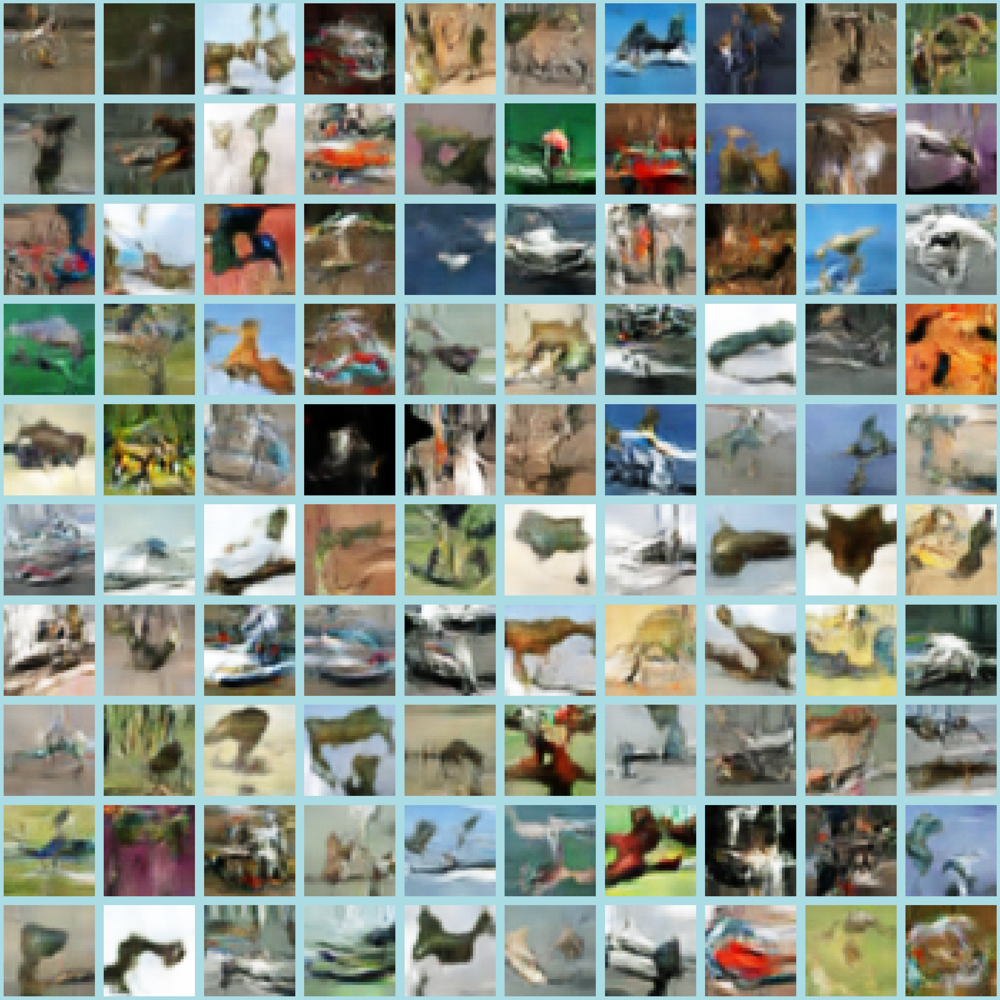

4/4 [==============================] - 0s 2ms/step


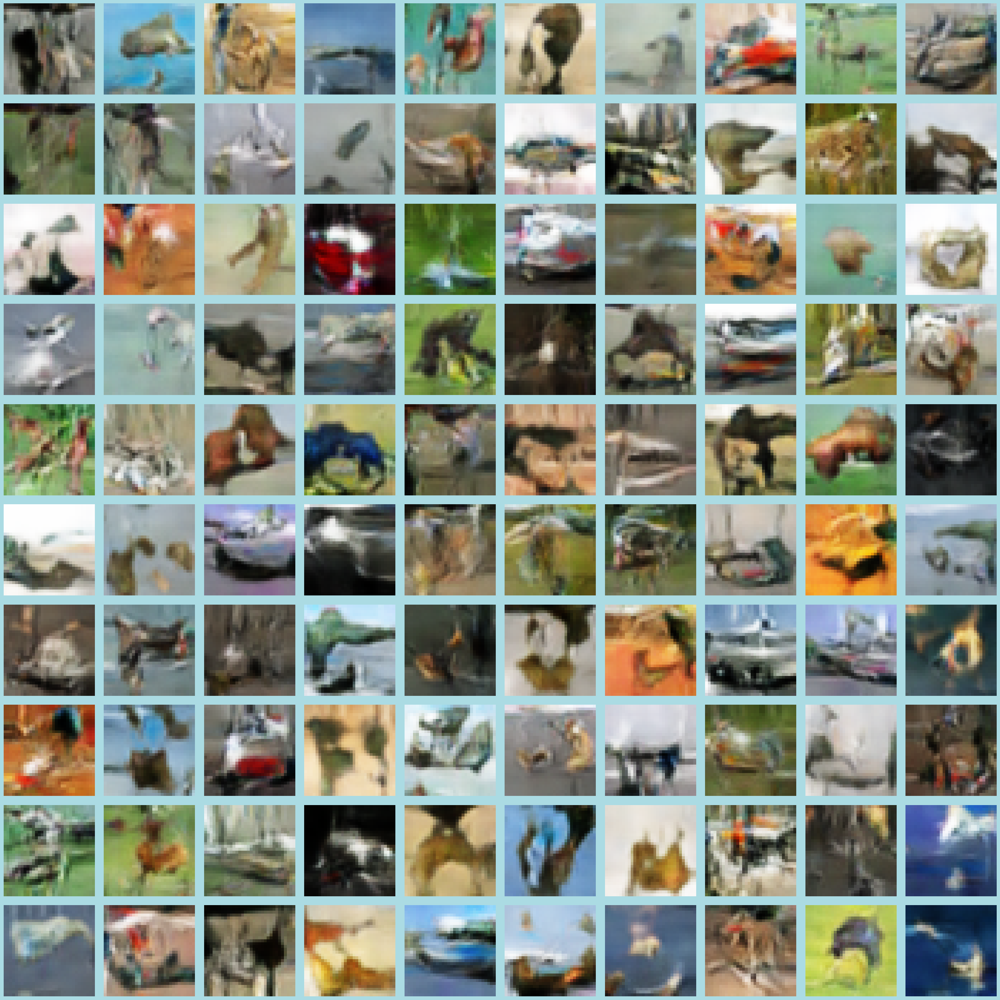

4/4 [==============================] - 0s 2ms/step


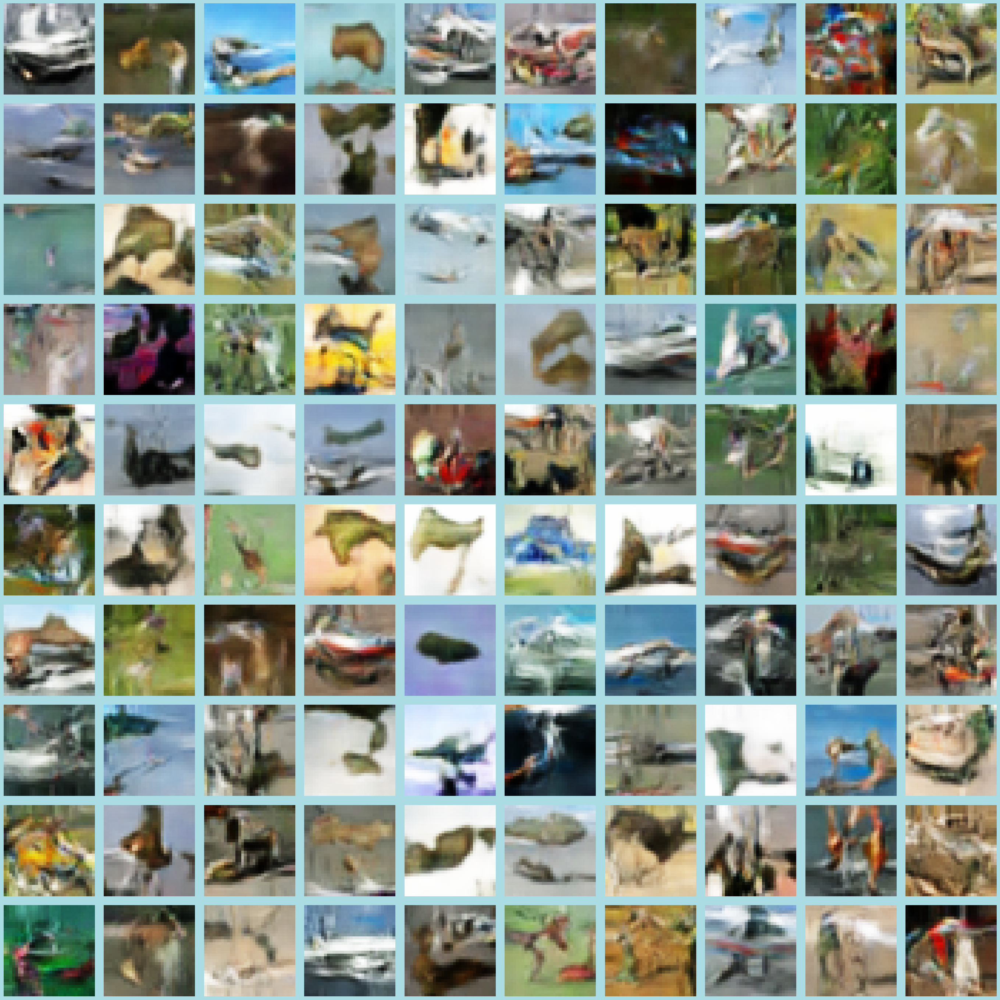

4/4 [==============================] - 0s 3ms/step


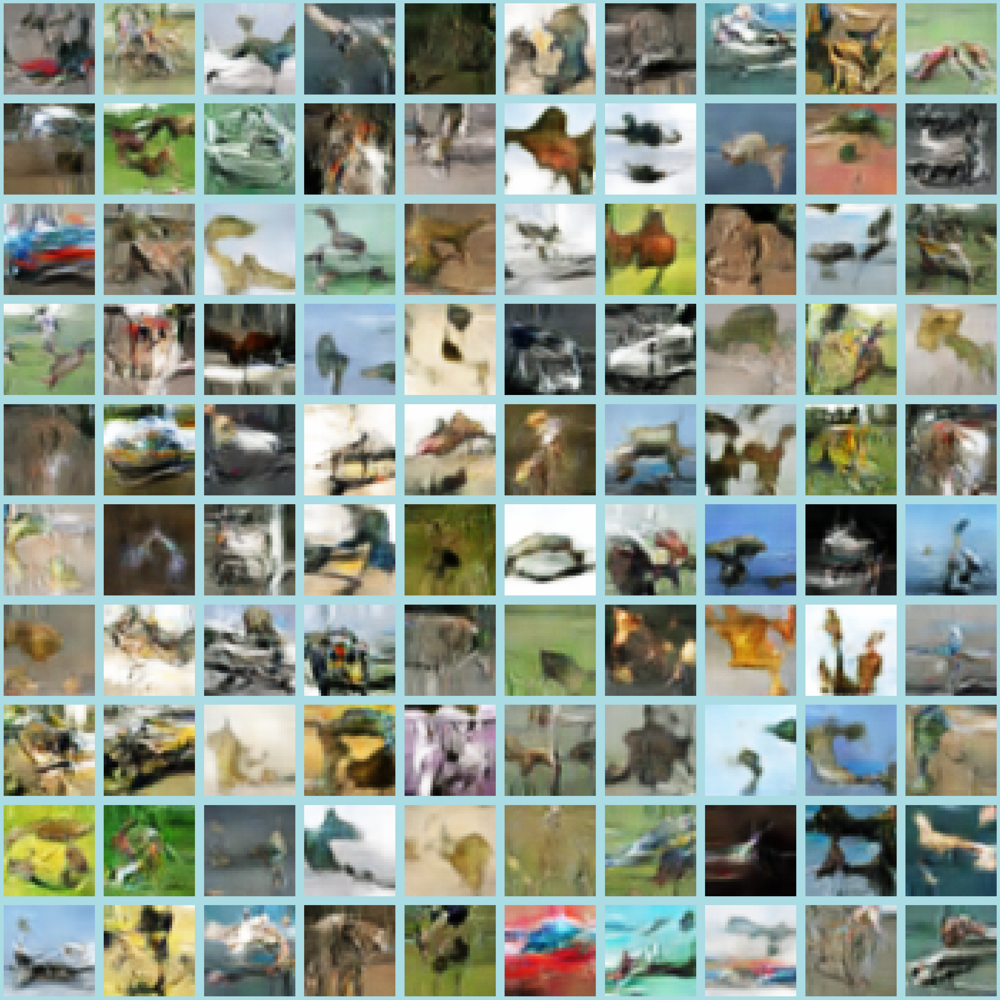

4/4 [==============================] - 0s 2ms/step


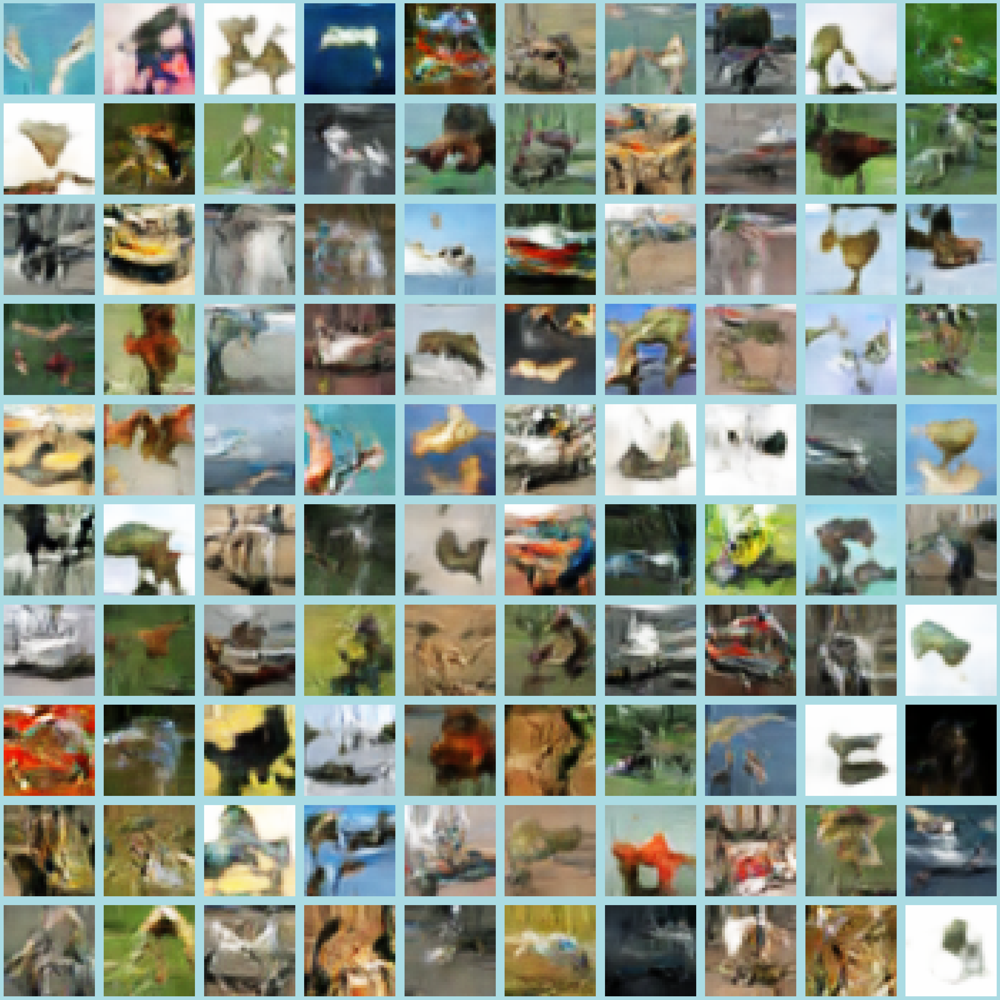

In [58]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>
- Image quality looks average here
</div>

#### Storing the scores

In [59]:
new_row = {'Model':'Improved Data Generator DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4_1['d_loss'][-1], 'g_loss':gan_history_4_1['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,2.945318e-02,0.686637,0.746695
1,Sharpened Image DCGAN 3,680163.777727,3.370699e+07,0.684277,0.750914
2,Improved Data Generator DCGAN 3,700665.890898,3.764938e+07,0.689118,0.726457


### CutMix


## __Key Ideas__

1. The idea of cutmix is to base on the labels mix two different images.
2. This helps with the discriminator such that the goal is to be able to learn more with less throguh this process
3. However, this could result in generated images being unrealistic with cutout portion



In [71]:
class DCGAN_CUTMIX(tf.keras.Model):
    def __init__(self, model_name, discriminator, generator, latent_dim):
        super(DCGAN_CUTMIX, self).__init__()
        self.model_name = model_name
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_fake_loss_metric = tf.keras.metrics.Mean(name="disc_fake_loss")
        self.d_real_loss_metric = tf.keras.metrics.Mean(name="disc_real_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="gen_loss")
        self.d_acc_metric = tf.keras.metrics.BinaryAccuracy(name="disc_acc")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN_CUTMIX, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
    def train_step(self, real_images):
        batch_s = tf.shape(real_images)[0]
        lambda_value = tf.random.uniform([], 0, 1)
        bx1, by1, b_h, b_w = get_box(lambda_value)

        mask = tf.concat([
            tf.zeros((b_h, bx1, 3)), 
            tf.ones((b_h, b_w, 3)), 
            tf.zeros((b_h, 32 - bx1 - b_w, 3))
        ], axis=1)
        mask = tf.concat([
            tf.zeros((by1, 32, 3)),
            mask,
            tf.zeros((32 - by1 - b_h, 32, 3))
        ], axis=0)
        idx = tf.random.shuffle(tf.range(batch_s))
        real_images_mixed_part = tf.gather(real_images, idx)

        real_images = real_images * (1 - mask) + real_images_mixed_part * mask
        real_labels = tf.zeros((batch_s, 1))  

        with tf.GradientTape() as tape:
            real_predictions = self.discriminator(real_images)
            d_real_loss = self.loss_fn(real_labels, real_predictions)
            real_output = tf.reduce_mean(real_predictions)

        grads = tape.gradient(d_real_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        random_latent_vectors = tf.random.normal(shape=(batch_s, self.latent_dim))
        generated_images = self.generator(random_latent_vectors)
        fake_labels = tf.ones((batch_s, 1)) 
        with tf.GradientTape() as tape:
            fake_predictions = self.discriminator(generated_images)
            d_fake_loss = self.loss_fn(fake_labels, fake_predictions)
            fake_output = tf.reduce_mean(fake_predictions)

        grads = tape.gradient(d_fake_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        misleading_labels = tf.zeros((batch_s, 1))
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)

        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        # Updating the metrics
        self.d_real_loss_metric.update_state(d_real_loss)
        self.d_fake_loss_metric.update_state(d_fake_loss)
        self.g_loss_metric.update_state(g_loss)
        self.d_acc_metric.update_state(tf.concat([real_labels, fake_labels], axis=0), tf.concat([real_predictions, fake_predictions], axis=0))

        return {
            "d_real_loss": self.d_real_loss_metric.result(),
            "d_fake_loss": self.d_fake_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
            "d_acc": self.d_acc_metric.result(),
            "d_realO": real_output,
            "d_fakeO": fake_output
        }

#### Creating Checkpoint

In [72]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='CutMix_DCGAN3')]

In [73]:
def preprocess_data(image, label):
    return image, label

def sample_beta_distribution(size, concentration_0=300, concentration_1=0.1):
    gamma_1_sample = tf.random.gamma(shape=[size], alpha=concentration_1)
    gamma_2_sample = tf.random.gamma(shape=[size], alpha=concentration_0)
    return gamma_1_sample / (gamma_1_sample + gamma_2_sample)

@tf.function
def get_box(lambda_value):
    cut_rat = tf.math.sqrt(1.0 - lambda_value) * 0.5
    image_wh = 32  
    cut_wh = image_wh * cut_rat
    cut_wh = tf.cast(cut_wh, tf.int32)

    cut_x = tf.random.uniform((1,), minval=0, maxval=image_wh, dtype=tf.int32)
    cut_y = tf.random.uniform((1,), minval=0, maxval=image_wh, dtype=tf.int32)

    boundaryx1 = tf.clip_by_value(cut_x[0] - cut_wh // 2, 0, image_wh)
    boundaryy1 = tf.clip_by_value(cut_y[0] - cut_wh // 2, 0, image_wh)
    bbx2 = tf.clip_by_value(cut_x[0] + cut_wh // 2, 0, image_wh)
    bby2 = tf.clip_by_value(cut_y[0] + cut_wh // 2, 0, image_wh)

    target_h = bby2 - boundaryy1
    target_w = bbx2 - boundaryx1
    return boundaryx1, boundaryy1, target_h, target_w

@tf.function
def cutmix(train_ds_one, train_ds_two):
    (image1, label1), (image2, label2) = train_ds_one, train_ds_two
    label1 = tf.cast(label1, tf.float32)
    label2 = tf.cast(label2, tf.float32)

    image_size = 32  # CIFAR-10 image size
    alpha = [0.3]
    beta = [0.3]
    lambda_value = sample_beta_distribution(1, alpha, beta)
    lambda_value = lambda_value[0][0]
    boundaryx1, boundaryy1, target_h, target_w = get_box(lambda_value)

    target_w = tf.maximum(1, target_w)
    target_h = tf.maximum(1, target_h)

    crop2 = tf.image.crop_to_bounding_box(image2, boundaryy1, boundaryx1, target_h, target_w)
    crop2 = tf.image.pad_to_bounding_box(crop2, boundaryy1, boundaryx1, image_size, image_size)

    crop1 = tf.image.crop_to_bounding_box(image1, boundaryy1, boundaryx1, target_h, target_w)
    crop1 = tf.image.pad_to_bounding_box(crop1, boundaryy1, boundaryx1, image_size, image_size)

    image1 = image1 - crop1
    image = image1 + crop2
    lambda_value = 1 - (target_w * target_h) / (image_size * image_size)
    lambda_value = tf.cast(lambda_value, tf.float32)

    label = lambda_value * label1 + (1 - lambda_value) * label2
    return image, label



In [74]:
train_ds_one = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(2048).map(preprocess_data, num_parallel_calls=tf.data.AUTOTUNE)
train_ds_two = tf.data.Dataset.from_tensor_slices((x_train, y_train)).shuffle(2048).map(preprocess_data, num_parallel_calls=tf.data.AUTOTUNE)

train_ds_cutmix = tf.data.Dataset.zip((train_ds_one, train_ds_two))
train_ds_cutmix = (
    train_ds_cutmix.shuffle(1024)
    .map(cutmix, num_parallel_calls=tf.data.AUTOTUNE)
    .batch(128)
    .prefetch(tf.data.AUTOTUNE)
)
x_train_cutmix = []
for x_batch, _ in train_ds_cutmix:
    x_train_cutmix.extend(x_batch.numpy()) 
x_train_cutmix = np.array(x_train_cutmix)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


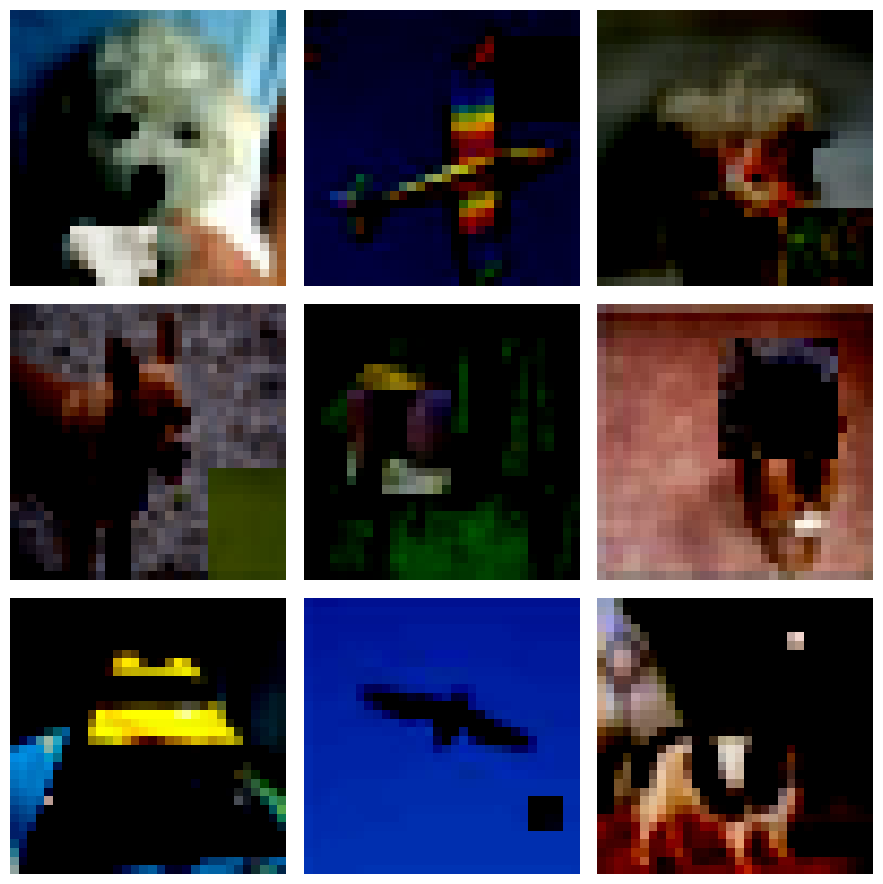

In [75]:
x_train_cutmix = np.array(x_train_cutmix)
num_images_to_show = 9
images_to_show = x_train_cutmix[:num_images_to_show]
fig, axes = plt.subplots(3, 3, figsize=(9, 9))  
axes = axes.flatten()

for img, ax in zip(images_to_show, axes):
    ax.imshow(img)
    ax.axis('off') 

plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- cutmix can be seen in the images

</div>

In [76]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

Epoch 1/100
770/774 [============================>.] - ETA: 0s - d_real_loss: 0.5904 - d_fake_loss: 0.6936 - g_loss: 0.8645 - d_acc: 0.5887 - d_realO: 0.4667 - d_fakeO: 0.5125

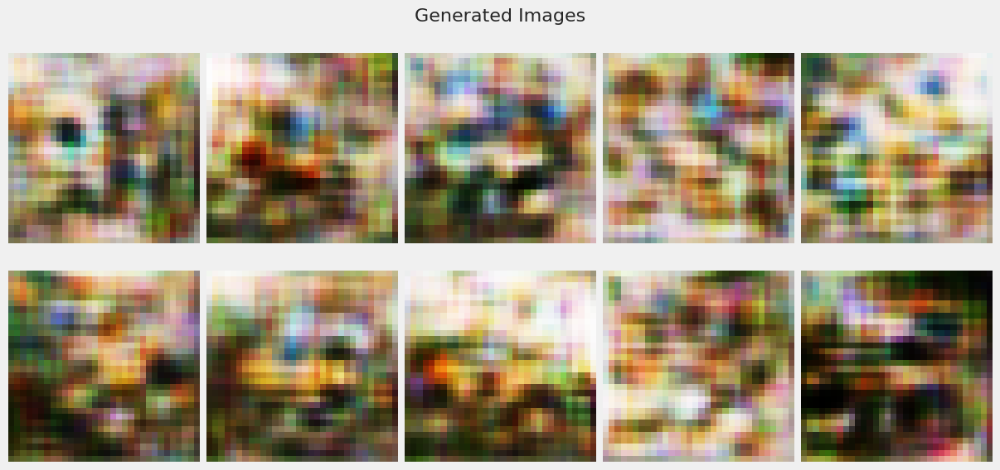

774/774 [==============================] - 11s 13ms/step - d_real_loss: 0.5908 - d_fake_loss: 0.6935 - g_loss: 0.8641 - d_acc: 0.5883 - d_realO: 0.4670 - d_fakeO: 0.5125
Epoch 2/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.7111 - d_fake_loss: 0.6851 - g_loss: 0.7262 - d_acc: 0.4801 - d_realO: 0.5044 - d_fakeO: 0.5041
Epoch 3/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6743 - d_fake_loss: 0.6804 - g_loss: 0.7531 - d_acc: 0.5884 - d_realO: 0.4763 - d_fakeO: 0.5181
Epoch 4/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6589 - d_fake_loss: 0.6715 - g_loss: 0.8075 - d_acc: 0.5800 - d_realO: 0.4724 - d_fakeO: 0.5215
Epoch 5/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6420 - d_fake_loss: 0.6464 - g_loss: 0.8367 - d_acc: 0.6052 - d_realO: 0.4666 - d_fakeO: 0.5296
Epoch 6/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6682 - d_fake_loss: 0

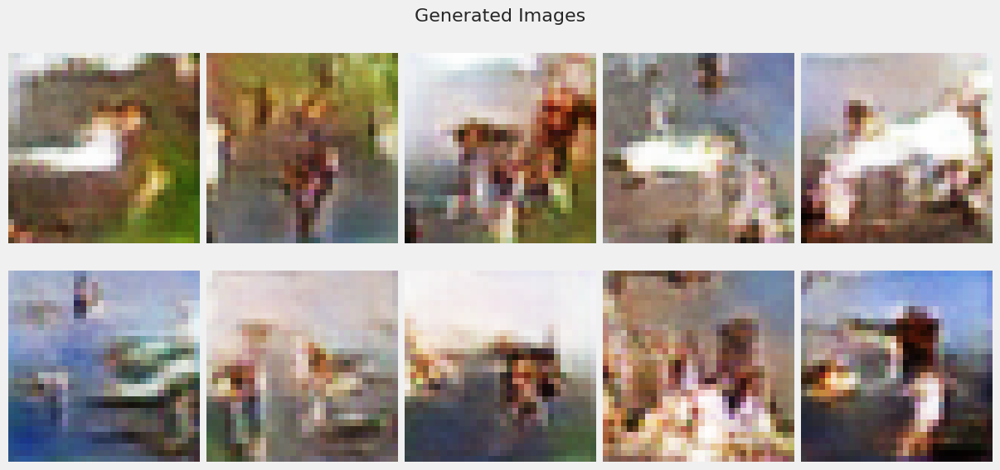

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6716 - d_fake_loss: 0.6572 - g_loss: 0.8281 - d_acc: 0.5903 - d_realO: 0.4802 - d_fakeO: 0.5219
Epoch 12/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6862 - d_fake_loss: 0.6753 - g_loss: 0.8032 - d_acc: 0.5512 - d_realO: 0.4897 - d_fakeO: 0.5113
Epoch 13/100
774/774 [==============================] - 8s 11ms/step - d_real_loss: 0.6966 - d_fake_loss: 0.6858 - g_loss: 0.7804 - d_acc: 0.5205 - d_realO: 0.4935 - d_fakeO: 0.5078
Epoch 14/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6930 - d_fake_loss: 0.6847 - g_loss: 0.7716 - d_acc: 0.5233 - d_realO: 0.4930 - d_fakeO: 0.5081
Epoch 15/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6908 - d_fake_loss: 0.6818 - g_loss: 0.7778 - d_acc: 0.5294 - d_realO: 0.4939 - d_fakeO: 0.5080
Epoch 16/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6941 - d_fake_

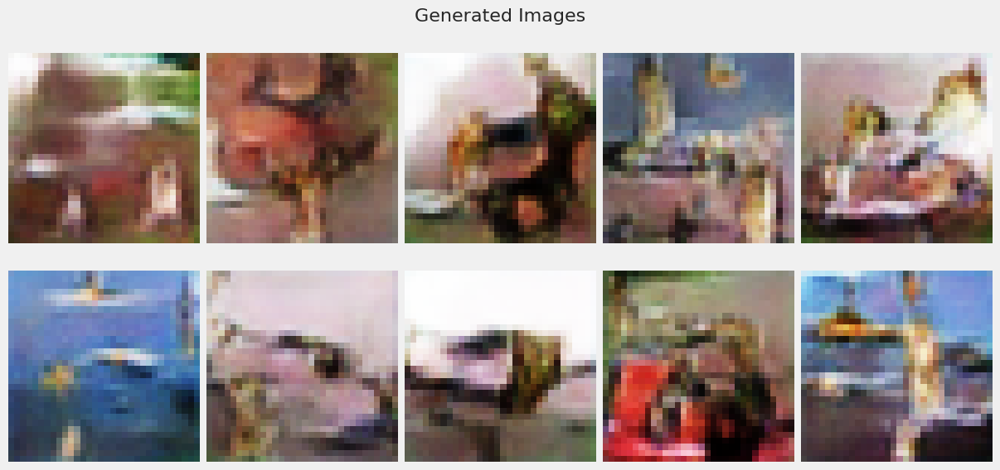

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6911 - d_fake_loss: 0.6849 - g_loss: 0.7566 - d_acc: 0.5284 - d_realO: 0.4957 - d_fakeO: 0.5062
Epoch 22/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6910 - d_fake_loss: 0.6849 - g_loss: 0.7576 - d_acc: 0.5272 - d_realO: 0.4955 - d_fakeO: 0.5067
Epoch 23/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6854 - g_loss: 0.7521 - d_acc: 0.5306 - d_realO: 0.4956 - d_fakeO: 0.5061
Epoch 24/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6918 - d_fake_loss: 0.6858 - g_loss: 0.7562 - d_acc: 0.5265 - d_realO: 0.4945 - d_fakeO: 0.5071
Epoch 25/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6907 - d_fake_loss: 0.6835 - g_loss: 0.7531 - d_acc: 0.5324 - d_realO: 0.4954 - d_fakeO: 0.5067
Epoch 26/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6892 - d_fake_

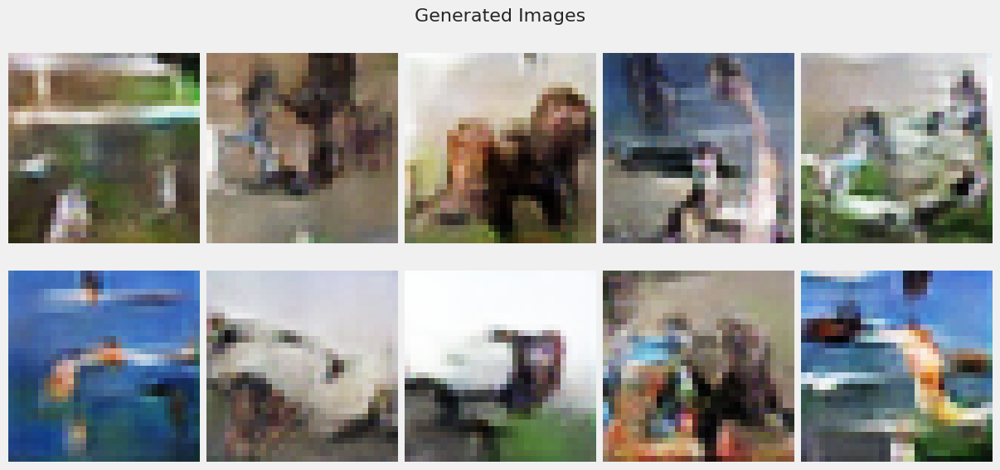

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6847 - d_fake_loss: 0.6784 - g_loss: 0.7643 - d_acc: 0.5551 - d_realO: 0.4916 - d_fakeO: 0.5099
Epoch 32/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6823 - d_fake_loss: 0.6754 - g_loss: 0.7733 - d_acc: 0.5645 - d_realO: 0.4901 - d_fakeO: 0.5108
Epoch 33/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6844 - d_fake_loss: 0.6724 - g_loss: 0.7734 - d_acc: 0.5671 - d_realO: 0.4912 - d_fakeO: 0.5111
Epoch 34/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6834 - d_fake_loss: 0.6758 - g_loss: 0.7734 - d_acc: 0.5587 - d_realO: 0.4905 - d_fakeO: 0.5113
Epoch 35/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6802 - d_fake_loss: 0.6757 - g_loss: 0.7747 - d_acc: 0.5645 - d_realO: 0.4896 - d_fakeO: 0.5116
Epoch 36/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6794 - d_fake_l

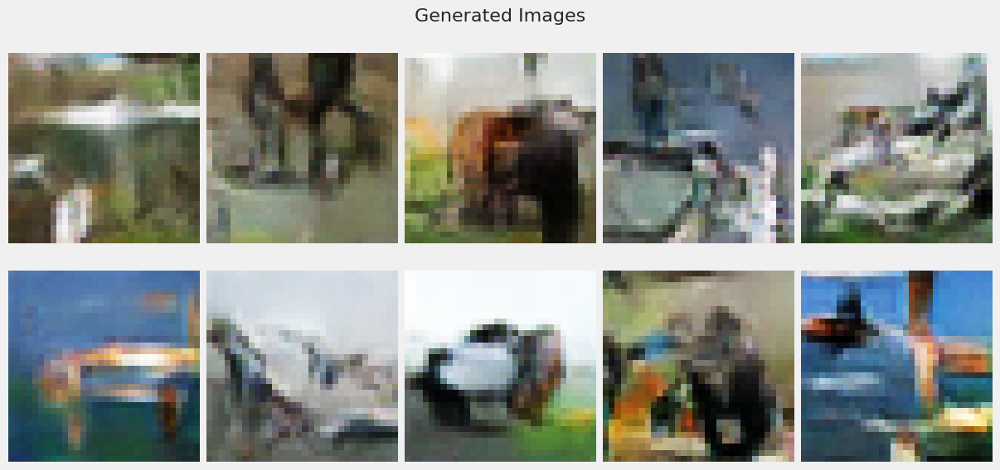

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6749 - d_fake_loss: 0.6674 - g_loss: 0.7896 - d_acc: 0.5864 - d_realO: 0.4848 - d_fakeO: 0.5163
Epoch 42/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6733 - d_fake_loss: 0.6644 - g_loss: 0.7911 - d_acc: 0.5913 - d_realO: 0.4833 - d_fakeO: 0.5177
Epoch 43/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6710 - d_fake_loss: 0.6632 - g_loss: 0.7924 - d_acc: 0.5987 - d_realO: 0.4828 - d_fakeO: 0.5185
Epoch 44/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6701 - d_fake_loss: 0.6619 - g_loss: 0.8027 - d_acc: 0.5981 - d_realO: 0.4822 - d_fakeO: 0.5187
Epoch 45/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6704 - d_fake_loss: 0.6608 - g_loss: 0.8115 - d_acc: 0.5956 - d_realO: 0.4798 - d_fakeO: 0.5209
Epoch 46/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6709 - d_fake_

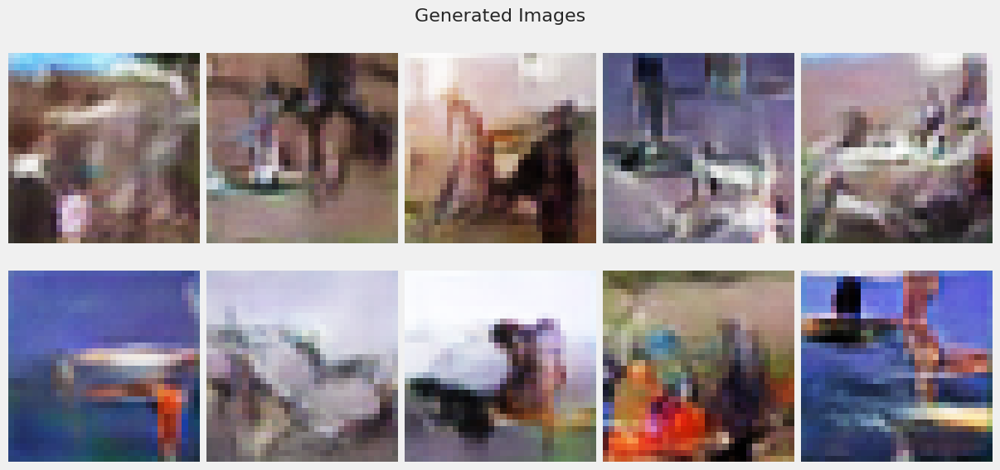

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6620 - d_fake_loss: 0.6508 - g_loss: 0.8328 - d_acc: 0.6180 - d_realO: 0.4745 - d_fakeO: 0.5266
Epoch 52/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6618 - d_fake_loss: 0.6492 - g_loss: 0.8276 - d_acc: 0.6218 - d_realO: 0.4747 - d_fakeO: 0.5263
Epoch 53/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6614 - d_fake_loss: 0.6479 - g_loss: 0.8297 - d_acc: 0.6226 - d_realO: 0.4730 - d_fakeO: 0.5277
Epoch 54/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6608 - d_fake_loss: 0.6461 - g_loss: 0.8445 - d_acc: 0.6223 - d_realO: 0.4729 - d_fakeO: 0.5284
Epoch 55/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6623 - d_fake_loss: 0.6475 - g_loss: 0.8361 - d_acc: 0.6205 - d_realO: 0.4731 - d_fakeO: 0.5283
Epoch 56/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6593 - d_fake_

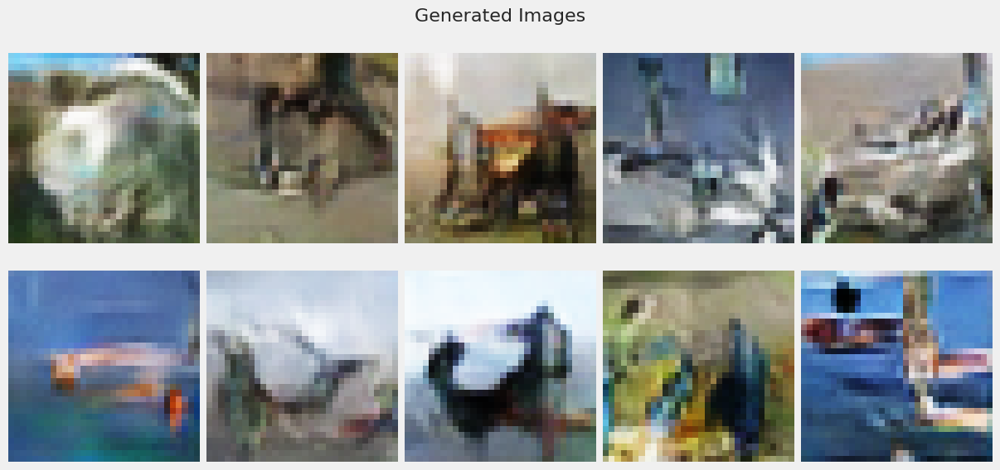

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6593 - d_fake_loss: 0.6387 - g_loss: 0.8600 - d_acc: 0.6278 - d_realO: 0.4665 - d_fakeO: 0.5346
Epoch 62/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6614 - d_fake_loss: 0.6401 - g_loss: 0.8576 - d_acc: 0.6238 - d_realO: 0.4687 - d_fakeO: 0.5326
Epoch 63/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6561 - d_fake_loss: 0.6378 - g_loss: 0.8625 - d_acc: 0.6326 - d_realO: 0.4657 - d_fakeO: 0.5350
Epoch 64/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6538 - d_fake_loss: 0.6323 - g_loss: 0.8761 - d_acc: 0.6382 - d_realO: 0.4635 - d_fakeO: 0.5374
Epoch 65/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6561 - d_fake_loss: 0.6328 - g_loss: 0.8790 - d_acc: 0.6344 - d_realO: 0.4648 - d_fakeO: 0.5366
Epoch 66/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6543 - d_fake_lo

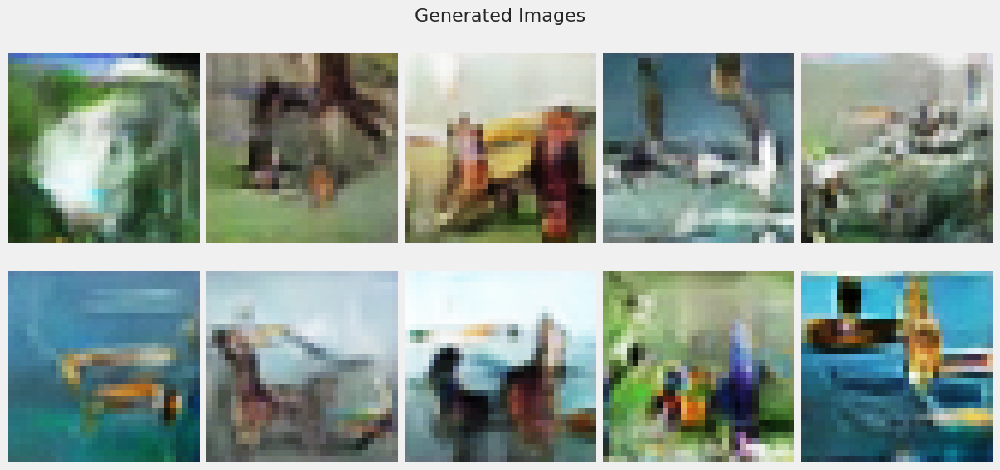

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6491 - d_fake_loss: 0.6224 - g_loss: 0.8925 - d_acc: 0.6486 - d_realO: 0.4592 - d_fakeO: 0.5418
Epoch 72/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6511 - d_fake_loss: 0.6267 - g_loss: 0.8985 - d_acc: 0.6401 - d_realO: 0.4587 - d_fakeO: 0.5419
Epoch 73/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6496 - d_fake_loss: 0.6242 - g_loss: 0.8969 - d_acc: 0.6453 - d_realO: 0.4587 - d_fakeO: 0.5417
Epoch 74/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6420 - d_fake_loss: 0.6173 - g_loss: 0.9149 - d_acc: 0.6562 - d_realO: 0.4565 - d_fakeO: 0.5444
Epoch 75/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6456 - d_fake_loss: 0.6217 - g_loss: 0.8983 - d_acc: 0.6505 - d_realO: 0.4554 - d_fakeO: 0.5450
Epoch 76/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6457 - d_fake_

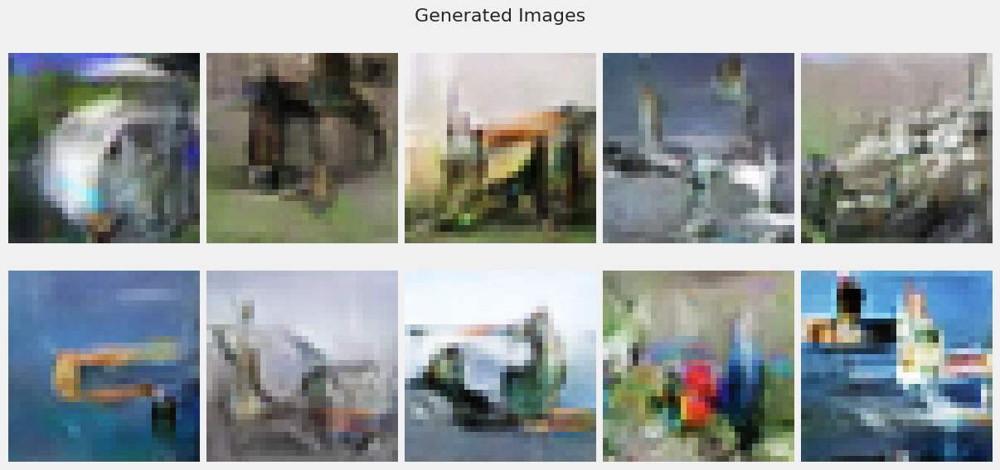

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6390 - d_fake_loss: 0.6130 - g_loss: 0.9306 - d_acc: 0.6600 - d_realO: 0.4500 - d_fakeO: 0.5505
Epoch 82/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6396 - d_fake_loss: 0.6133 - g_loss: 0.9204 - d_acc: 0.6590 - d_realO: 0.4497 - d_fakeO: 0.5505
Epoch 83/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6377 - d_fake_loss: 0.6100 - g_loss: 0.9391 - d_acc: 0.6599 - d_realO: 0.4485 - d_fakeO: 0.5521
Epoch 84/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6373 - d_fake_loss: 0.6093 - g_loss: 0.9510 - d_acc: 0.6628 - d_realO: 0.4469 - d_fakeO: 0.5535
Epoch 85/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6387 - d_fake_loss: 0.6069 - g_loss: 0.9380 - d_acc: 0.6643 - d_realO: 0.4450 - d_fakeO: 0.5552
Epoch 86/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6372 - d_fake_l

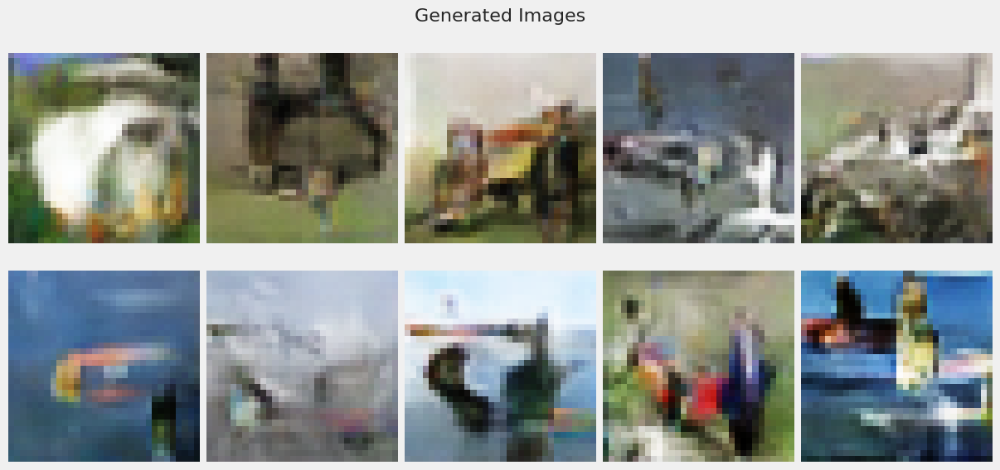

774/774 [==============================] - 10s 13ms/step - d_real_loss: 0.6368 - d_fake_loss: 0.6021 - g_loss: 0.9571 - d_acc: 0.6698 - d_realO: 0.4435 - d_fakeO: 0.5571
Epoch 92/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6310 - d_fake_loss: 0.5956 - g_loss: 0.9708 - d_acc: 0.6746 - d_realO: 0.4405 - d_fakeO: 0.5602
Epoch 93/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6299 - d_fake_loss: 0.5990 - g_loss: 0.9778 - d_acc: 0.6717 - d_realO: 0.4403 - d_fakeO: 0.5603
Epoch 94/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6351 - d_fake_loss: 0.6036 - g_loss: 0.9687 - d_acc: 0.6634 - d_realO: 0.4429 - d_fakeO: 0.5576
Epoch 95/100
774/774 [==============================] - 10s 12ms/step - d_real_loss: 0.6292 - d_fake_loss: 0.5970 - g_loss: 0.9713 - d_acc: 0.6764 - d_realO: 0.4401 - d_fakeO: 0.5605
Epoch 96/100
774/774 [==============================] - 9s 12ms/step - d_real_loss: 0.6282 - d_fake_

In [77]:
gan_4 = DCGAN_CUTMIX(discriminator=discriminator_dcgan3,generator=generator_dcgan3,latent_dim=128,model_name='CUTMIX DCGAN-3')
gan_4.compile(d_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),g_optimizer=tf.keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),loss_fn=tf.keras.losses.BinaryCrossentropy(),)
gan_history_4 = gan_4.fit(dataset,epochs=100,use_multiprocessing=True,workers=16,callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  60% accuracy
- No model collapse


</div>

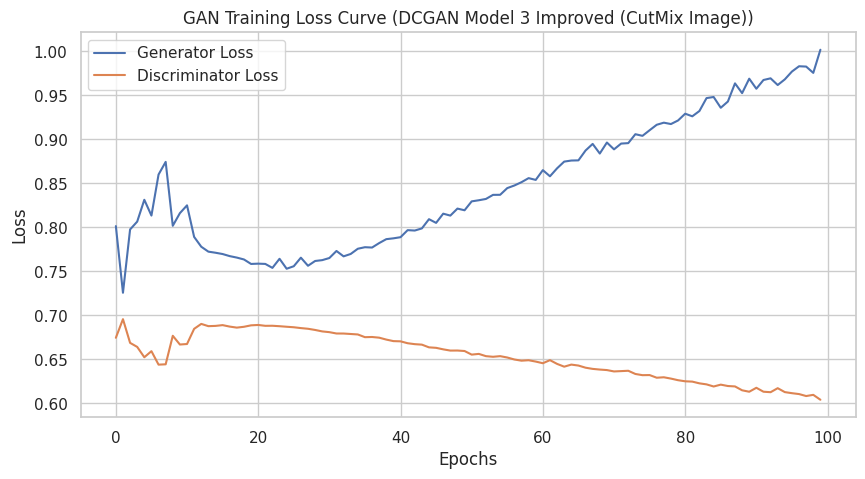

In [78]:
gan_history_4 = gan_4.history.history
generator = gan_4.generator  
gan_history_4['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4['d_real_loss'], gan_history_4['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4, title='GAN Training Loss Curve (DCGAN Model 3 Improved (CutMix Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [79]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 2ms/step
FID Score: 51.56449295035611
KID Score: 0.034892278799125265


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 51
- KID Score is 0.03

</div>

2/2 [==============================] - 0s 16ms/step


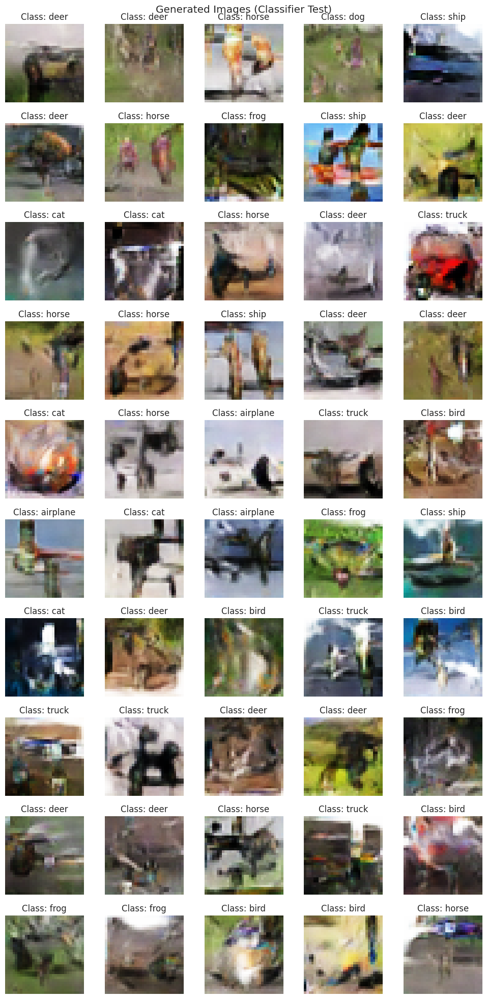

In [80]:
latent_dim = 128 
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>
- Image quality is able to tell only some of the class
</div>

4/4 [==============================] - 0s 3ms/step


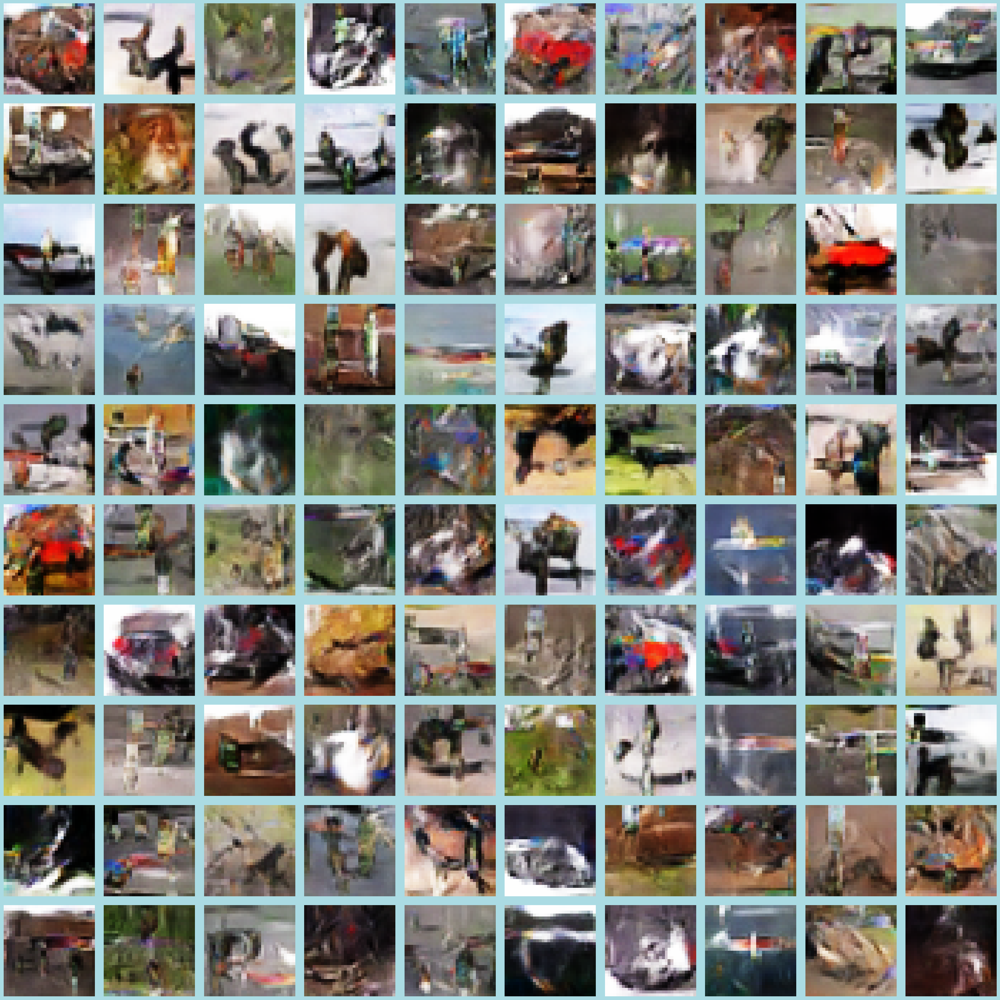

4/4 [==============================] - 0s 2ms/step


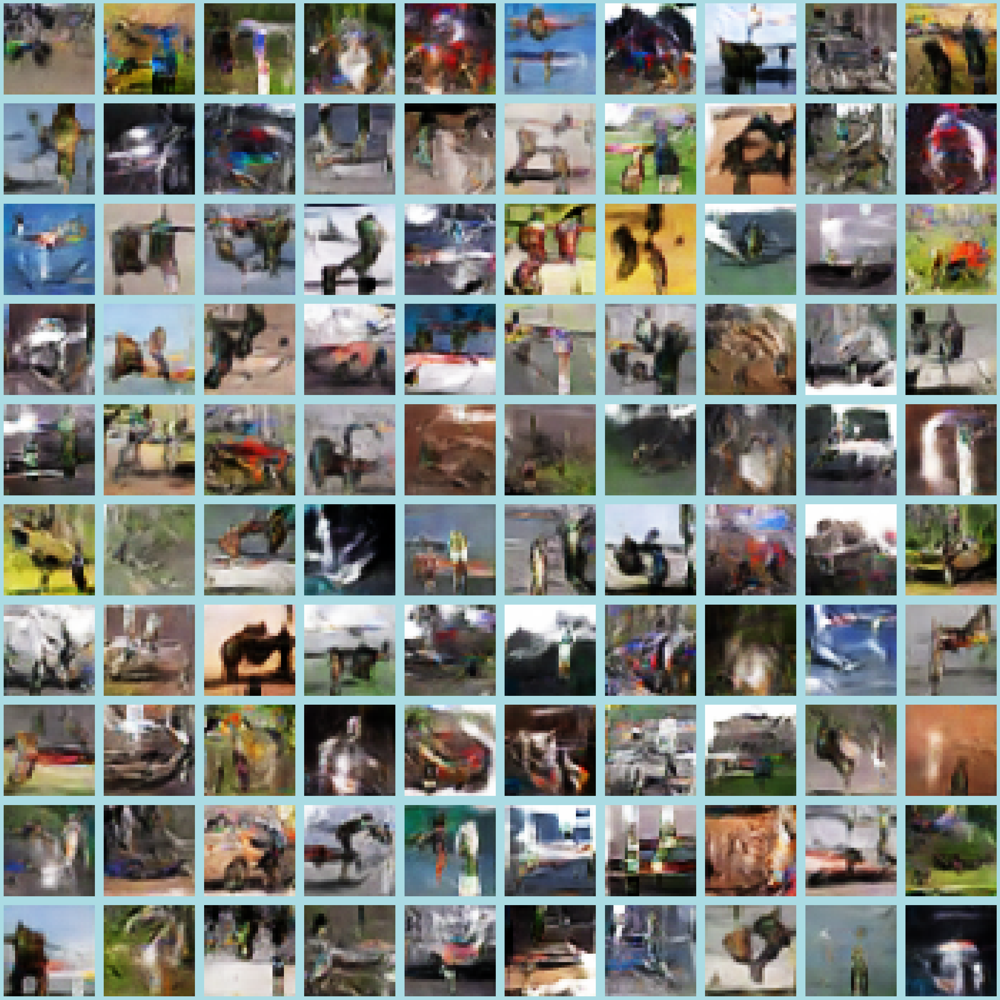

4/4 [==============================] - 0s 2ms/step


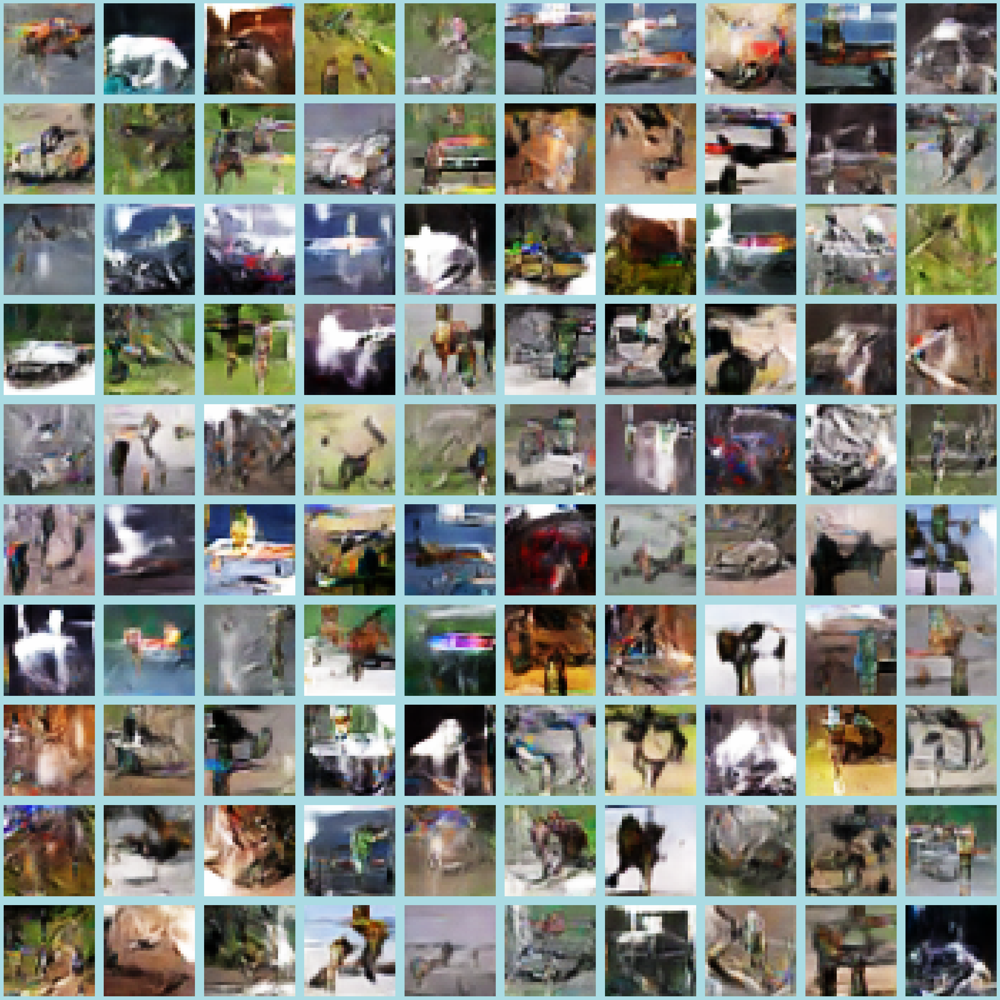

4/4 [==============================] - 0s 3ms/step


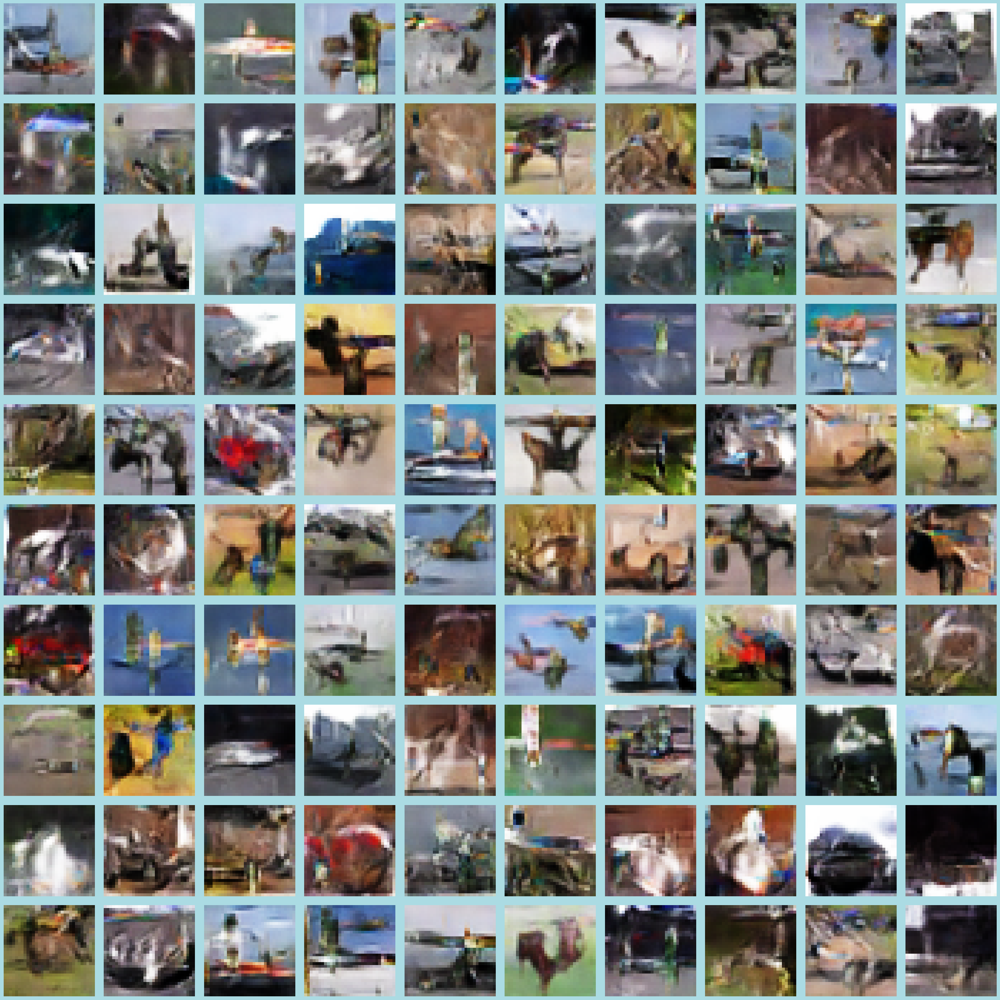

4/4 [==============================] - 0s 3ms/step


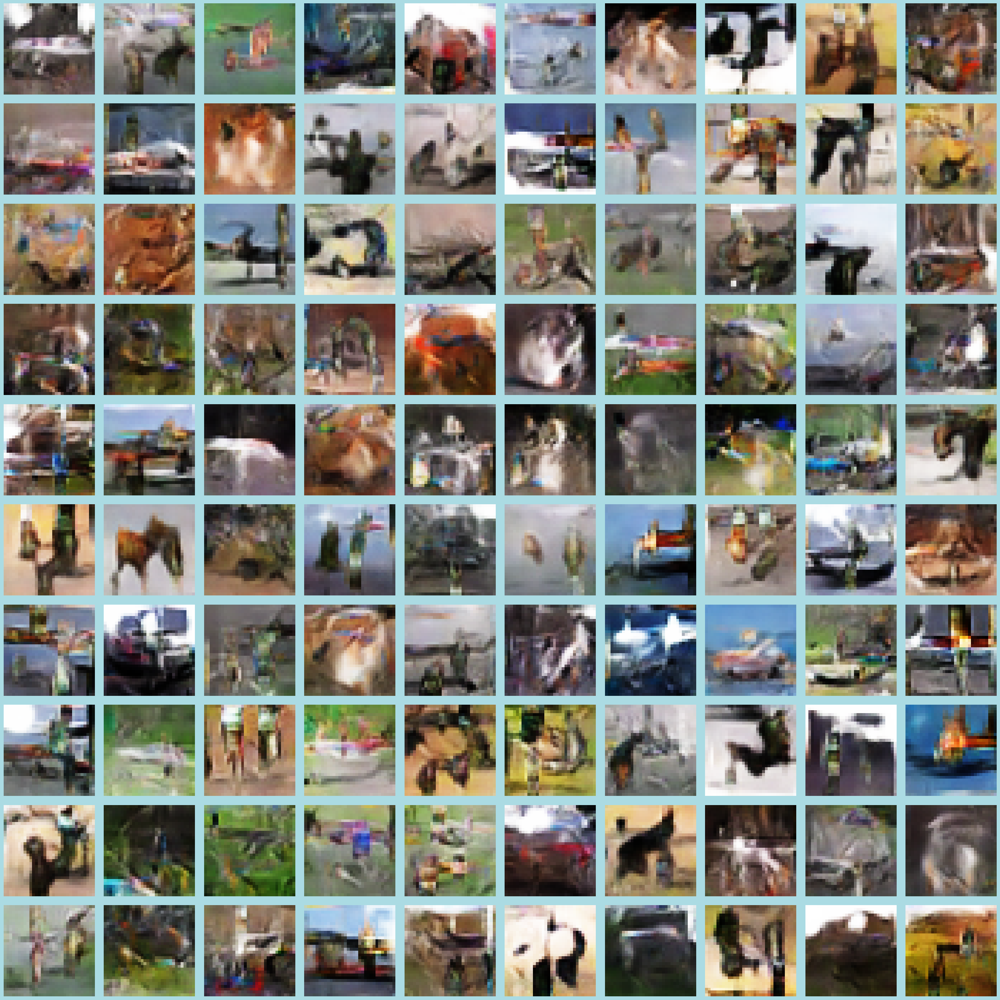

4/4 [==============================] - 0s 3ms/step


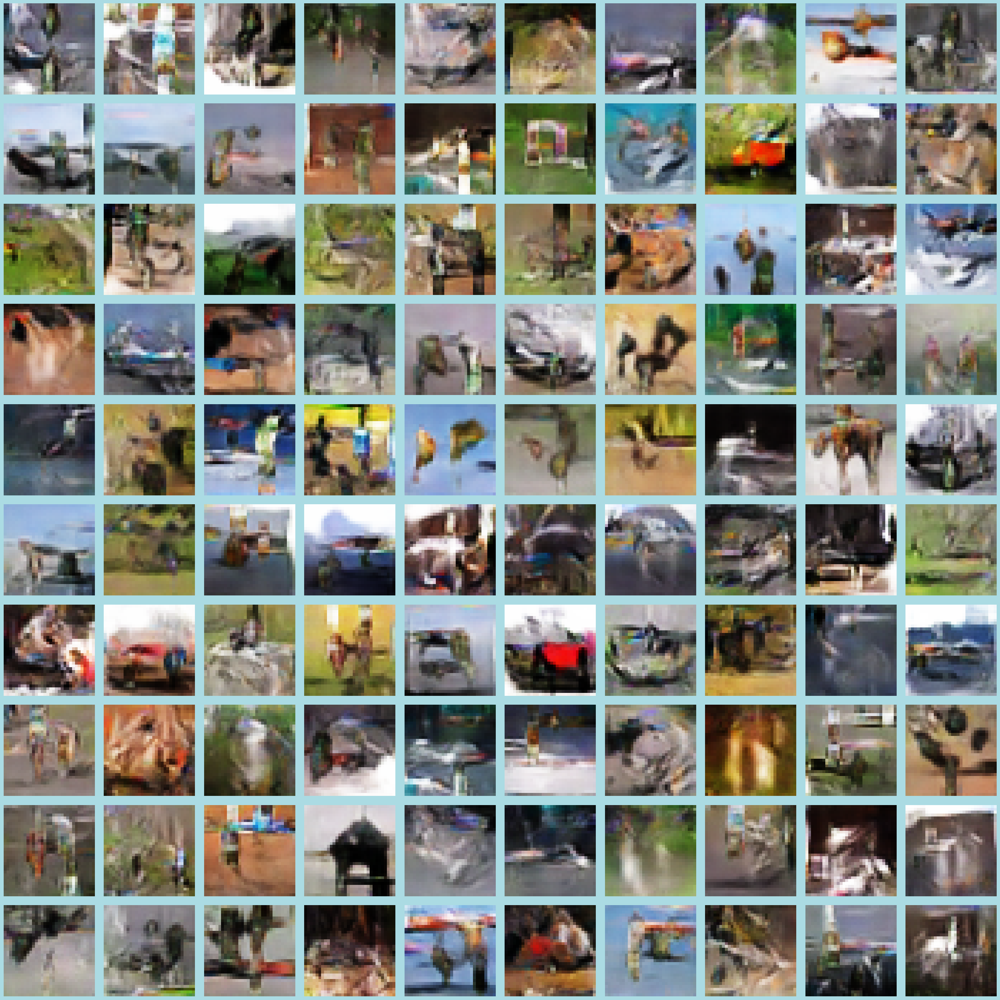

4/4 [==============================] - 0s 2ms/step


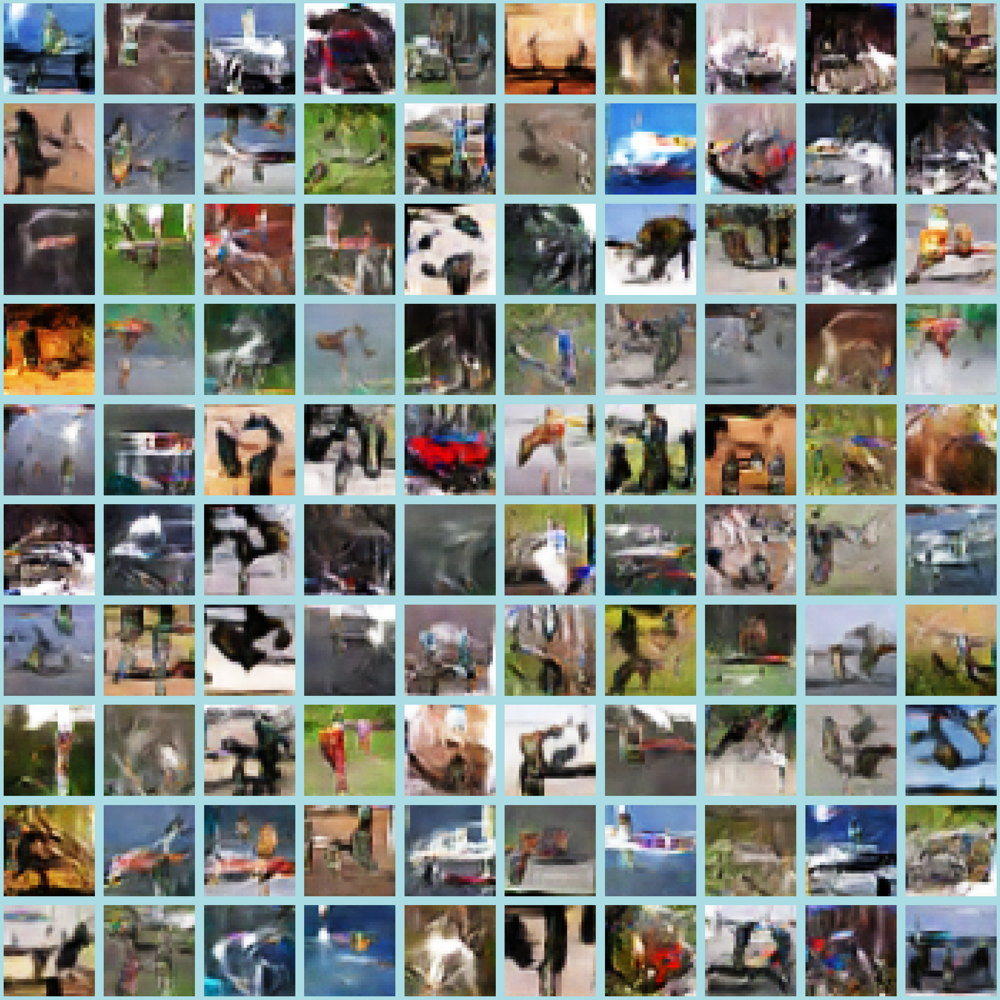

4/4 [==============================] - 0s 2ms/step


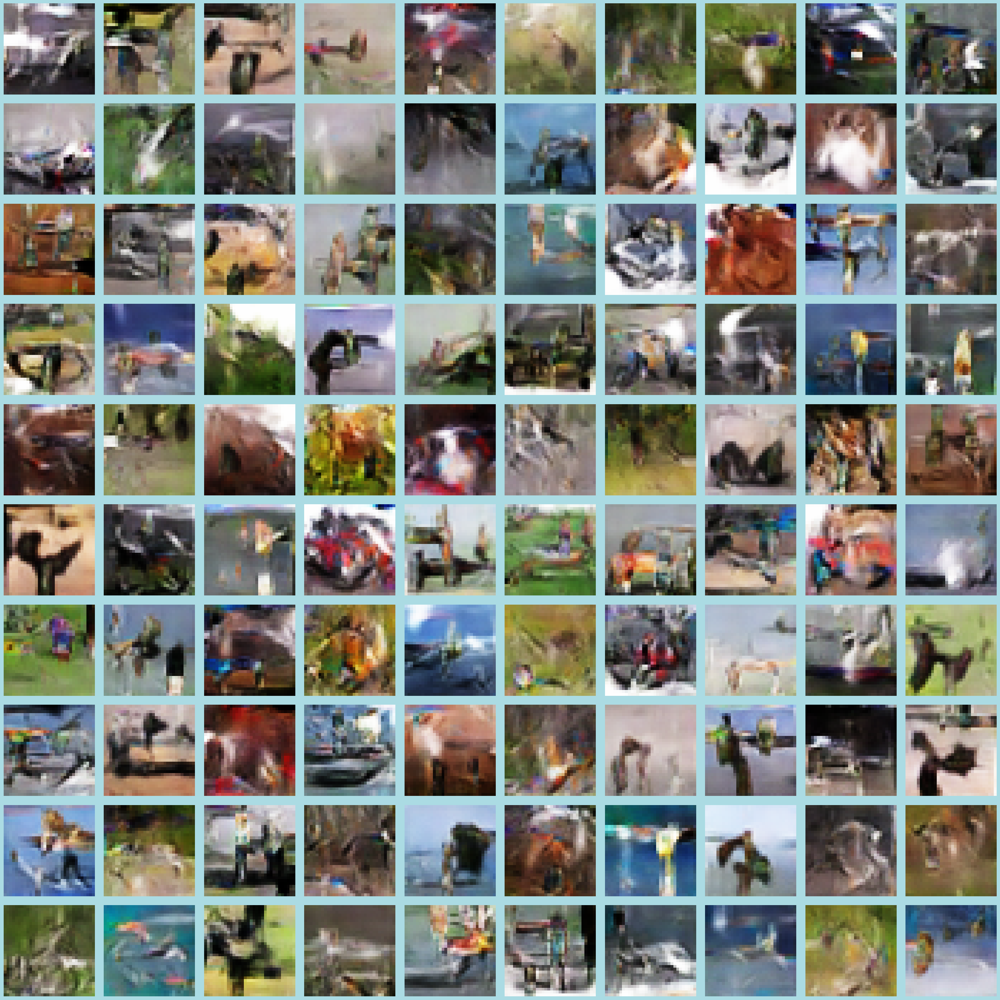

4/4 [==============================] - 0s 3ms/step


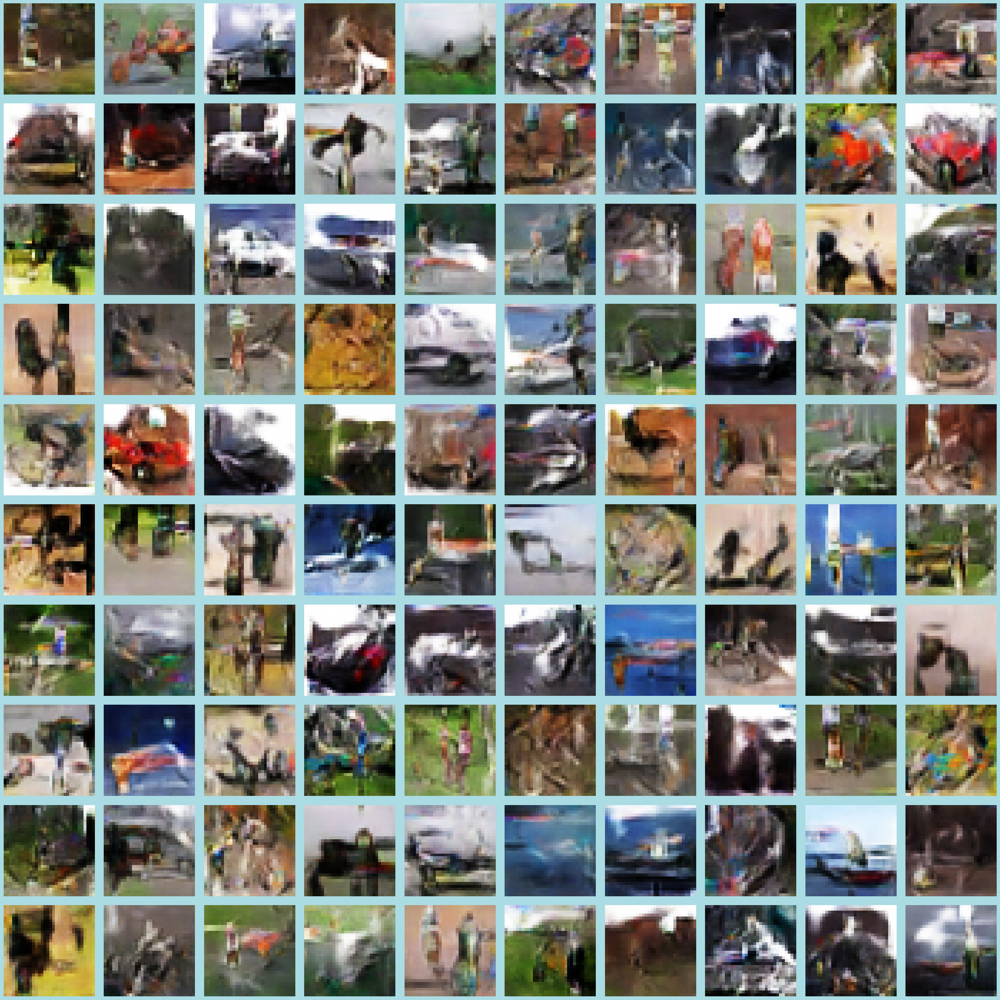

4/4 [==============================] - 0s 1ms/step


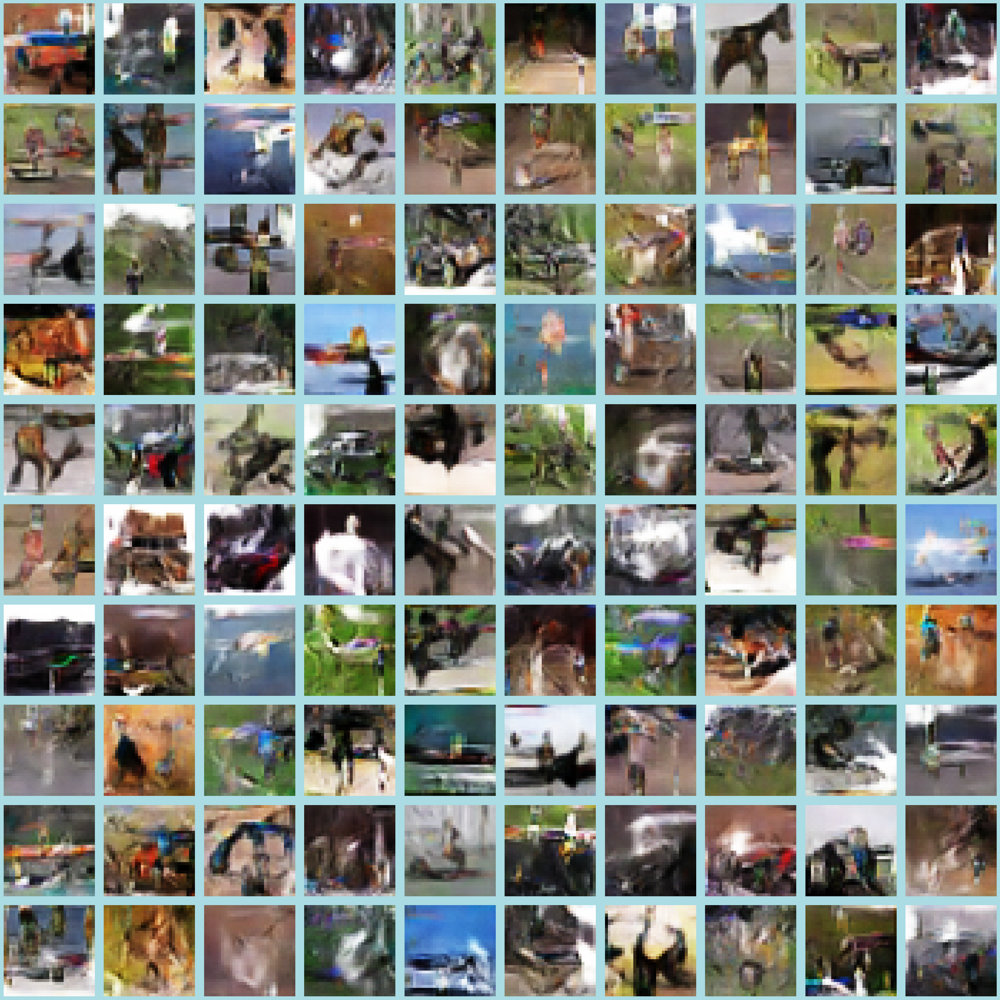

In [81]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>
- Image quality is similar to that of classifier
</div>

#### Storing the scores

In [82]:
new_row = {'Model':'CutMix DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_3['d_loss'][-1], 'g_loss':gan_history_3['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,2.945318e-02,0.686637,0.746695
1,Sharpened Image DCGAN 3,680163.777727,3.370699e+07,0.684277,0.750914
2,Improved Data Generator DCGAN 3,700665.890898,3.764938e+07,0.689118,0.726457
3,CutMix DCGAN 3,51.564493,3.489228e-02,0.686637,0.746695


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Feature Engineering (Oversampiling))__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">



## __Key Ideas__

1. The idea here is to oversample the dataset that we have
2. The goal is to generate more dataset to be able to have more data to put into training for ga.
3. Resample from sklearn was used to oversample the data here
4. The process was first done on the train data


In [83]:
from sklearn.utils import resample
(x_train, y_train), (x_test, y_test) = cifar10.load_data()
x_train, x_test = x_train / 127.5 - 1, x_test / 127.5 - 1
train_data = [(x, y) for x, y in zip(x_train, y_train)]

max_samples = 10000  
oversampled_train_data = []
for class_index in range(10):  
    class_data = [data for data in train_data if data[1] == class_index]
    oversampled_class_data = resample(class_data, replace=True, n_samples=max_samples, random_state=123)
    oversampled_train_data.extend(oversampled_class_data)

x_train_oversampled, y_train_oversampled = zip(*oversampled_train_data)
x_train_oversampled, y_train_oversampled = np.array(x_train_oversampled), np.array(y_train_oversampled)


#### Creating Checkpoint

In [84]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='Oversample DCGAN3')]

#### Training

In [85]:
len(x_train_oversampled)

100000

In [86]:
dataset = tf.data.Dataset.from_tensor_slices(x_train_oversampled)
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [87]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

Epoch 1/90
1563/1563 [==============================] - ETA: 0s - d_real_loss: 0.6290 - d_fake_loss: 0.7169 - g_loss: 0.7617 - d_acc: 0.5374 - d_realO: 0.4863 - d_fakeO: 0.5012

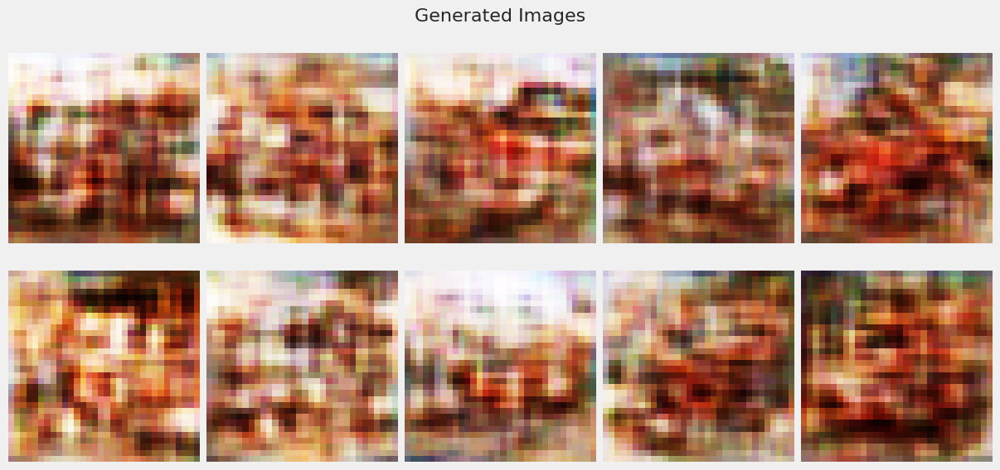

1563/1563 [==============================] - 19s 12ms/step - d_real_loss: 0.6290 - d_fake_loss: 0.7169 - g_loss: 0.7617 - d_acc: 0.5374 - d_realO: 0.4863 - d_fakeO: 0.5012
Epoch 2/90
1563/1563 [==============================] - 16s 11ms/step - d_real_loss: 0.6803 - d_fake_loss: 0.6687 - g_loss: 0.7854 - d_acc: 0.5729 - d_realO: 0.4766 - d_fakeO: 0.5188
Epoch 3/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6318 - d_fake_loss: 0.6340 - g_loss: 0.9070 - d_acc: 0.6375 - d_realO: 0.4682 - d_fakeO: 0.5279
Epoch 4/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6632 - d_fake_loss: 0.6657 - g_loss: 0.8039 - d_acc: 0.5897 - d_realO: 0.4804 - d_fakeO: 0.5149
Epoch 5/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6780 - d_fake_loss: 0.6663 - g_loss: 0.7945 - d_acc: 0.5675 - d_realO: 0.4894 - d_fakeO: 0.5110
Epoch 6/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6705 - d_

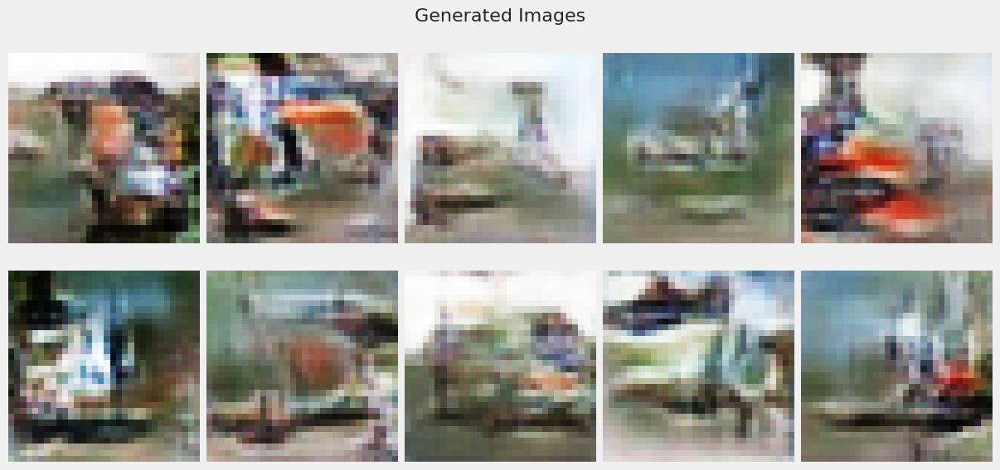

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.6823 - d_fake_loss: 0.6750 - g_loss: 0.7828 - d_acc: 0.5450 - d_realO: 0.4934 - d_fakeO: 0.5074
Epoch 12/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6815 - d_fake_loss: 0.6754 - g_loss: 0.7832 - d_acc: 0.5460 - d_realO: 0.4931 - d_fakeO: 0.5077
Epoch 13/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6802 - d_fake_loss: 0.6733 - g_loss: 0.7877 - d_acc: 0.5523 - d_realO: 0.4926 - d_fakeO: 0.5081
Epoch 14/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6777 - d_fake_loss: 0.6713 - g_loss: 0.7839 - d_acc: 0.5574 - d_realO: 0.4920 - d_fakeO: 0.5083
Epoch 15/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6782 - d_fake_loss: 0.6702 - g_loss: 0.7920 - d_acc: 0.5610 - d_realO: 0.4908 - d_fakeO: 0.5099
Epoch 16/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6749

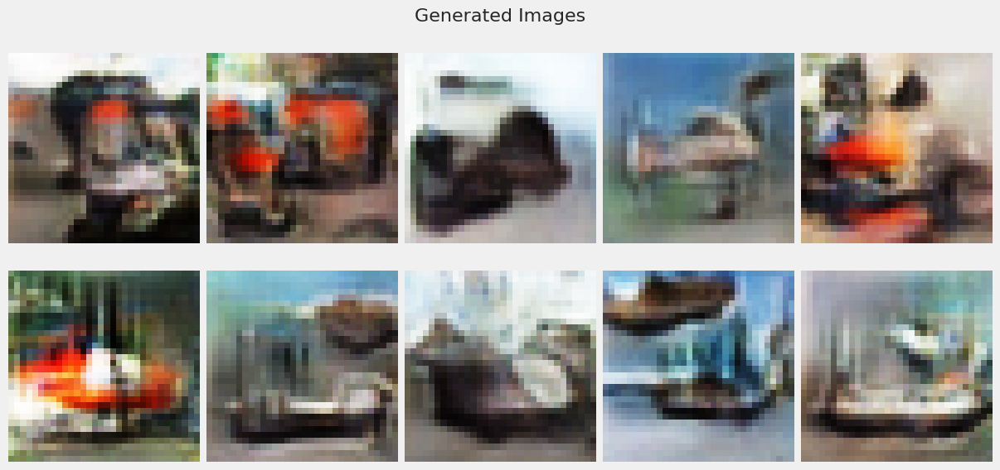

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.6722 - d_fake_loss: 0.6661 - g_loss: 0.8044 - d_acc: 0.5730 - d_realO: 0.4881 - d_fakeO: 0.5119
Epoch 22/90
1563/1563 [==============================] - 16s 10ms/step - d_real_loss: 0.6734 - d_fake_loss: 0.6674 - g_loss: 0.8039 - d_acc: 0.5725 - d_realO: 0.4886 - d_fakeO: 0.5115
Epoch 23/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6731 - d_fake_loss: 0.6678 - g_loss: 0.8027 - d_acc: 0.5725 - d_realO: 0.4887 - d_fakeO: 0.5112
Epoch 24/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6715 - d_fake_loss: 0.6649 - g_loss: 0.8109 - d_acc: 0.5757 - d_realO: 0.4878 - d_fakeO: 0.5122
Epoch 25/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6742 - d_fake_loss: 0.6656 - g_loss: 0.8042 - d_acc: 0.5726 - d_realO: 0.4890 - d_fakeO: 0.5117
Epoch 26/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6719

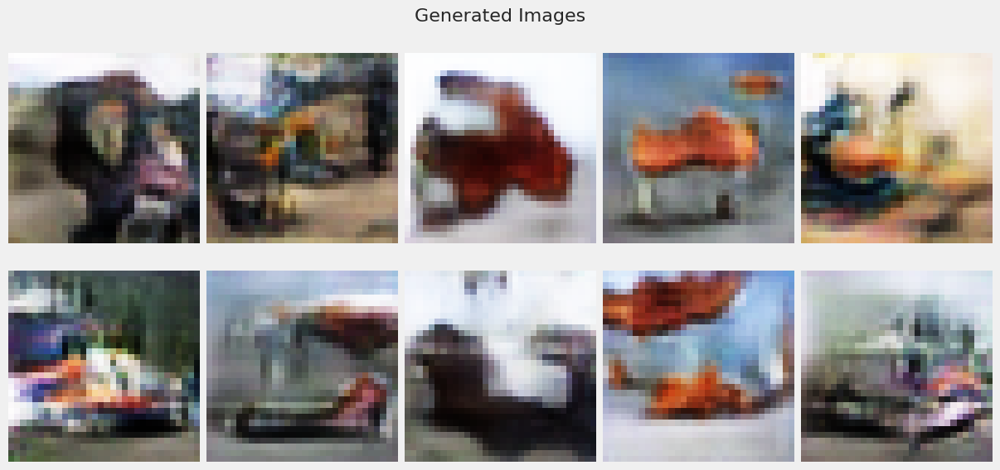

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.6710 - d_fake_loss: 0.6622 - g_loss: 0.8086 - d_acc: 0.5808 - d_realO: 0.4871 - d_fakeO: 0.5132
Epoch 32/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6697 - d_fake_loss: 0.6621 - g_loss: 0.8109 - d_acc: 0.5798 - d_realO: 0.4872 - d_fakeO: 0.5131
Epoch 33/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6703 - d_fake_loss: 0.6623 - g_loss: 0.8123 - d_acc: 0.5758 - d_realO: 0.4876 - d_fakeO: 0.5127
Epoch 34/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6696 - d_fake_loss: 0.6619 - g_loss: 0.8143 - d_acc: 0.5787 - d_realO: 0.4866 - d_fakeO: 0.5134
Epoch 35/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6678 - d_fake_loss: 0.6591 - g_loss: 0.8163 - d_acc: 0.5841 - d_realO: 0.4858 - d_fakeO: 0.5141
Epoch 36/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6664

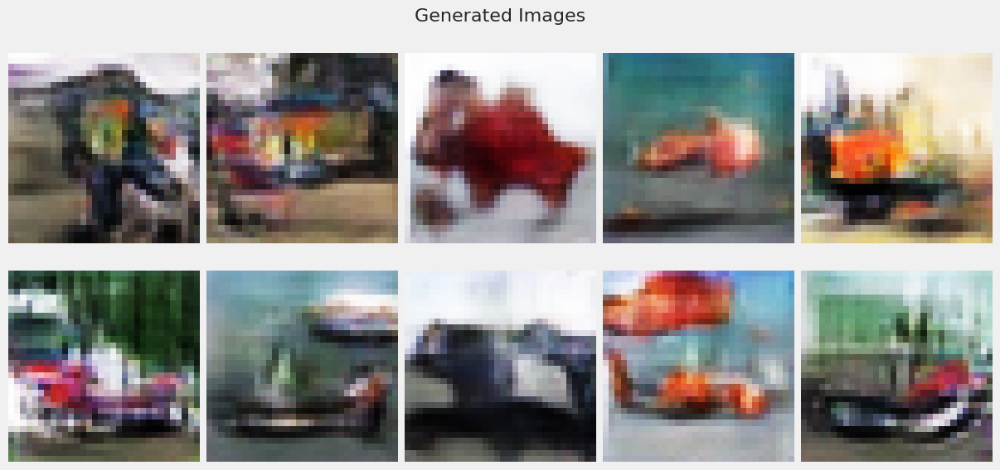

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.6648 - d_fake_loss: 0.6536 - g_loss: 0.8318 - d_acc: 0.5911 - d_realO: 0.4839 - d_fakeO: 0.5164
Epoch 42/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6644 - d_fake_loss: 0.6536 - g_loss: 0.8345 - d_acc: 0.5923 - d_realO: 0.4835 - d_fakeO: 0.5168
Epoch 43/90
1563/1563 [==============================] - 16s 10ms/step - d_real_loss: 0.6640 - d_fake_loss: 0.6521 - g_loss: 0.8360 - d_acc: 0.5938 - d_realO: 0.4834 - d_fakeO: 0.5170
Epoch 44/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6627 - d_fake_loss: 0.6519 - g_loss: 0.8384 - d_acc: 0.5947 - d_realO: 0.4830 - d_fakeO: 0.5174
Epoch 45/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6603 - d_fake_loss: 0.6485 - g_loss: 0.8451 - d_acc: 0.6014 - d_realO: 0.4819 - d_fakeO: 0.5184
Epoch 46/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6598

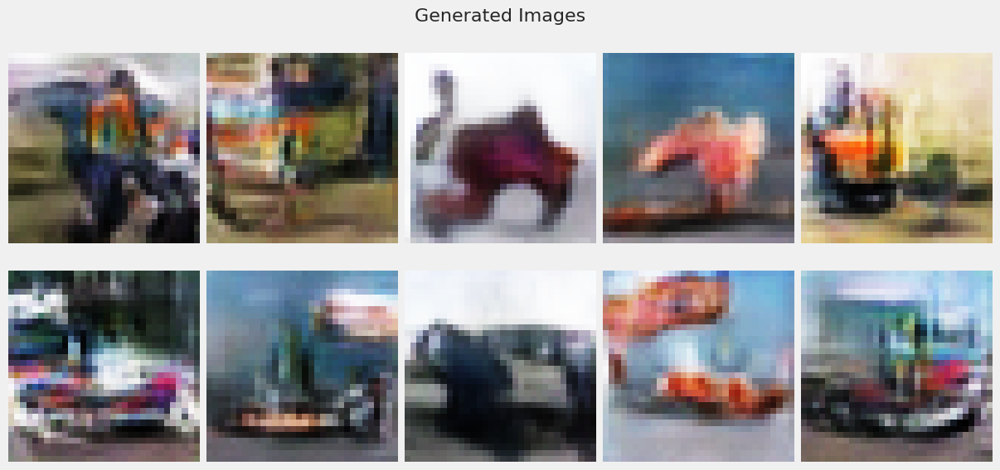

1563/1563 [==============================] - 18s 12ms/step - d_real_loss: 0.6556 - d_fake_loss: 0.6420 - g_loss: 0.8650 - d_acc: 0.6076 - d_realO: 0.4792 - d_fakeO: 0.5209
Epoch 52/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6583 - d_fake_loss: 0.6435 - g_loss: 0.8632 - d_acc: 0.6052 - d_realO: 0.4795 - d_fakeO: 0.5213
Epoch 53/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6556 - d_fake_loss: 0.6412 - g_loss: 0.8668 - d_acc: 0.6067 - d_realO: 0.4782 - d_fakeO: 0.5220
Epoch 54/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6552 - d_fake_loss: 0.6396 - g_loss: 0.8733 - d_acc: 0.6085 - d_realO: 0.4771 - d_fakeO: 0.5232
Epoch 55/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6553 - d_fake_loss: 0.6394 - g_loss: 0.8726 - d_acc: 0.6115 - d_realO: 0.4765 - d_fakeO: 0.5239
Epoch 56/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6540

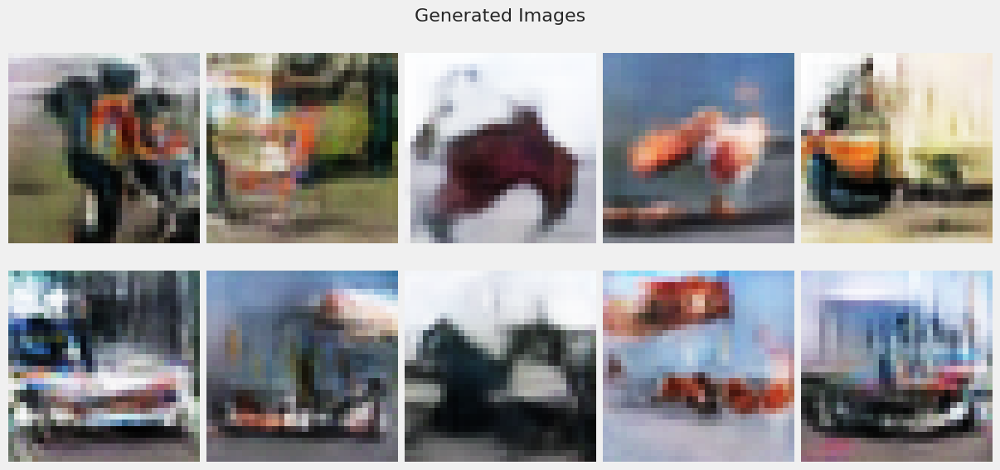

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.6498 - d_fake_loss: 0.6323 - g_loss: 0.8961 - d_acc: 0.6198 - d_realO: 0.4724 - d_fakeO: 0.5280
Epoch 62/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6501 - d_fake_loss: 0.6316 - g_loss: 0.8915 - d_acc: 0.6221 - d_realO: 0.4724 - d_fakeO: 0.5281
Epoch 63/90
1563/1563 [==============================] - 16s 10ms/step - d_real_loss: 0.6493 - d_fake_loss: 0.6308 - g_loss: 0.8983 - d_acc: 0.6212 - d_realO: 0.4719 - d_fakeO: 0.5286
Epoch 64/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6488 - d_fake_loss: 0.6293 - g_loss: 0.9007 - d_acc: 0.6243 - d_realO: 0.4712 - d_fakeO: 0.5290
Epoch 65/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6508 - d_fake_loss: 0.6304 - g_loss: 0.8934 - d_acc: 0.6226 - d_realO: 0.4713 - d_fakeO: 0.5291
Epoch 66/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6498

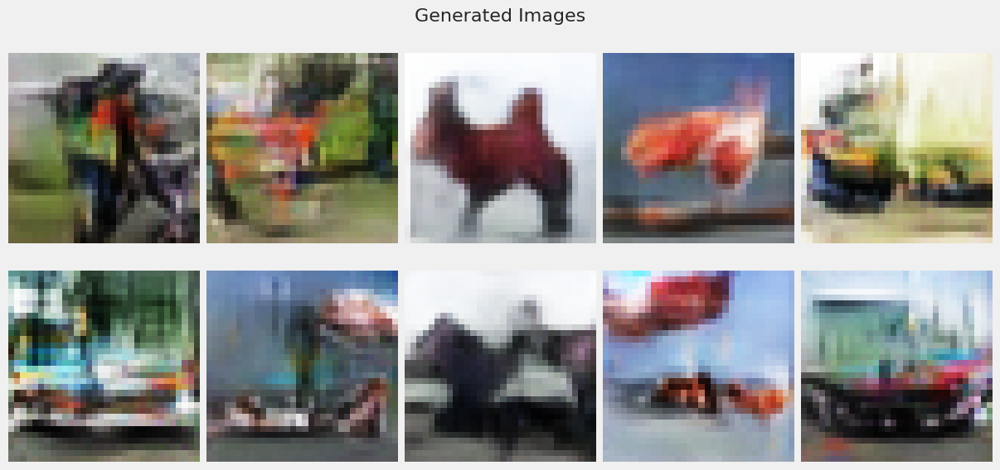

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.6423 - d_fake_loss: 0.6217 - g_loss: 0.9237 - d_acc: 0.6288 - d_realO: 0.4679 - d_fakeO: 0.5323
Epoch 72/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6447 - d_fake_loss: 0.6214 - g_loss: 0.9206 - d_acc: 0.6314 - d_realO: 0.4668 - d_fakeO: 0.5334
Epoch 73/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6442 - d_fake_loss: 0.6218 - g_loss: 0.9287 - d_acc: 0.6283 - d_realO: 0.4675 - d_fakeO: 0.5331
Epoch 74/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6422 - d_fake_loss: 0.6198 - g_loss: 0.9284 - d_acc: 0.6322 - d_realO: 0.4672 - d_fakeO: 0.5333
Epoch 75/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6432 - d_fake_loss: 0.6217 - g_loss: 0.9365 - d_acc: 0.6308 - d_realO: 0.4668 - d_fakeO: 0.5336
Epoch 76/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6438

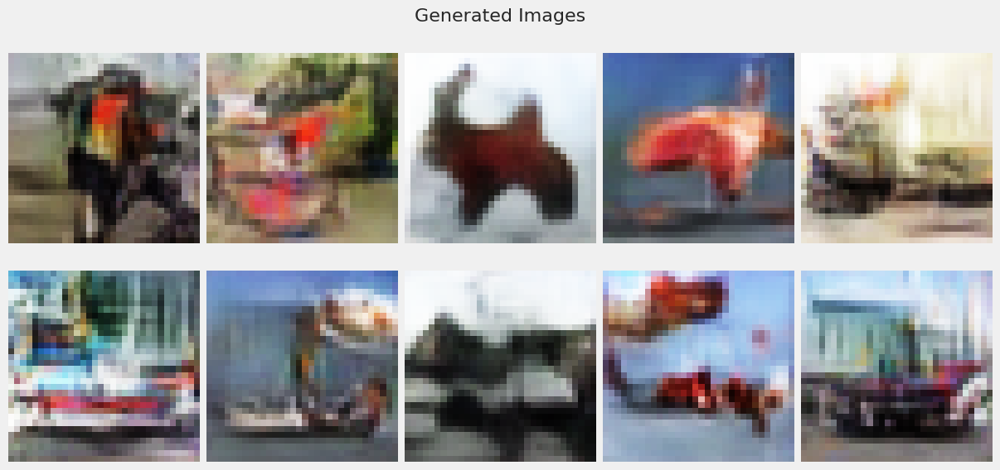

1563/1563 [==============================] - 18s 11ms/step - d_real_loss: 0.6430 - d_fake_loss: 0.6194 - g_loss: 0.9356 - d_acc: 0.6338 - d_realO: 0.4660 - d_fakeO: 0.5345
Epoch 82/90
1563/1563 [==============================] - 17s 11ms/step - d_real_loss: 0.6410 - d_fake_loss: 0.6170 - g_loss: 0.9409 - d_acc: 0.6362 - d_realO: 0.4647 - d_fakeO: 0.5355
Epoch 83/90
1563/1563 [==============================] - 16s 10ms/step - d_real_loss: 0.6421 - d_fake_loss: 0.6164 - g_loss: 0.9373 - d_acc: 0.6355 - d_realO: 0.4648 - d_fakeO: 0.5357
Epoch 84/90
1563/1563 [==============================] - 12s 8ms/step - d_real_loss: 0.6411 - d_fake_loss: 0.6167 - g_loss: 0.9393 - d_acc: 0.6353 - d_realO: 0.4646 - d_fakeO: 0.5358
Epoch 85/90
1563/1563 [==============================] - 12s 8ms/step - d_real_loss: 0.6405 - d_fake_loss: 0.6159 - g_loss: 0.9410 - d_acc: 0.6374 - d_realO: 0.4644 - d_fakeO: 0.5360
Epoch 86/90
1563/1563 [==============================] - 12s 8ms/step - d_real_loss: 0.6403 - 

In [88]:
gan_5 = train_gan(discriminator_dcgan3, generator_dcgan3, noise, 'Oversample DCGAN 3', dataset, 90, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  66% accuracy
- No model collapse


</div>

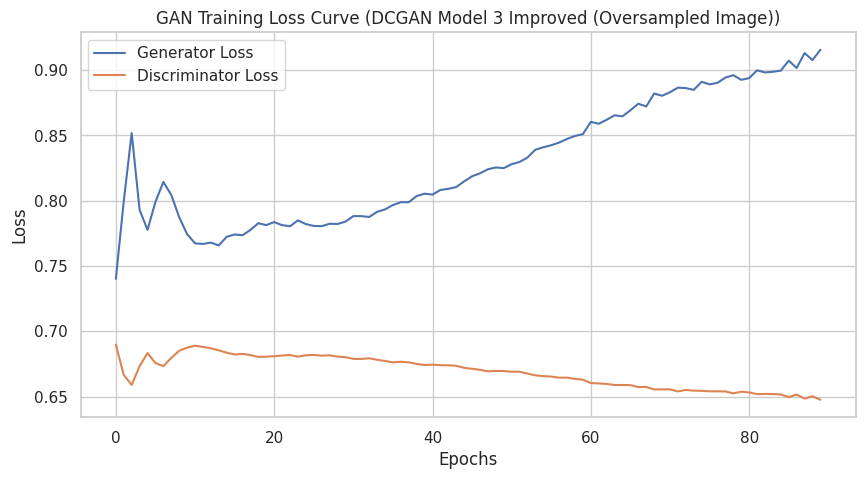

In [89]:
gan_history_5 = gan_5[0].history
generator = gan_5[1].generator  
gan_history_5['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_5['d_real_loss'], gan_history_5['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_5, title='GAN Training Loss Curve (DCGAN Model 3 Improved (Oversampled Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [90]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 0s 1ms/step
FID Score: 64.01306638024815
KID Score: 0.04585501756078836


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 64
- KID Score is 0.04
INo mprovement seen over baseline model

</div>

2/2 [==============================] - 1s 16ms/step


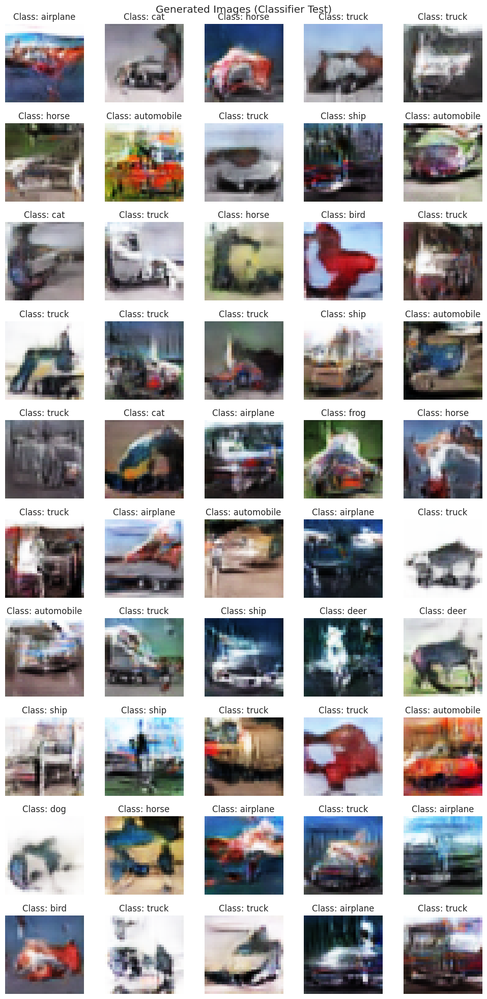

In [91]:
latent_dim = 128 
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Image produced may not be able to tell what is the object

</div>

4/4 [==============================] - 0s 2ms/step


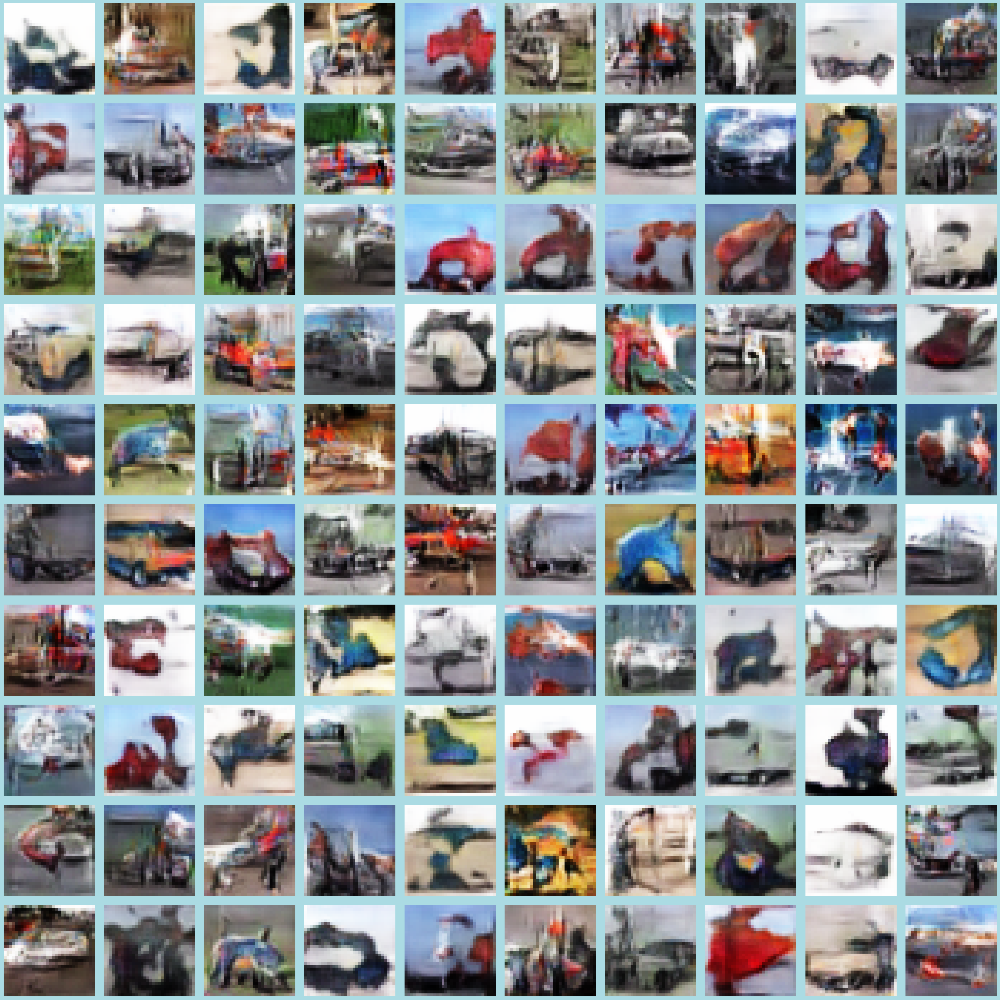

4/4 [==============================] - 0s 2ms/step


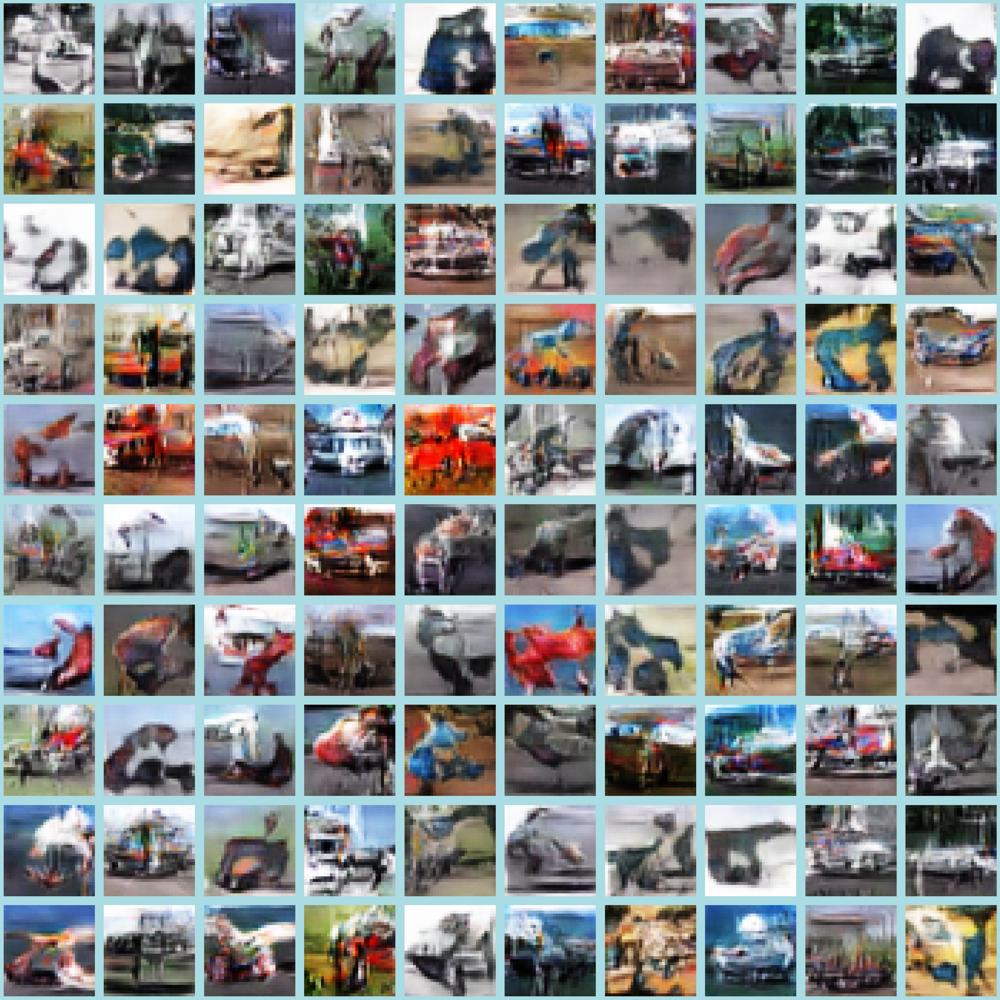

4/4 [==============================] - 0s 1ms/step


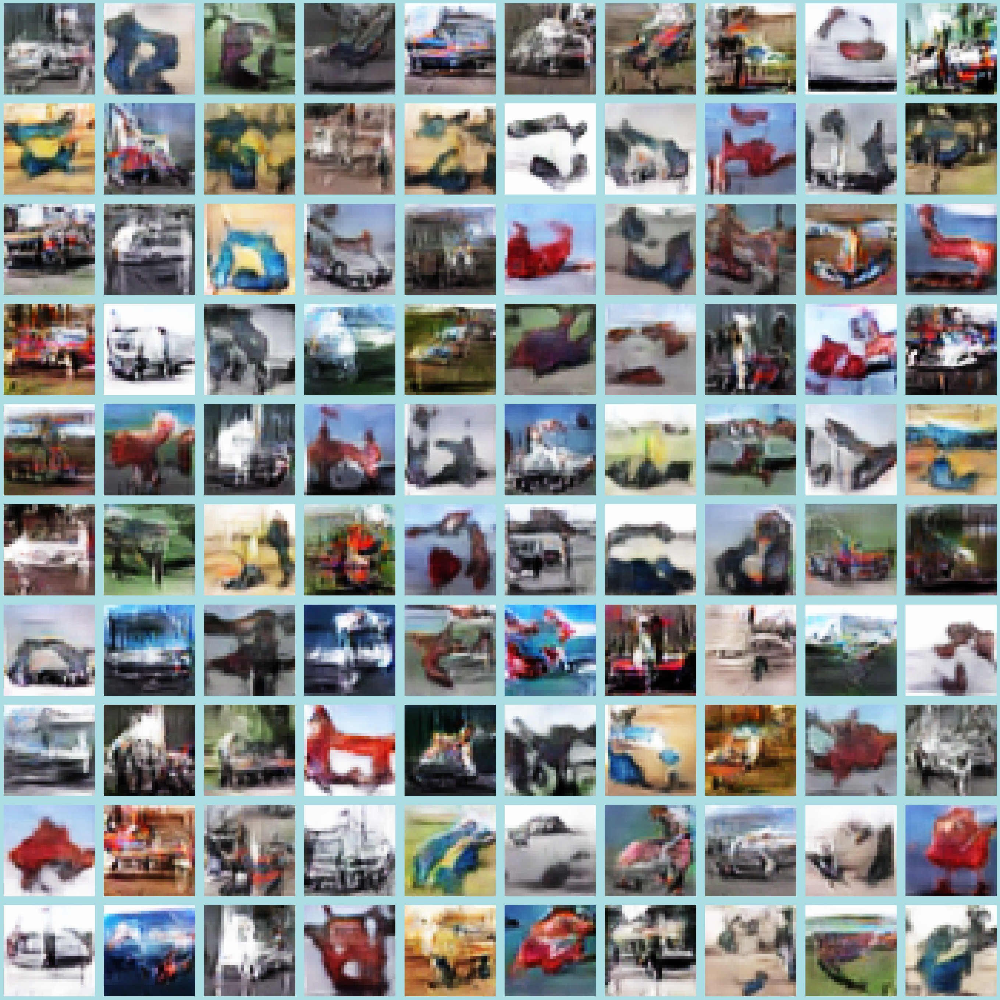

4/4 [==============================] - 0s 1ms/step


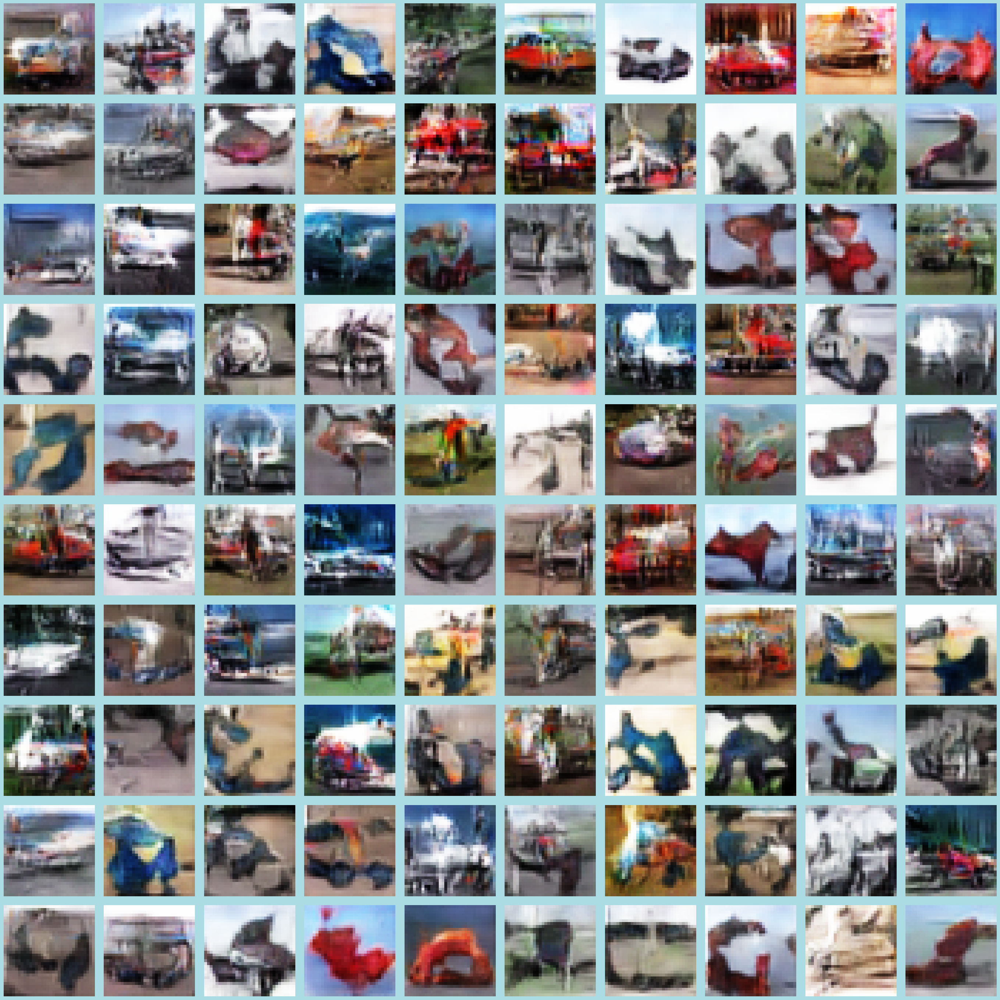

4/4 [==============================] - 0s 2ms/step


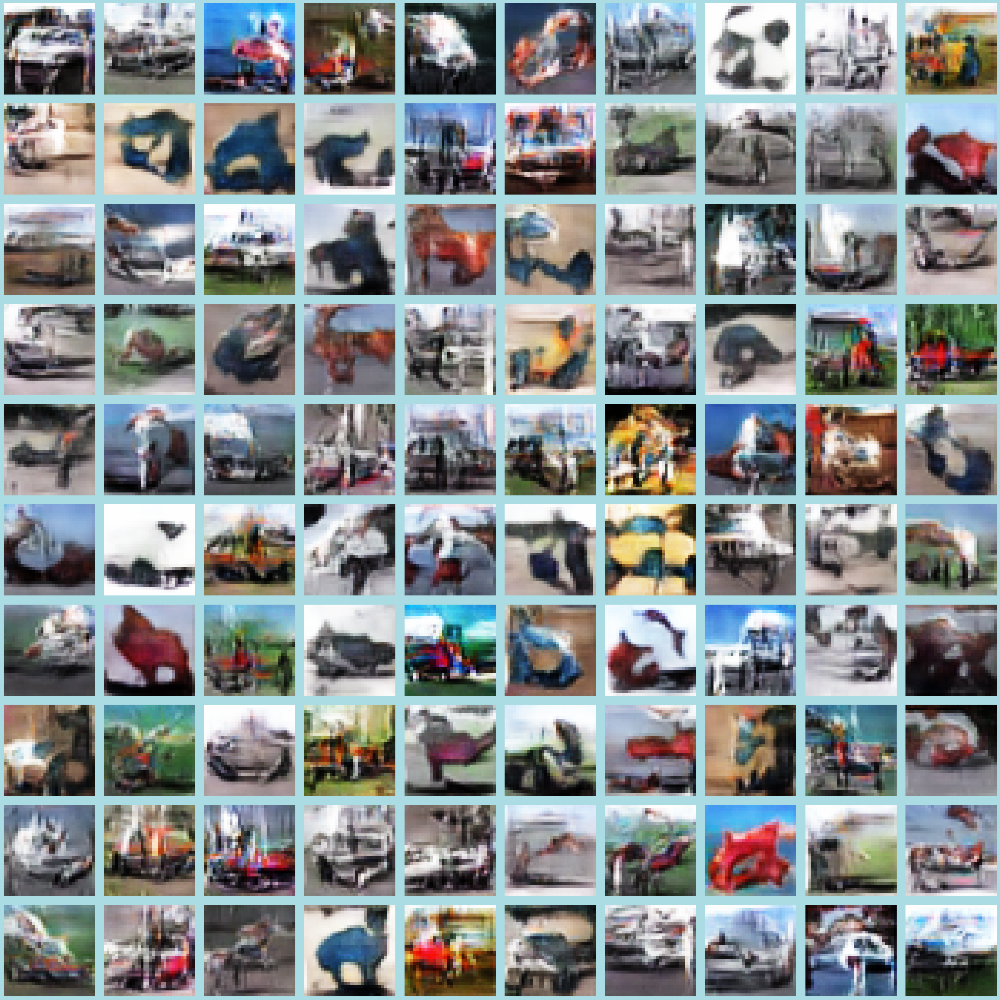

4/4 [==============================] - 0s 2ms/step


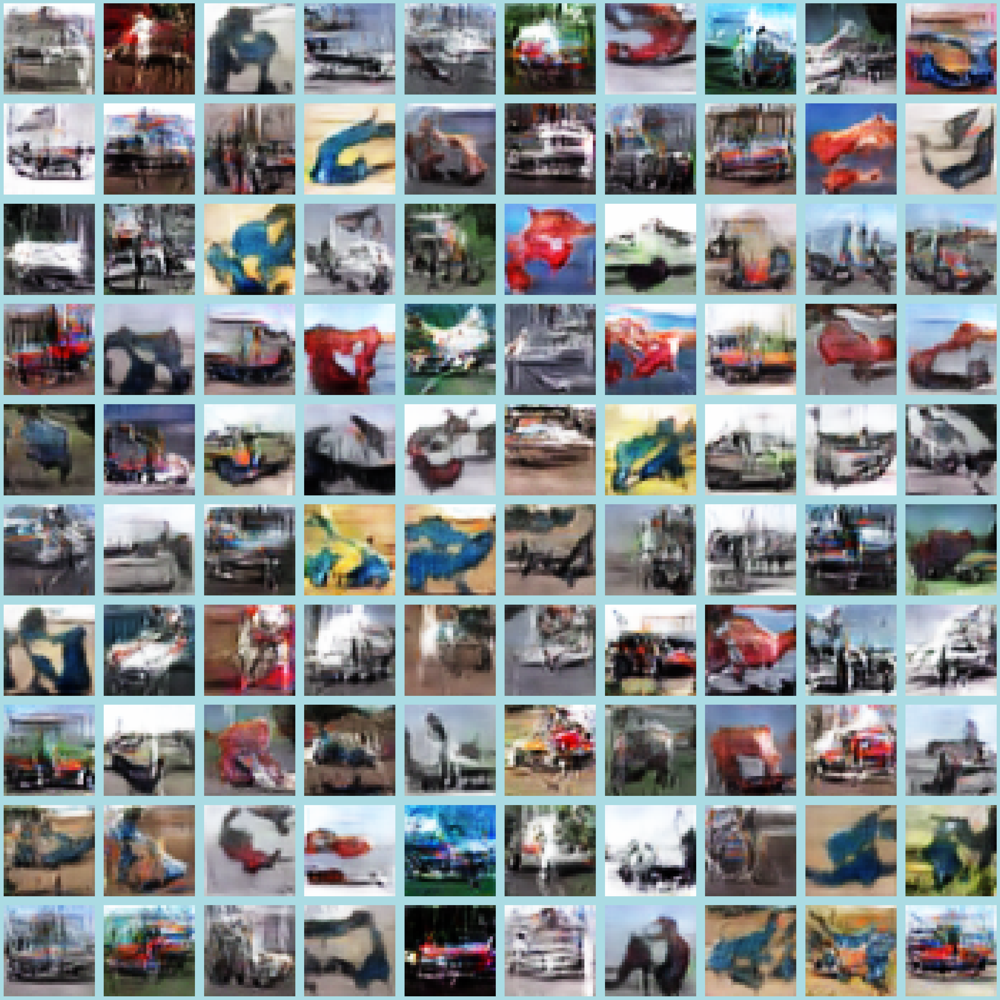

4/4 [==============================] - 0s 6ms/step


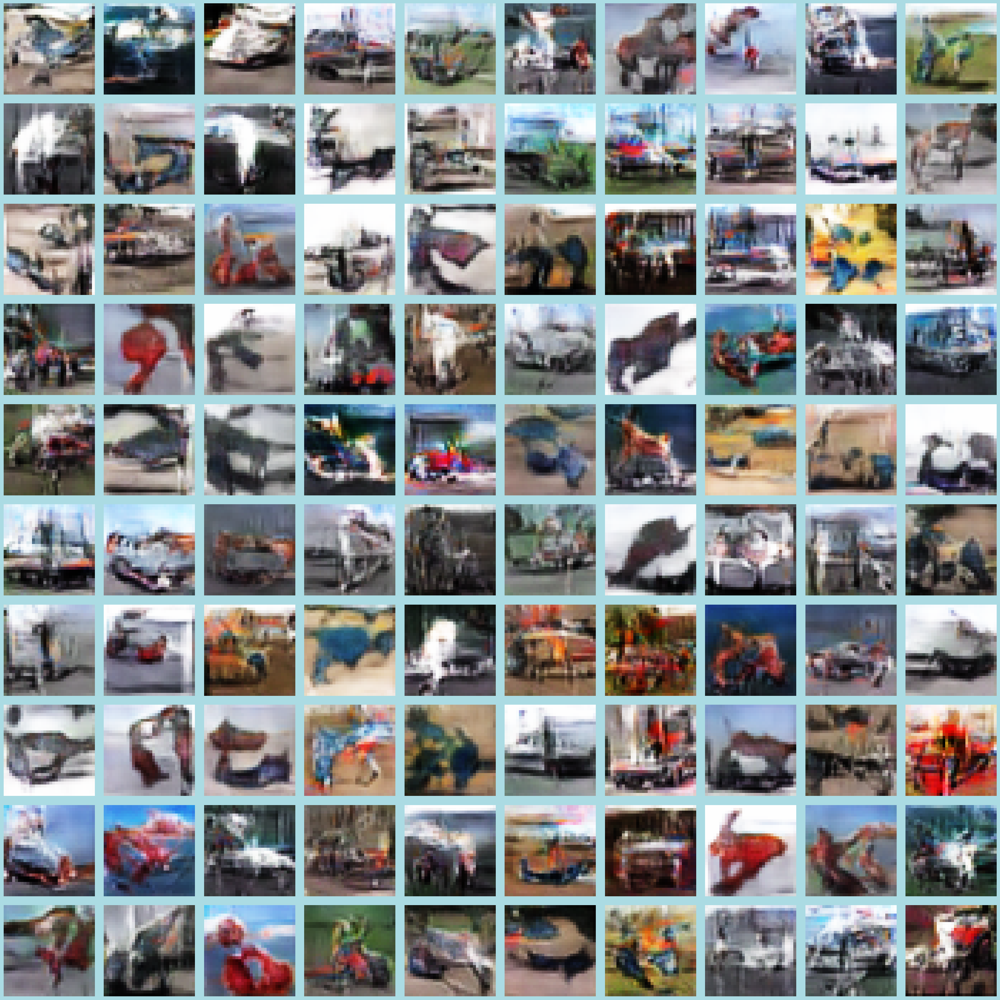

4/4 [==============================] - 0s 2ms/step


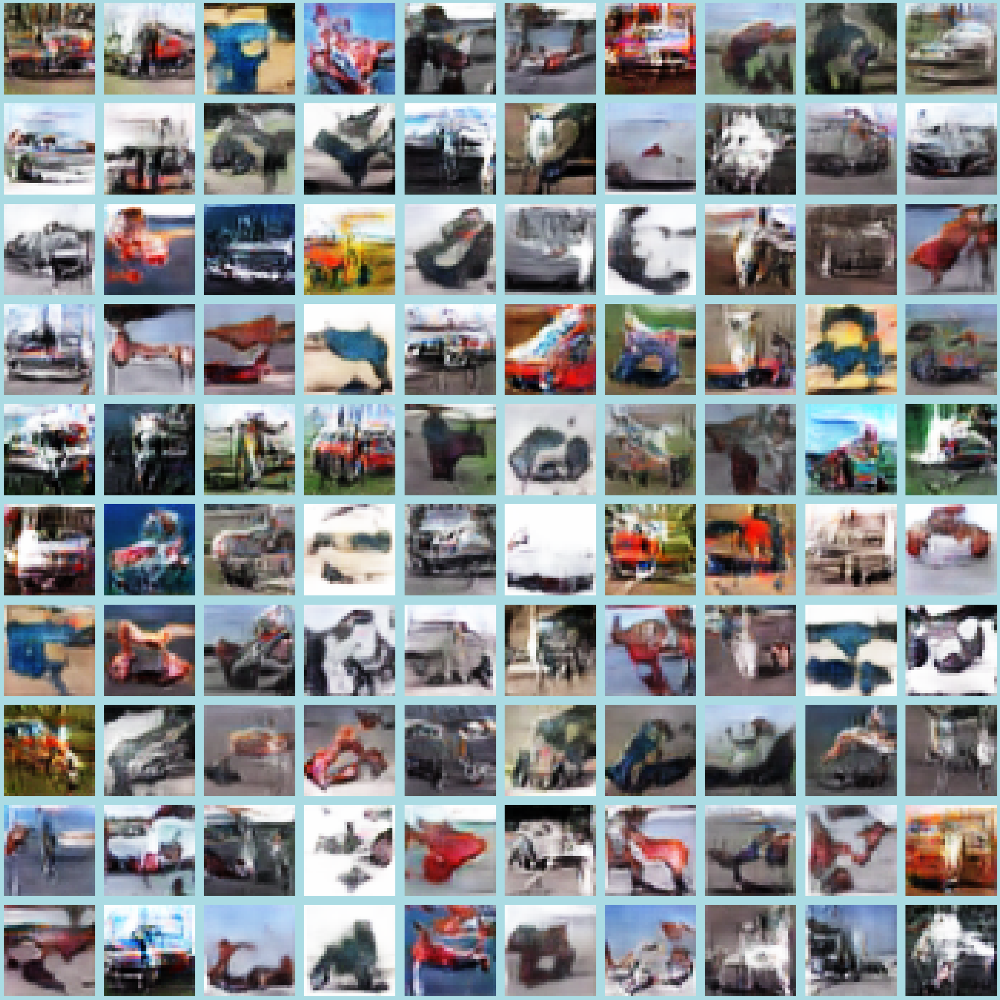

4/4 [==============================] - 0s 2ms/step


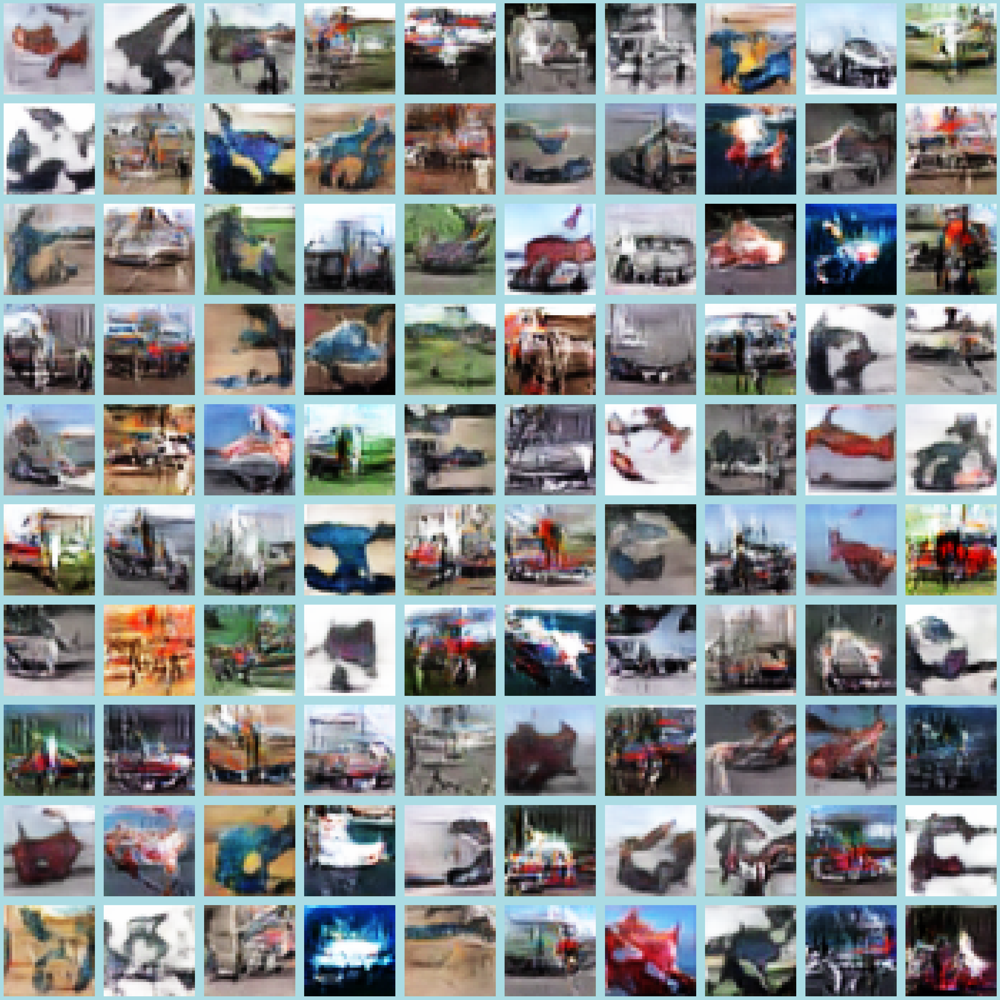

4/4 [==============================] - 0s 3ms/step


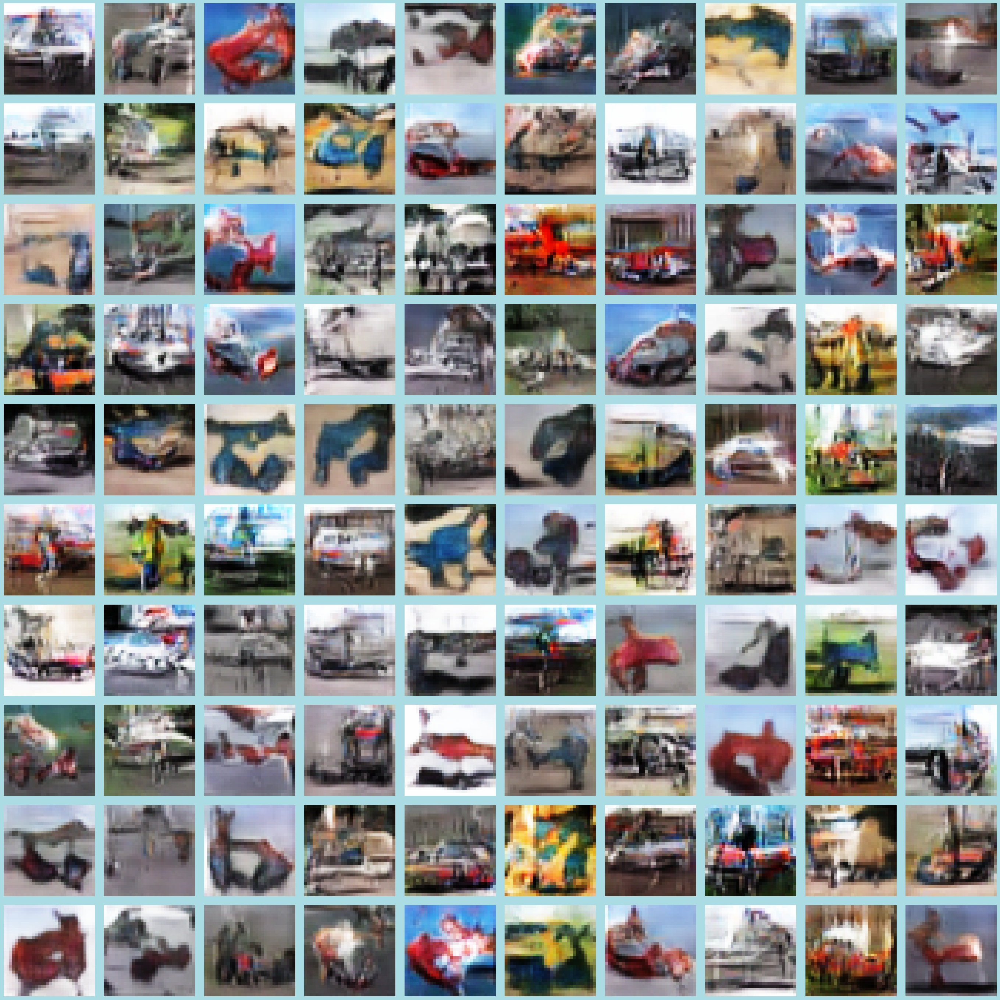

In [92]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Similar idea seen as the classifier test

</div>

#### Storing the scores

In [93]:
new_row = {'Model':'Oversample DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_5['d_loss'][-1], 'g_loss':gan_history_5['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,2.945318e-02,0.686637,0.746695
1,Sharpened Image DCGAN 3,680163.777727,3.370699e+07,0.684277,0.750914
2,Improved Data Generator DCGAN 3,700665.890898,3.764938e+07,0.689118,0.726457
3,CutMix DCGAN 3,51.564493,3.489228e-02,0.686637,0.746695
4,Oversample DCGAN 3,64.013066,4.585502e-02,0.647558,0.915615


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Model Improvement (Add Learning Rate Scheduler)__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [94]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1
latent_dim = 128

### Cosine Decay Schedular

### __Key Ideas__
1. Cosine decay reduces the learning rate in cosine wave pattern, slowing down at the beggining and end of traing.
2. The idea is to start with an initial learning rate and then reduce it which at the start descends slowly and more stteeply in the middle.
3. This approach is suitable for training neural networks as it combines both rapid and slow decay of learning rate

In [ ]:
def cosine_decay_scheduler(initial_lr=0.001, alpha=0.0, decay_steps=100000, 
                                          warmup_steps=1000, min_lr=None, decay_rate=1.0, 
                                          restart_period=10000):
    if min_lr is None:
        min_lr = alpha * initial_lr
    def scheduler(epoch, lr):
        if epoch < warmup_steps:
            return epoch * (initial_lr - min_lr) / warmup_steps + min_lr
        else:
            adjusted_epoch = (epoch - warmup_steps) % restart_period
            cosine_lr = (1 - alpha) * 0.5 * (1 + np.cos(np.pi * adjusted_epoch / (decay_steps * decay_rate))) * initial_lr + alpha * initial_lr
            return max(cosine_lr, min_lr)

    return tf.keras.callbacks.LearningRateScheduler(scheduler)

In [95]:
def cosine_decay_scheduler(initial_lr=0.001, alpha=0.0, decay_steps=100000, 
                                          warmup_steps=1000, min_lr=None, decay_rate=1.0, 
                                          restart_period=10000):
    if min_lr is None:
        min_lr = alpha * initial_lr
    def scheduler(epoch, lr):
        if epoch < warmup_steps:
            return epoch * (initial_lr - min_lr) / warmup_steps + min_lr
        else:
            adjusted_epoch = (epoch - warmup_steps) % restart_period
            cosine_lr = (1 - alpha) * 0.5 * (1 + np.cos(np.pi * adjusted_epoch / (decay_steps * decay_rate))) * initial_lr + alpha * initial_lr
            return max(cosine_lr, min_lr)

    return tf.keras.callbacks.LearningRateScheduler(scheduler)

#### Creating Checkpoint

In [96]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='CosineDecay DCGAN3')]

#### Training

In [97]:
dataset = tf.data.Dataset.from_tensor_slices(x_train)
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

In [98]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

In [99]:
lr_scheduler = cosine_decay_scheduler()
callbacks.append(lr_scheduler)

Epoch 1/100
777/782 [============================>.] - ETA: 0s - d_real_loss: 0.6045 - d_fake_loss: 0.6940 - g_loss: 0.8513 - d_acc: 0.5913 - d_realO: 0.4722 - d_fakeO: 0.5129

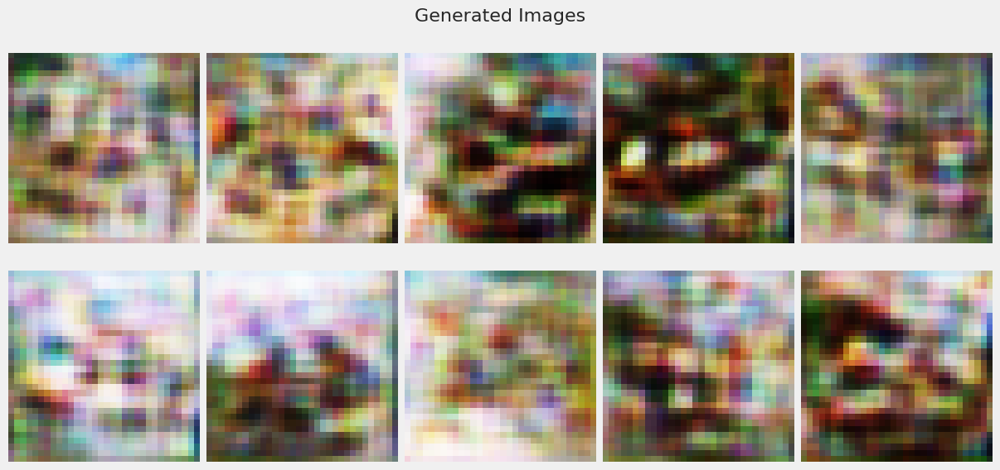

782/782 [==============================] - 8s 9ms/step - d_real_loss: 0.6050 - d_fake_loss: 0.6939 - g_loss: 0.8509 - d_acc: 0.5908 - d_realO: 0.4725 - d_fakeO: 0.5128 - lr: 0.0000e+00
Epoch 2/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.7124 - d_fake_loss: 0.6922 - g_loss: 0.7171 - d_acc: 0.4488 - d_realO: 0.5068 - d_fakeO: 0.5025 - lr: 1.0000e-06
Epoch 3/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6805 - d_fake_loss: 0.6871 - g_loss: 0.7313 - d_acc: 0.5603 - d_realO: 0.4767 - d_fakeO: 0.5087 - lr: 2.0000e-06
Epoch 4/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6922 - d_fake_loss: 0.6625 - g_loss: 0.8285 - d_acc: 0.5612 - d_realO: 0.4772 - d_fakeO: 0.5230 - lr: 3.0000e-06
Epoch 5/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6755 - d_fake_loss: 0.6421 - g_loss: 0.8619 - d_acc: 0.5806 - d_realO: 0.4783 - d_fakeO: 0.5228 - lr: 4.0000e-06
Epoch 6/100
782/782 [======

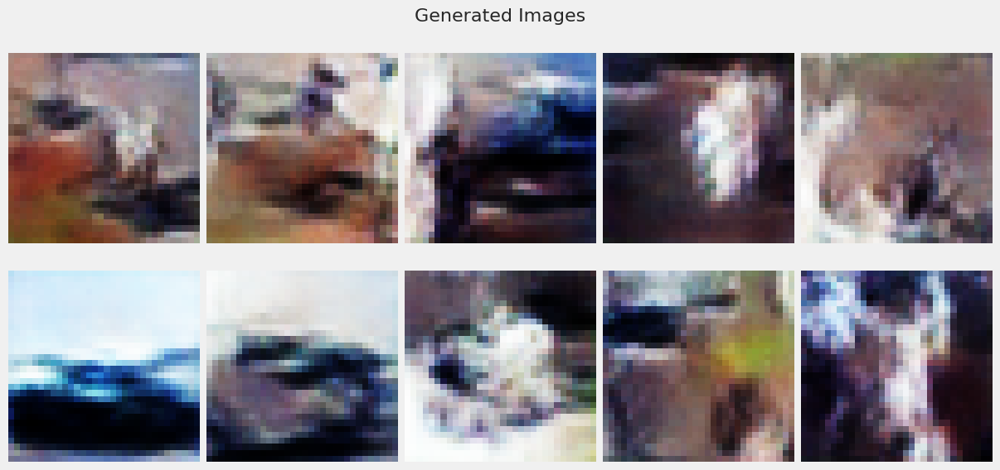

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6991 - d_fake_loss: 0.6904 - g_loss: 0.7569 - d_acc: 0.5059 - d_realO: 0.4979 - d_fakeO: 0.5039 - lr: 1.0000e-05
Epoch 12/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.7014 - d_fake_loss: 0.6949 - g_loss: 0.7451 - d_acc: 0.4895 - d_realO: 0.4980 - d_fakeO: 0.5037 - lr: 1.1000e-05
Epoch 13/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6977 - d_fake_loss: 0.6885 - g_loss: 0.7494 - d_acc: 0.5018 - d_realO: 0.4984 - d_fakeO: 0.5046 - lr: 1.2000e-05
Epoch 14/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6956 - d_fake_loss: 0.6871 - g_loss: 0.7451 - d_acc: 0.5078 - d_realO: 0.4980 - d_fakeO: 0.5046 - lr: 1.3000e-05
Epoch 15/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6942 - d_fake_loss: 0.6883 - g_loss: 0.7433 - d_acc: 0.5097 - d_realO: 0.4974 - d_fakeO: 0.5045 - lr: 1.4000e-05
Epoch 16/100
782/782 [=

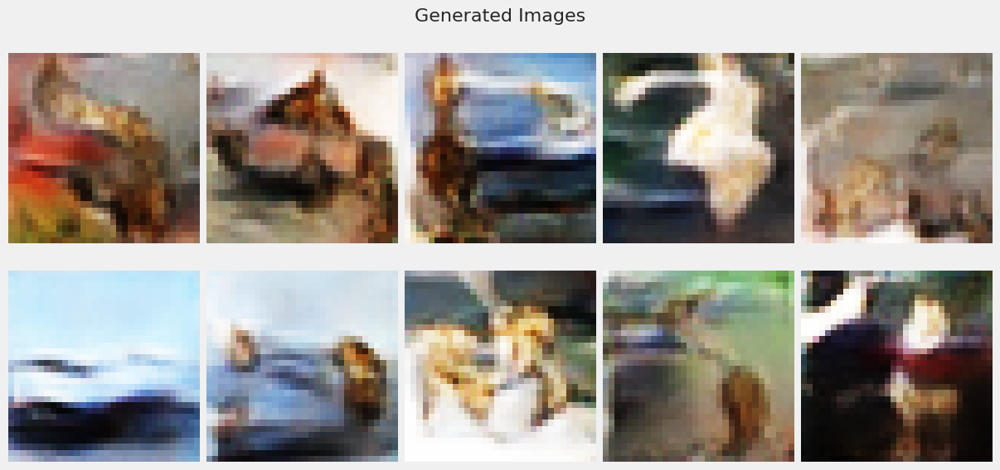

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6976 - d_fake_loss: 0.6905 - g_loss: 0.7311 - d_acc: 0.4936 - d_realO: 0.5001 - d_fakeO: 0.5016 - lr: 2.0000e-05
Epoch 22/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6972 - d_fake_loss: 0.6935 - g_loss: 0.7372 - d_acc: 0.4941 - d_realO: 0.4999 - d_fakeO: 0.5019 - lr: 2.1000e-05
Epoch 23/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6975 - d_fake_loss: 0.6921 - g_loss: 0.7272 - d_acc: 0.4844 - d_realO: 0.5004 - d_fakeO: 0.5017 - lr: 2.2000e-05
Epoch 24/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6978 - d_fake_loss: 0.6936 - g_loss: 0.7280 - d_acc: 0.4835 - d_realO: 0.5004 - d_fakeO: 0.5014 - lr: 2.3000e-05
Epoch 25/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6964 - d_fake_loss: 0.6919 - g_loss: 0.7263 - d_acc: 0.4890 - d_realO: 0.5003 - d_fakeO: 0.5015 - lr: 2.4000e-05
Epoch 26/100
782/782 [=

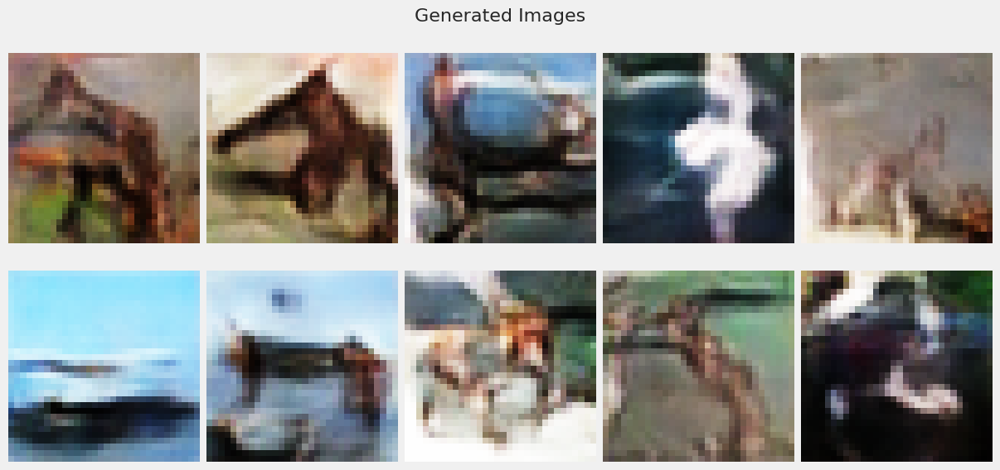

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6947 - d_fake_loss: 0.6909 - g_loss: 0.7258 - d_acc: 0.5008 - d_realO: 0.4995 - d_fakeO: 0.5021 - lr: 3.0000e-05
Epoch 32/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6948 - d_fake_loss: 0.6923 - g_loss: 0.7265 - d_acc: 0.4935 - d_realO: 0.4995 - d_fakeO: 0.5017 - lr: 3.1000e-05
Epoch 33/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6950 - d_fake_loss: 0.6915 - g_loss: 0.7263 - d_acc: 0.4982 - d_realO: 0.4994 - d_fakeO: 0.5020 - lr: 3.2000e-05
Epoch 34/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6945 - d_fake_loss: 0.6903 - g_loss: 0.7255 - d_acc: 0.4983 - d_realO: 0.4992 - d_fakeO: 0.5020 - lr: 3.3000e-05
Epoch 35/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6946 - d_fake_loss: 0.6909 - g_loss: 0.7271 - d_acc: 0.5011 - d_realO: 0.4993 - d_fakeO: 0.5020 - lr: 3.4000e-05
Epoch 36/100
782/782 [=

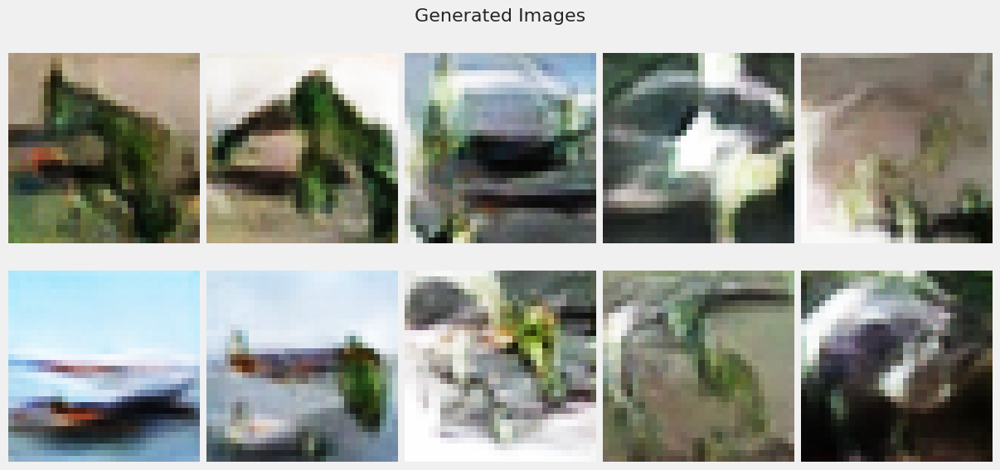

782/782 [==============================] - 8s 10ms/step - d_real_loss: 0.6940 - d_fake_loss: 0.6902 - g_loss: 0.7282 - d_acc: 0.5023 - d_realO: 0.4988 - d_fakeO: 0.5025 - lr: 4.0000e-05
Epoch 42/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6931 - d_fake_loss: 0.6917 - g_loss: 0.7254 - d_acc: 0.4985 - d_realO: 0.4987 - d_fakeO: 0.5024 - lr: 4.1000e-05
Epoch 43/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6930 - d_fake_loss: 0.6905 - g_loss: 0.7263 - d_acc: 0.5020 - d_realO: 0.4986 - d_fakeO: 0.5023 - lr: 4.2000e-05
Epoch 44/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6939 - d_fake_loss: 0.6899 - g_loss: 0.7258 - d_acc: 0.5047 - d_realO: 0.4987 - d_fakeO: 0.5024 - lr: 4.3000e-05
Epoch 45/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6925 - d_fake_loss: 0.6906 - g_loss: 0.7275 - d_acc: 0.5087 - d_realO: 0.4984 - d_fakeO: 0.5025 - lr: 4.4000e-05
Epoch 46/100
782/782 [

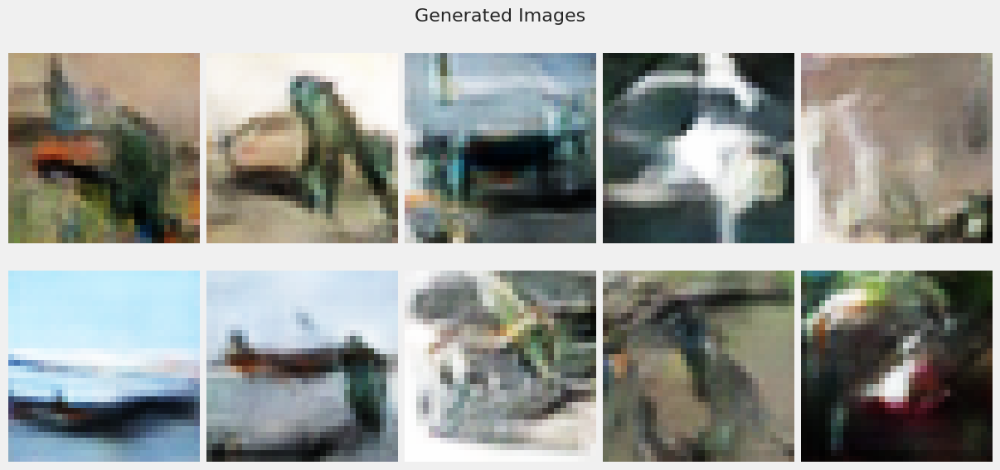

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6928 - d_fake_loss: 0.6909 - g_loss: 0.7290 - d_acc: 0.5056 - d_realO: 0.4985 - d_fakeO: 0.5025 - lr: 5.0000e-05
Epoch 52/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6916 - d_fake_loss: 0.6909 - g_loss: 0.7264 - d_acc: 0.5061 - d_realO: 0.4982 - d_fakeO: 0.5025 - lr: 5.1000e-05
Epoch 53/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6924 - d_fake_loss: 0.6893 - g_loss: 0.7292 - d_acc: 0.5099 - d_realO: 0.4982 - d_fakeO: 0.5027 - lr: 5.2000e-05
Epoch 54/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6927 - d_fake_loss: 0.6895 - g_loss: 0.7297 - d_acc: 0.5103 - d_realO: 0.4981 - d_fakeO: 0.5028 - lr: 5.3000e-05
Epoch 55/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6923 - d_fake_loss: 0.6894 - g_loss: 0.7289 - d_acc: 0.5127 - d_realO: 0.4982 - d_fakeO: 0.5028 - lr: 5.4000e-05
Epoch 56/100
782/782 [=

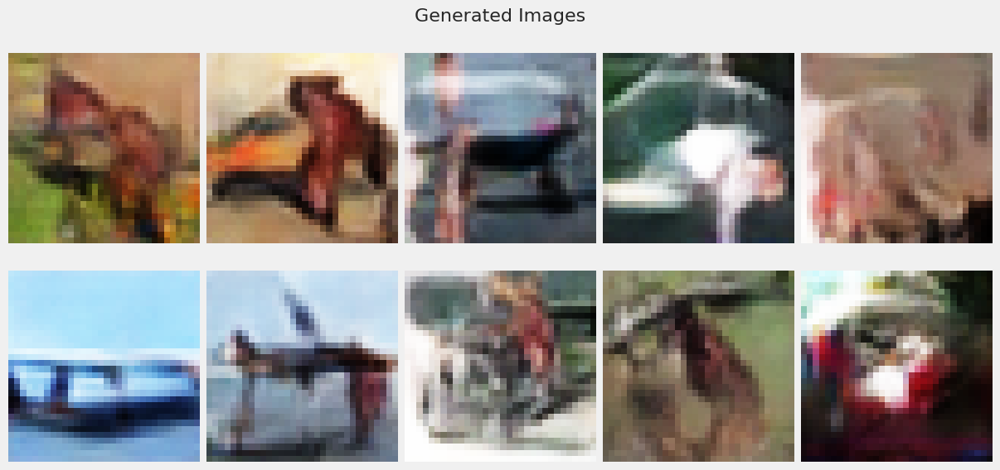

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6910 - d_fake_loss: 0.6890 - g_loss: 0.7332 - d_acc: 0.5176 - d_realO: 0.4976 - d_fakeO: 0.5035 - lr: 6.0000e-05
Epoch 62/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6916 - d_fake_loss: 0.6886 - g_loss: 0.7315 - d_acc: 0.5152 - d_realO: 0.4972 - d_fakeO: 0.5032 - lr: 6.1000e-05
Epoch 63/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6870 - g_loss: 0.7311 - d_acc: 0.5181 - d_realO: 0.4977 - d_fakeO: 0.5036 - lr: 6.2000e-05
Epoch 64/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6914 - d_fake_loss: 0.6885 - g_loss: 0.7334 - d_acc: 0.5165 - d_realO: 0.4973 - d_fakeO: 0.5036 - lr: 6.3000e-05
Epoch 65/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6913 - d_fake_loss: 0.6883 - g_loss: 0.7308 - d_acc: 0.5165 - d_realO: 0.4974 - d_fakeO: 0.5035 - lr: 6.4000e-05
Epoch 66/100
782/782 [=

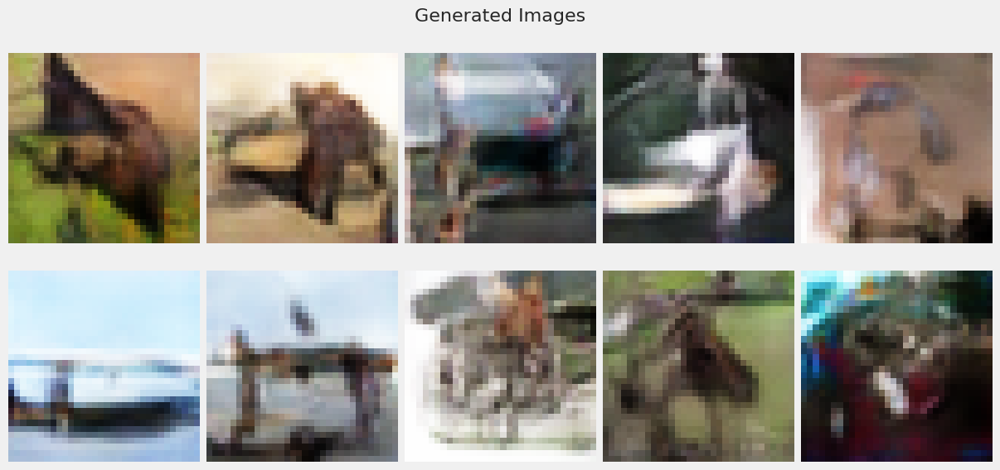

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6907 - d_fake_loss: 0.6873 - g_loss: 0.7368 - d_acc: 0.5211 - d_realO: 0.4967 - d_fakeO: 0.5043 - lr: 7.0000e-05
Epoch 72/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6898 - d_fake_loss: 0.6876 - g_loss: 0.7366 - d_acc: 0.5226 - d_realO: 0.4968 - d_fakeO: 0.5040 - lr: 7.1000e-05
Epoch 73/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6905 - d_fake_loss: 0.6877 - g_loss: 0.7366 - d_acc: 0.5206 - d_realO: 0.4964 - d_fakeO: 0.5042 - lr: 7.2000e-05
Epoch 74/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6902 - d_fake_loss: 0.6864 - g_loss: 0.7386 - d_acc: 0.5252 - d_realO: 0.4967 - d_fakeO: 0.5042 - lr: 7.3000e-05
Epoch 75/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6904 - d_fake_loss: 0.6859 - g_loss: 0.7381 - d_acc: 0.5266 - d_realO: 0.4966 - d_fakeO: 0.5046 - lr: 7.4000e-05
Epoch 76/100
782/782 [=

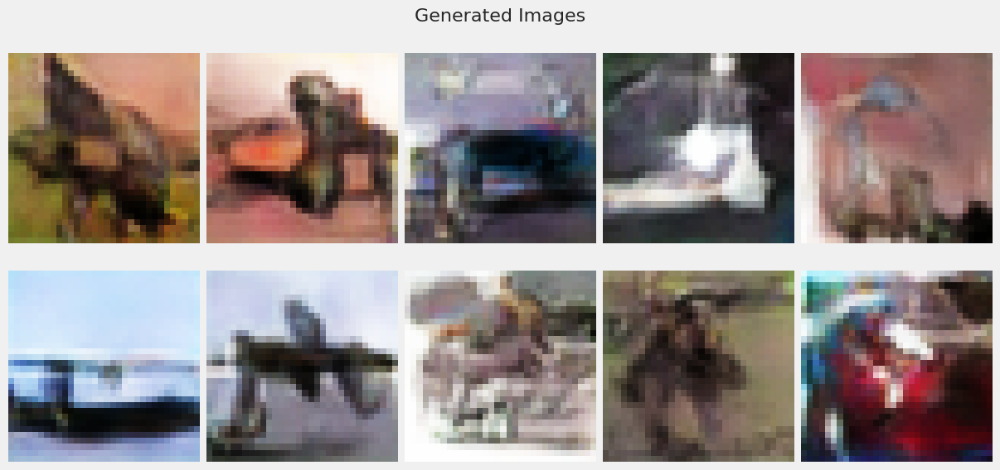

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6886 - d_fake_loss: 0.6857 - g_loss: 0.7531 - d_acc: 0.5252 - d_realO: 0.4956 - d_fakeO: 0.5055 - lr: 8.0000e-05
Epoch 82/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6894 - d_fake_loss: 0.6850 - g_loss: 0.7431 - d_acc: 0.5305 - d_realO: 0.4956 - d_fakeO: 0.5052 - lr: 8.1000e-05
Epoch 83/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6895 - d_fake_loss: 0.6850 - g_loss: 0.7420 - d_acc: 0.5280 - d_realO: 0.4958 - d_fakeO: 0.5054 - lr: 8.2000e-05
Epoch 84/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6891 - d_fake_loss: 0.6858 - g_loss: 0.7444 - d_acc: 0.5275 - d_realO: 0.4956 - d_fakeO: 0.5054 - lr: 8.3000e-05
Epoch 85/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6886 - d_fake_loss: 0.6855 - g_loss: 0.7476 - d_acc: 0.5327 - d_realO: 0.4953 - d_fakeO: 0.5057 - lr: 8.4000e-05
Epoch 86/100
782/782 [=

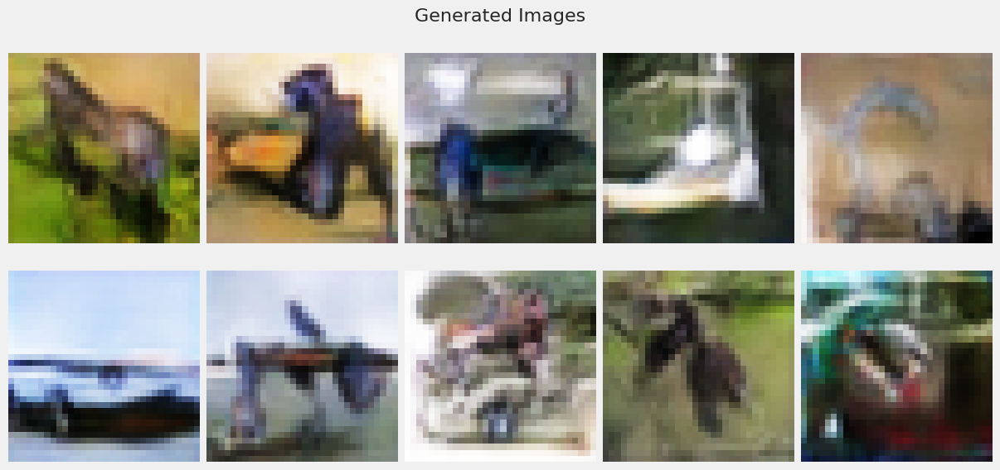

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6880 - d_fake_loss: 0.6845 - g_loss: 0.7453 - d_acc: 0.5359 - d_realO: 0.4951 - d_fakeO: 0.5060 - lr: 9.0000e-05
Epoch 92/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6877 - d_fake_loss: 0.6850 - g_loss: 0.7461 - d_acc: 0.5343 - d_realO: 0.4949 - d_fakeO: 0.5060 - lr: 9.1000e-05
Epoch 93/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6890 - d_fake_loss: 0.6831 - g_loss: 0.7471 - d_acc: 0.5350 - d_realO: 0.4950 - d_fakeO: 0.5063 - lr: 9.2000e-05
Epoch 94/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6886 - d_fake_loss: 0.6843 - g_loss: 0.7454 - d_acc: 0.5324 - d_realO: 0.4948 - d_fakeO: 0.5060 - lr: 9.3000e-05
Epoch 95/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6886 - d_fake_loss: 0.6838 - g_loss: 0.7486 - d_acc: 0.5313 - d_realO: 0.4947 - d_fakeO: 0.5063 - lr: 9.4000e-05
Epoch 96/100
782/782 [=

In [100]:
gan_7 = train_gan(discriminator_dcgan3, generator_dcgan3, noise, 'CosineDecay DCGAN 3', dataset_s, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  53% accuracy
- No model collapse


</div>

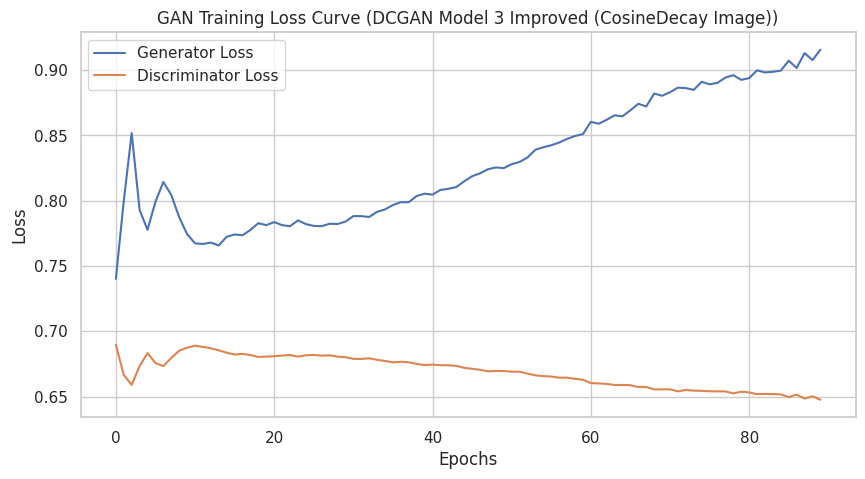

In [101]:
gan_history_7 = gan_7[0].history
generator = gan_7[1].generator  
gan_history_7['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_7['d_real_loss'], gan_history_7['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_5, title='GAN Training Loss Curve (DCGAN Model 3 Improved (CosineDecay Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [102]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 0s 1ms/step
FID Score: 46.44036254098748
KID Score: 0.02945601168410583


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 46
- KID Score is 0.02
Slide Improvement seen over baseline model

</div>

2/2 [==============================] - 1s 11ms/step


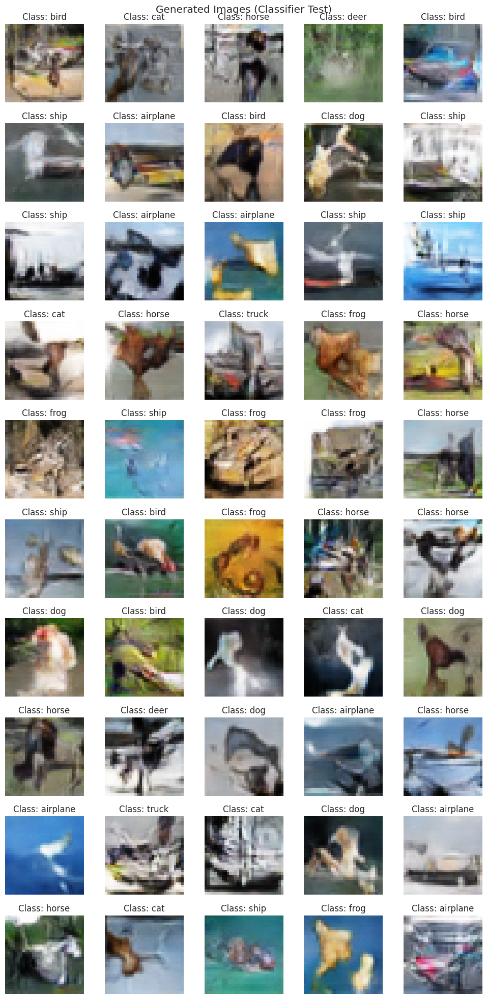

In [103]:
latent_dim = 128 
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Images pproduced are pretty clear here

</div>

#### Storing the scores

In [104]:
new_row = {'Model':'CosineDecay DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_7['d_loss'][-1], 'g_loss':gan_history_7['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,2.945318e-02,0.686637,0.746695
1,Sharpened Image DCGAN 3,680163.777727,3.370699e+07,0.684277,0.750914
2,Improved Data Generator DCGAN 3,700665.890898,3.764938e+07,0.689118,0.726457
3,CutMix DCGAN 3,51.564493,3.489228e-02,0.686637,0.746695
4,Oversample DCGAN 3,64.013066,4.585502e-02,0.647558,0.915615
5,CosineDecay DCGAN 3,46.440363,2.945601e-02,0.685025,0.751231


### Exponential Decay Scheduler

### __Key Ideas__
1. Exponential decay reduces the learning rate exponentially where the rate is decreasing at a exponential rate
2. Very useful incases where one wants to rapidly decrease the learning rate
3. Learning rate is a fraction of the previous learning rate here

In [105]:
def exponential_decay_scheduler(initial_lr=0.001, decay_rate=0.96, decay_steps=100000):
    def scheduler(epoch, lr):
        return initial_lr * decay_rate ** (epoch / decay_steps)
    return tf.keras.callbacks.LearningRateScheduler(scheduler)

In [106]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

In [107]:
lr_scheduler = exponential_decay_scheduler()
callbacks.append(lr_scheduler)

Epoch 1/100
780/782 [============================>.] - ETA: 0s - d_real_loss: 0.5848 - d_fake_loss: 0.7015 - g_loss: 0.8561 - d_acc: 0.5836 - d_realO: 0.4696 - d_fakeO: 0.5128

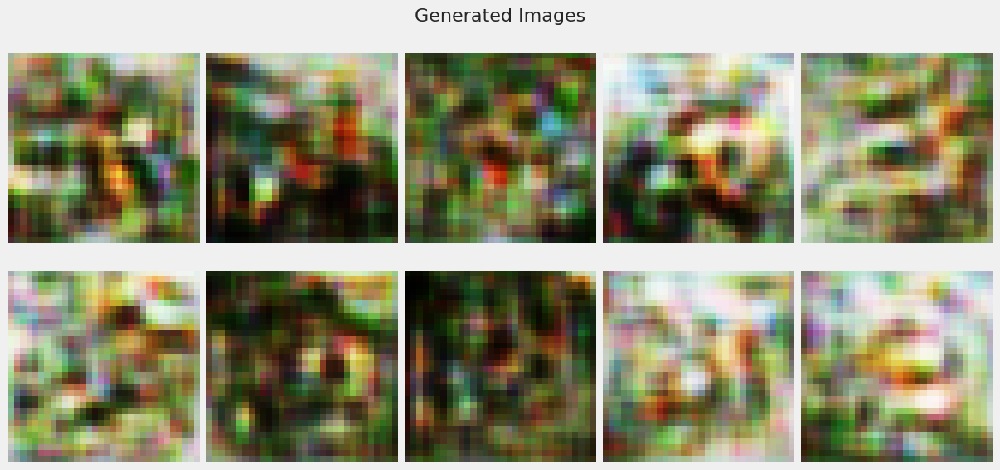

782/782 [==============================] - 8s 8ms/step - d_real_loss: 0.5851 - d_fake_loss: 0.7014 - g_loss: 0.8559 - d_acc: 0.5834 - d_realO: 0.4697 - d_fakeO: 0.5129 - lr: 0.0010
Epoch 2/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.7059 - d_fake_loss: 0.6853 - g_loss: 0.7316 - d_acc: 0.4995 - d_realO: 0.5027 - d_fakeO: 0.5043 - lr: 1.0000e-03
Epoch 3/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6859 - d_fake_loss: 0.6717 - g_loss: 0.7552 - d_acc: 0.5766 - d_realO: 0.4793 - d_fakeO: 0.5155 - lr: 1.0000e-03
Epoch 4/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6867 - d_fake_loss: 0.6624 - g_loss: 0.8332 - d_acc: 0.5686 - d_realO: 0.4856 - d_fakeO: 0.5167 - lr: 1.0000e-03
Epoch 5/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6860 - d_fake_loss: 0.6868 - g_loss: 0.7448 - d_acc: 0.5319 - d_realO: 0.4887 - d_fakeO: 0.5054 - lr: 1.0000e-03
Epoch 6/100
782/782 [==========

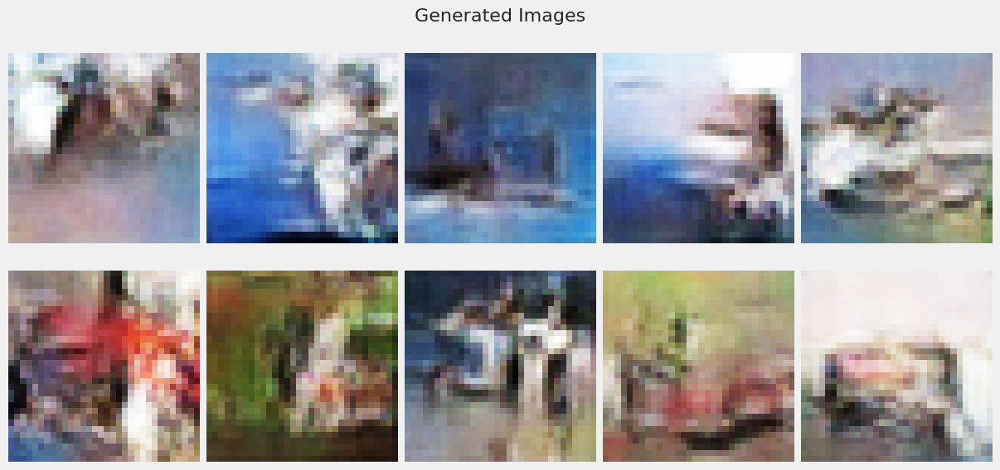

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6904 - d_fake_loss: 0.6770 - g_loss: 0.7790 - d_acc: 0.5441 - d_realO: 0.4930 - d_fakeO: 0.5100 - lr: 1.0000e-03
Epoch 12/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6958 - d_fake_loss: 0.6850 - g_loss: 0.7566 - d_acc: 0.5166 - d_realO: 0.4951 - d_fakeO: 0.5077 - lr: 1.0000e-03
Epoch 13/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6874 - d_fake_loss: 0.6839 - g_loss: 0.7631 - d_acc: 0.5373 - d_realO: 0.4936 - d_fakeO: 0.5087 - lr: 1.0000e-03
Epoch 14/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6862 - d_fake_loss: 0.6819 - g_loss: 0.7710 - d_acc: 0.5443 - d_realO: 0.4929 - d_fakeO: 0.5091 - lr: 9.9999e-04
Epoch 15/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6883 - d_fake_loss: 0.6790 - g_loss: 0.7649 - d_acc: 0.5416 - d_realO: 0.4927 - d_fakeO: 0.5096 - lr: 9.9999e-04
Epoch 16/100
782/782 [=

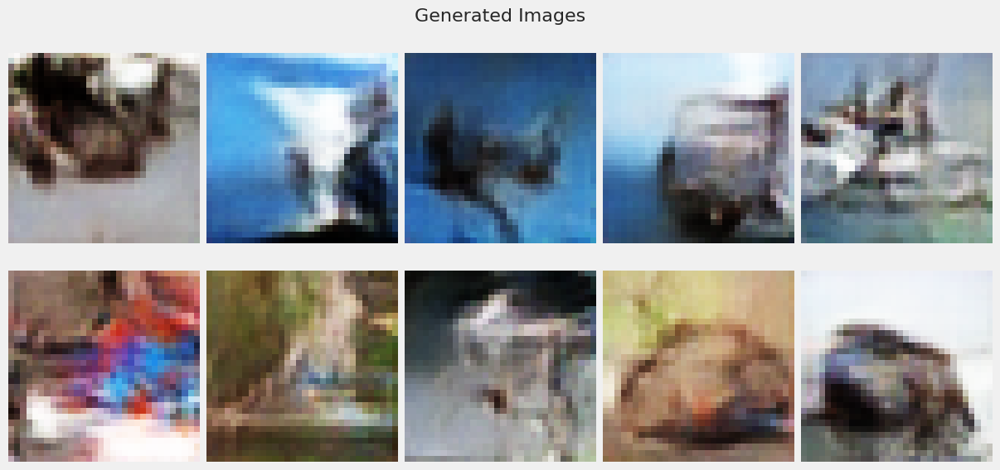

782/782 [==============================] - 7s 8ms/step - d_real_loss: 0.6922 - d_fake_loss: 0.6855 - g_loss: 0.7560 - d_acc: 0.5235 - d_realO: 0.4962 - d_fakeO: 0.5058 - lr: 9.9999e-04
Epoch 22/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.6883 - g_loss: 0.7491 - d_acc: 0.5138 - d_realO: 0.4960 - d_fakeO: 0.5051 - lr: 9.9999e-04
Epoch 23/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6946 - d_fake_loss: 0.6854 - g_loss: 0.7517 - d_acc: 0.5173 - d_realO: 0.4967 - d_fakeO: 0.5054 - lr: 9.9999e-04
Epoch 24/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6915 - d_fake_loss: 0.6869 - g_loss: 0.7530 - d_acc: 0.5263 - d_realO: 0.4963 - d_fakeO: 0.5050 - lr: 9.9999e-04
Epoch 25/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6935 - d_fake_loss: 0.6875 - g_loss: 0.7488 - d_acc: 0.5159 - d_realO: 0.4965 - d_fakeO: 0.5045 - lr: 9.9999e-04
Epoch 26/100
782/782 [=

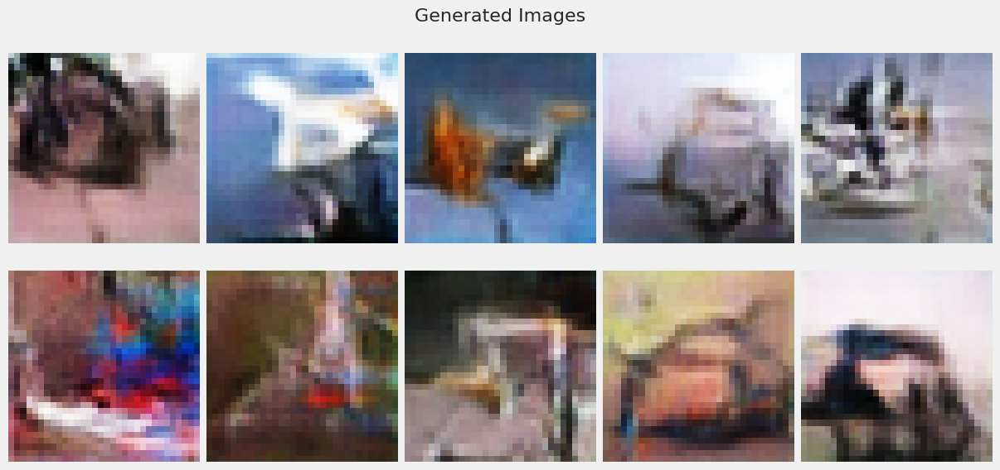

782/782 [==============================] - 7s 8ms/step - d_real_loss: 0.6938 - d_fake_loss: 0.6886 - g_loss: 0.7427 - d_acc: 0.5084 - d_realO: 0.4972 - d_fakeO: 0.5037 - lr: 9.9999e-04
Epoch 32/100
782/782 [==============================] - 6s 7ms/step - d_real_loss: 0.6933 - d_fake_loss: 0.6881 - g_loss: 0.7393 - d_acc: 0.5128 - d_realO: 0.4979 - d_fakeO: 0.5037 - lr: 9.9999e-04
Epoch 33/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6936 - d_fake_loss: 0.6901 - g_loss: 0.7403 - d_acc: 0.5075 - d_realO: 0.4978 - d_fakeO: 0.5031 - lr: 9.9999e-04
Epoch 34/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6928 - d_fake_loss: 0.6907 - g_loss: 0.7409 - d_acc: 0.5126 - d_realO: 0.4972 - d_fakeO: 0.5036 - lr: 9.9999e-04
Epoch 35/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6937 - d_fake_loss: 0.6897 - g_loss: 0.7355 - d_acc: 0.5095 - d_realO: 0.4979 - d_fakeO: 0.5031 - lr: 9.9999e-04
Epoch 36/100
782/782 [=

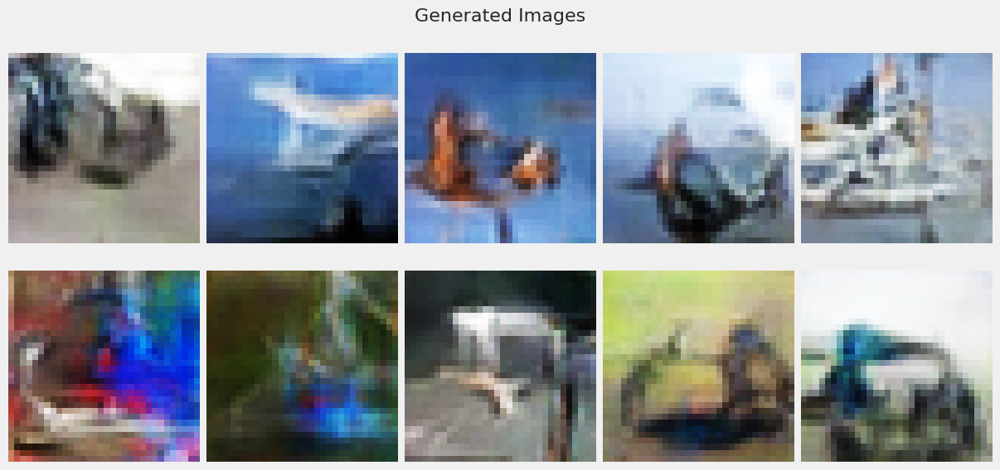

782/782 [==============================] - 7s 8ms/step - d_real_loss: 0.6917 - d_fake_loss: 0.6888 - g_loss: 0.7362 - d_acc: 0.5109 - d_realO: 0.4974 - d_fakeO: 0.5036 - lr: 9.9998e-04
Epoch 42/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6903 - d_fake_loss: 0.6899 - g_loss: 0.7480 - d_acc: 0.5170 - d_realO: 0.4966 - d_fakeO: 0.5040 - lr: 9.9998e-04
Epoch 43/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6913 - d_fake_loss: 0.6878 - g_loss: 0.7390 - d_acc: 0.5197 - d_realO: 0.4968 - d_fakeO: 0.5037 - lr: 9.9998e-04
Epoch 44/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6928 - d_fake_loss: 0.6864 - g_loss: 0.7418 - d_acc: 0.5186 - d_realO: 0.4967 - d_fakeO: 0.5042 - lr: 9.9998e-04
Epoch 45/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6914 - d_fake_loss: 0.6879 - g_loss: 0.7433 - d_acc: 0.5191 - d_realO: 0.4965 - d_fakeO: 0.5041 - lr: 9.9998e-04
Epoch 46/100
782/782 [=

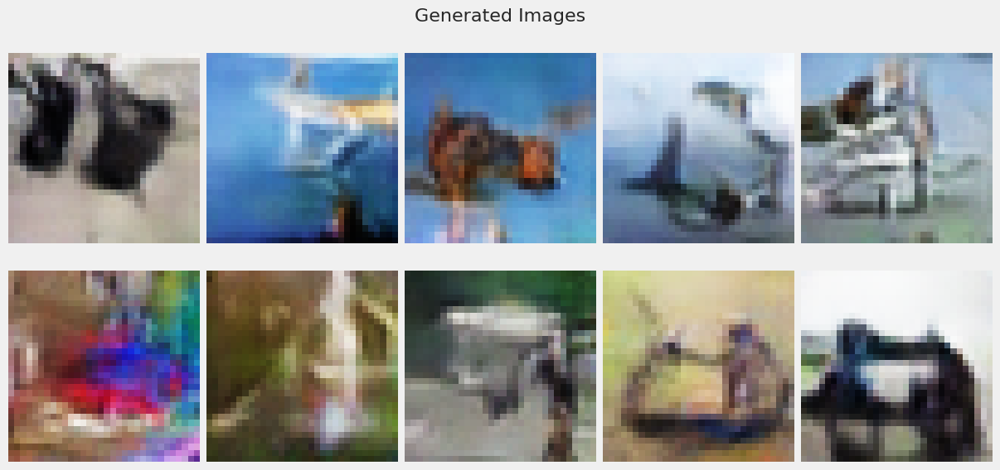

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6915 - d_fake_loss: 0.6874 - g_loss: 0.7373 - d_acc: 0.5172 - d_realO: 0.4966 - d_fakeO: 0.5044 - lr: 9.9998e-04
Epoch 52/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6890 - g_loss: 0.7398 - d_acc: 0.5178 - d_realO: 0.4968 - d_fakeO: 0.5039 - lr: 9.9998e-04
Epoch 53/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6876 - g_loss: 0.7406 - d_acc: 0.5171 - d_realO: 0.4964 - d_fakeO: 0.5040 - lr: 9.9998e-04
Epoch 54/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6871 - g_loss: 0.7437 - d_acc: 0.5180 - d_realO: 0.4968 - d_fakeO: 0.5043 - lr: 9.9998e-04
Epoch 55/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6870 - g_loss: 0.7379 - d_acc: 0.5186 - d_realO: 0.4969 - d_fakeO: 0.5041 - lr: 9.9998e-04
Epoch 56/100
782/782 [=

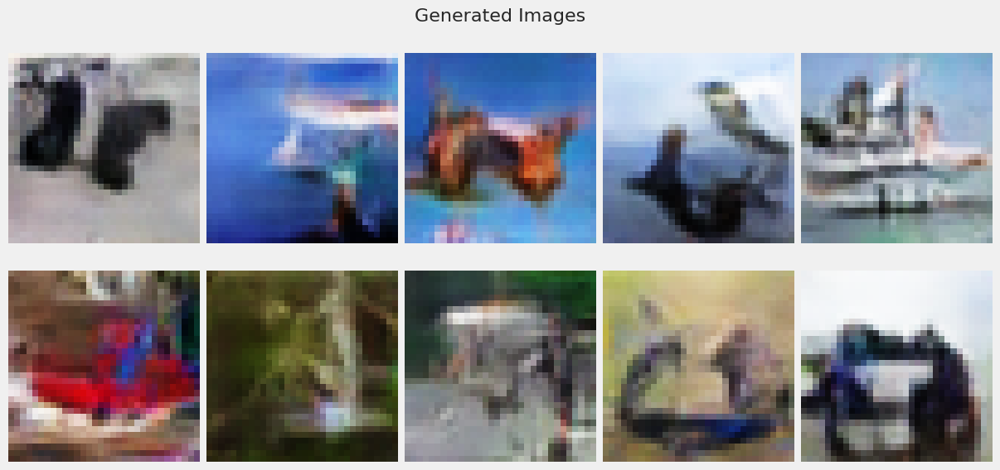

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6911 - d_fake_loss: 0.6882 - g_loss: 0.7415 - d_acc: 0.5162 - d_realO: 0.4966 - d_fakeO: 0.5042 - lr: 9.9998e-04
Epoch 62/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6870 - g_loss: 0.7417 - d_acc: 0.5201 - d_realO: 0.4965 - d_fakeO: 0.5045 - lr: 9.9998e-04
Epoch 63/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6909 - d_fake_loss: 0.6880 - g_loss: 0.7445 - d_acc: 0.5221 - d_realO: 0.4963 - d_fakeO: 0.5046 - lr: 9.9997e-04
Epoch 64/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6913 - d_fake_loss: 0.6872 - g_loss: 0.7409 - d_acc: 0.5190 - d_realO: 0.4965 - d_fakeO: 0.5043 - lr: 9.9997e-04
Epoch 65/100
782/782 [==============================] - 6s 7ms/step - d_real_loss: 0.6914 - d_fake_loss: 0.6871 - g_loss: 0.7422 - d_acc: 0.5213 - d_realO: 0.4967 - d_fakeO: 0.5045 - lr: 9.9997e-04
Epoch 66/100
782/782 [=

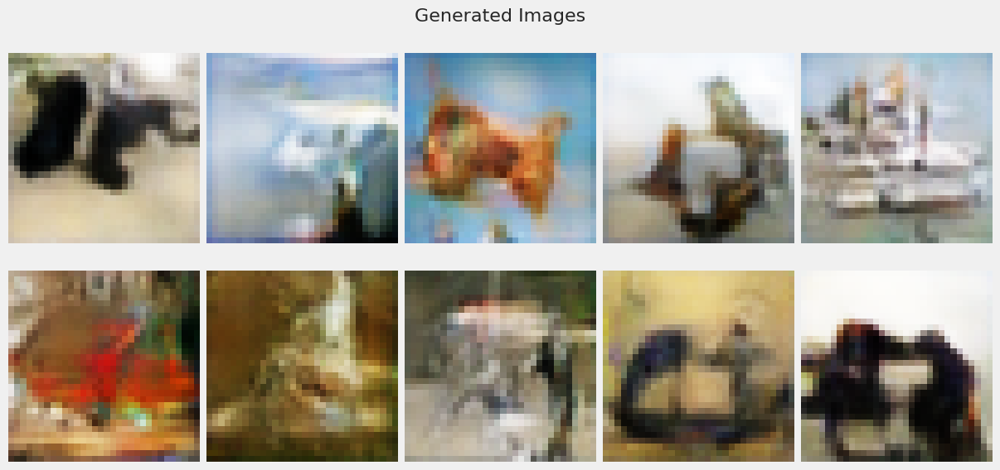

782/782 [==============================] - 7s 8ms/step - d_real_loss: 0.6911 - d_fake_loss: 0.6873 - g_loss: 0.7456 - d_acc: 0.5220 - d_realO: 0.4958 - d_fakeO: 0.5047 - lr: 9.9997e-04
Epoch 72/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6916 - d_fake_loss: 0.6866 - g_loss: 0.7456 - d_acc: 0.5252 - d_realO: 0.4961 - d_fakeO: 0.5050 - lr: 9.9997e-04
Epoch 73/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6906 - d_fake_loss: 0.6866 - g_loss: 0.7398 - d_acc: 0.5215 - d_realO: 0.4958 - d_fakeO: 0.5045 - lr: 9.9997e-04
Epoch 74/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6909 - d_fake_loss: 0.6857 - g_loss: 0.7578 - d_acc: 0.5270 - d_realO: 0.4958 - d_fakeO: 0.5055 - lr: 9.9997e-04
Epoch 75/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6904 - d_fake_loss: 0.6862 - g_loss: 0.7449 - d_acc: 0.5254 - d_realO: 0.4955 - d_fakeO: 0.5055 - lr: 9.9997e-04
Epoch 76/100
782/782 [=

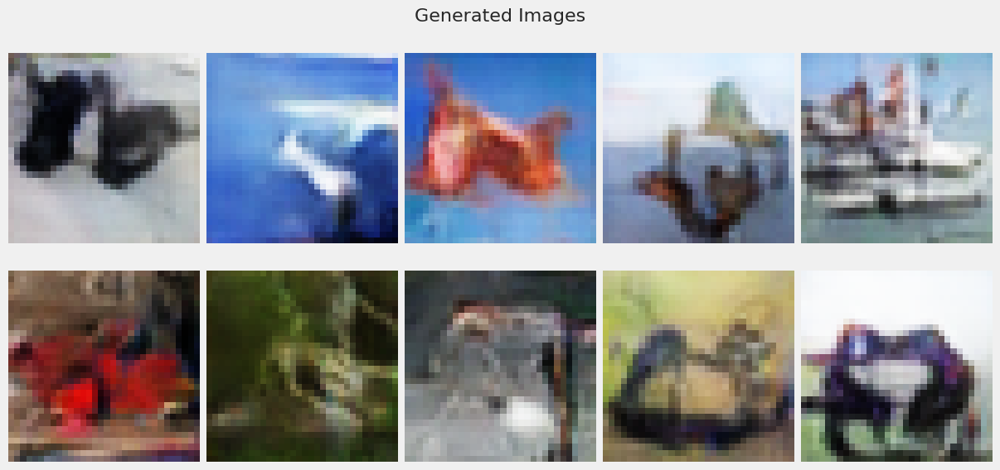

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6880 - d_fake_loss: 0.6862 - g_loss: 0.7484 - d_acc: 0.5308 - d_realO: 0.4951 - d_fakeO: 0.5058 - lr: 9.9997e-04
Epoch 82/100
782/782 [==============================] - 6s 7ms/step - d_real_loss: 0.6888 - d_fake_loss: 0.6854 - g_loss: 0.7518 - d_acc: 0.5319 - d_realO: 0.4949 - d_fakeO: 0.5059 - lr: 9.9997e-04
Epoch 83/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6896 - d_fake_loss: 0.6834 - g_loss: 0.7475 - d_acc: 0.5342 - d_realO: 0.4953 - d_fakeO: 0.5059 - lr: 9.9997e-04
Epoch 84/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6876 - d_fake_loss: 0.6841 - g_loss: 0.7512 - d_acc: 0.5360 - d_realO: 0.4946 - d_fakeO: 0.5060 - lr: 9.9997e-04
Epoch 85/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6890 - d_fake_loss: 0.6849 - g_loss: 0.7550 - d_acc: 0.5318 - d_realO: 0.4949 - d_fakeO: 0.5059 - lr: 9.9997e-04
Epoch 86/100
782/782 [=

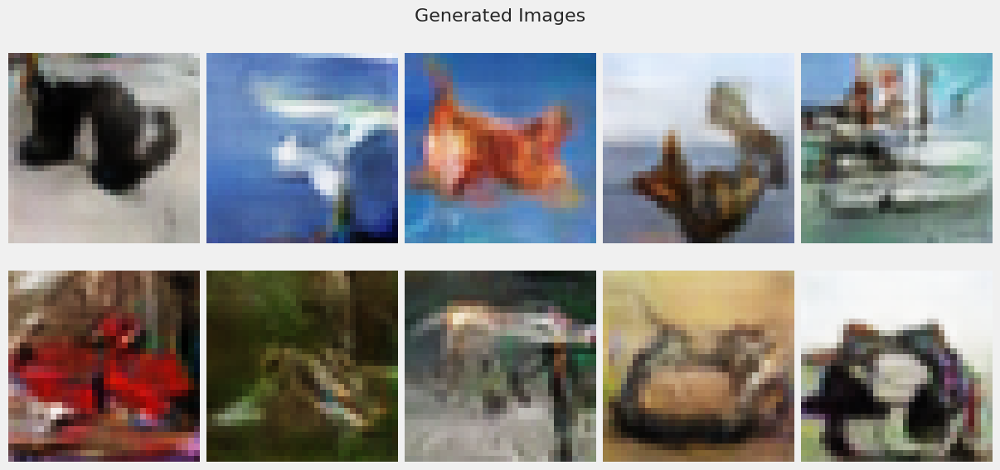

782/782 [==============================] - 7s 9ms/step - d_real_loss: 0.6874 - d_fake_loss: 0.6837 - g_loss: 0.7696 - d_acc: 0.5435 - d_realO: 0.4934 - d_fakeO: 0.5073 - lr: 9.9996e-04
Epoch 92/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6882 - d_fake_loss: 0.6821 - g_loss: 0.7524 - d_acc: 0.5394 - d_realO: 0.4939 - d_fakeO: 0.5071 - lr: 9.9996e-04
Epoch 93/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6884 - d_fake_loss: 0.6833 - g_loss: 0.7553 - d_acc: 0.5370 - d_realO: 0.4939 - d_fakeO: 0.5070 - lr: 9.9996e-04
Epoch 94/100
782/782 [==============================] - 6s 8ms/step - d_real_loss: 0.6873 - d_fake_loss: 0.6821 - g_loss: 0.7569 - d_acc: 0.5387 - d_realO: 0.4937 - d_fakeO: 0.5071 - lr: 9.9996e-04
Epoch 95/100
782/782 [==============================] - 6s 7ms/step - d_real_loss: 0.6872 - d_fake_loss: 0.6827 - g_loss: 0.7544 - d_acc: 0.5399 - d_realO: 0.4936 - d_fakeO: 0.5071 - lr: 9.9996e-04
Epoch 96/100
782/782 [=

In [108]:
gan_8 = train_gan(discriminator_dcgan3, generator_dcgan3, noise, 'ExponentialDecay DCGAN 3', dataset_s, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  54% accuracy
- No model collapse


</div>

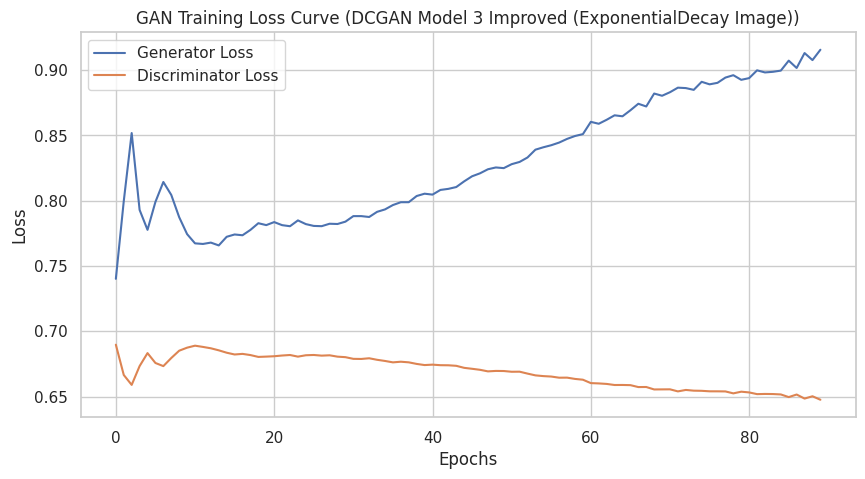

In [109]:
gan_history_8 = gan_8[0].history
generator = gan_8[1].generator  
gan_history_8['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_8['d_real_loss'], gan_history_8['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_5, title='GAN Training Loss Curve (DCGAN Model 3 Improved (ExponentialDecay Image))')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there with a slide decrease
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [110]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 0s 1ms/step
FID Score: 49.03657938518763
KID Score: 0.030866098904173356


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 49
- KID Score is 0.03
No Improvement seen over baseline model

</div>

2/2 [==============================] - 1s 14ms/step


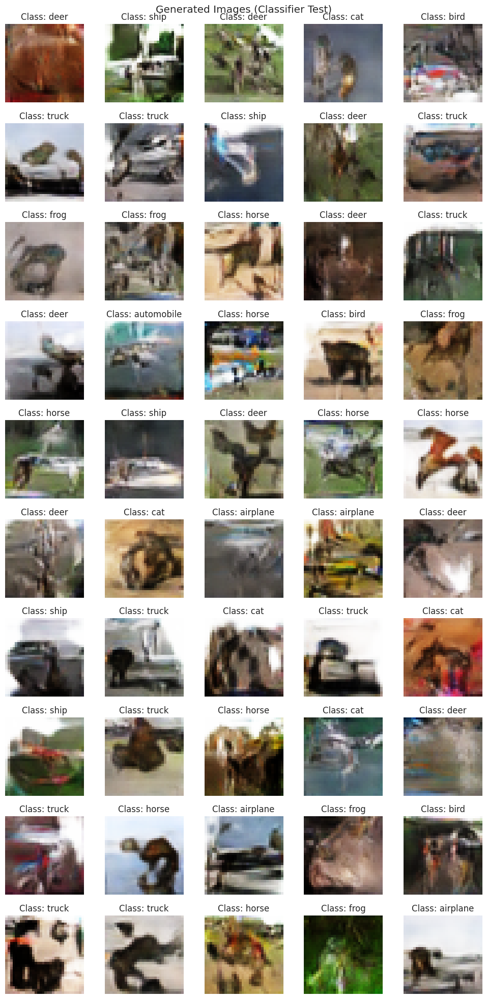

In [111]:
latent_dim = 128 
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

Image are not very clear

</div>

4/4 [==============================] - 0s 2ms/step


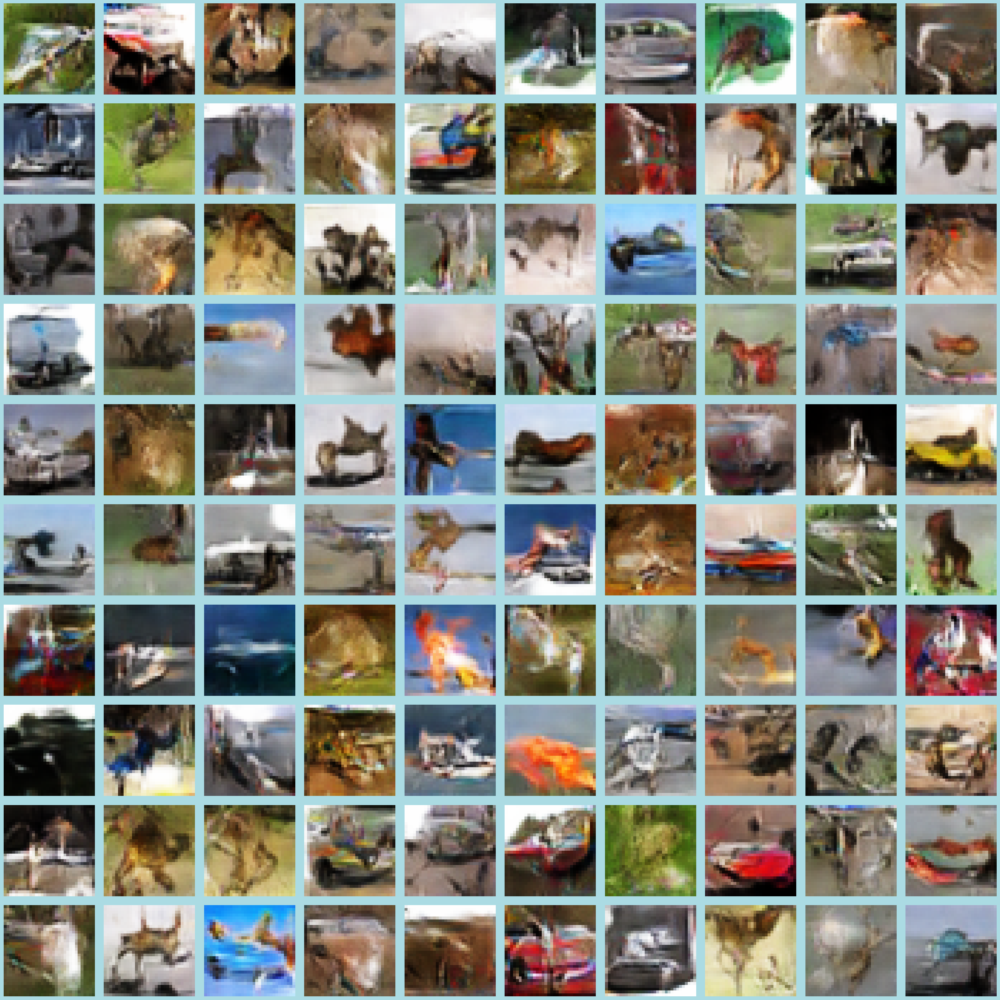

4/4 [==============================] - 0s 1ms/step


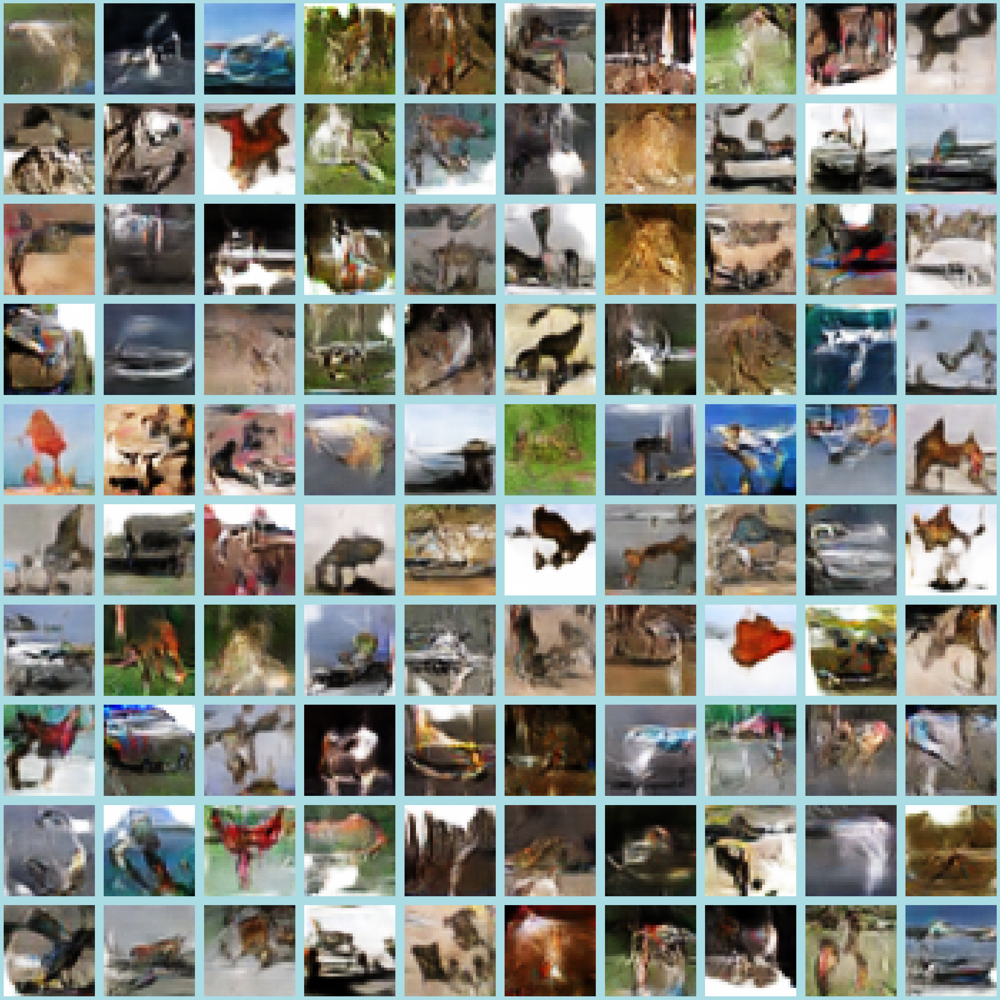

4/4 [==============================] - 0s 2ms/step


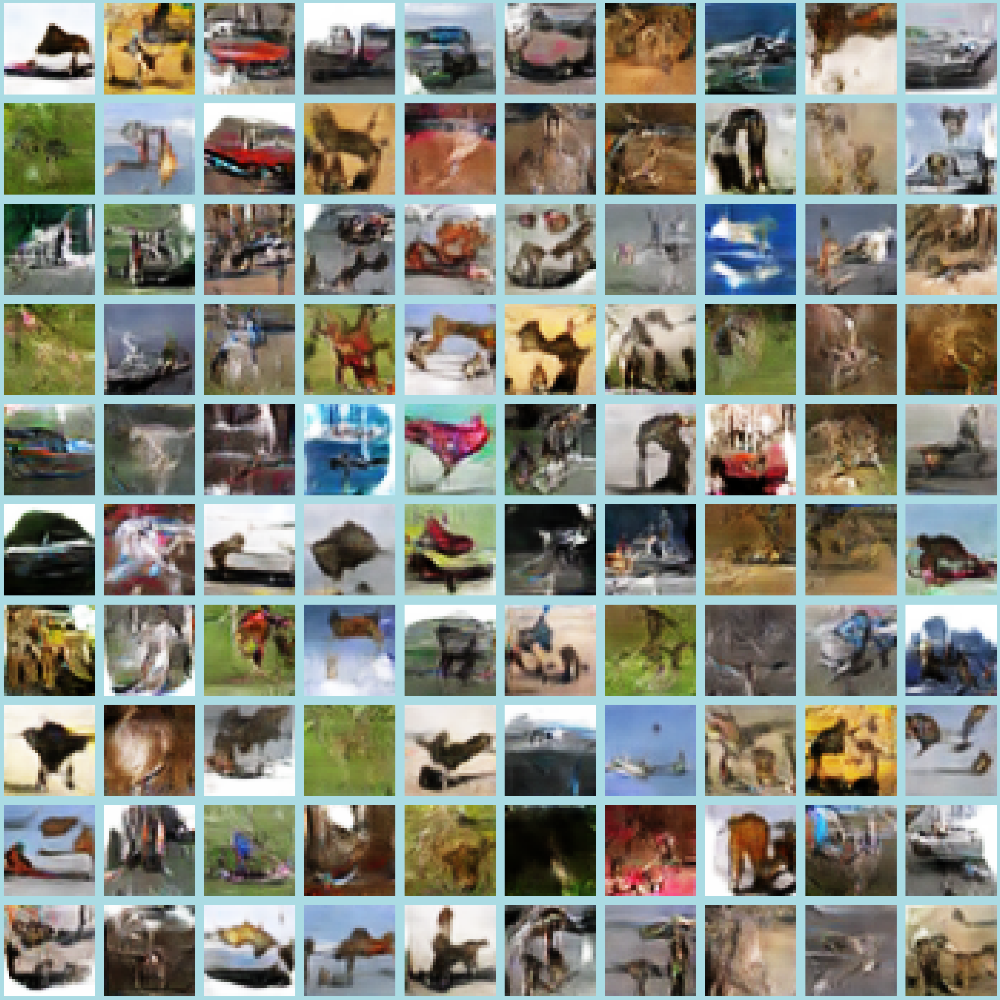

4/4 [==============================] - 0s 2ms/step


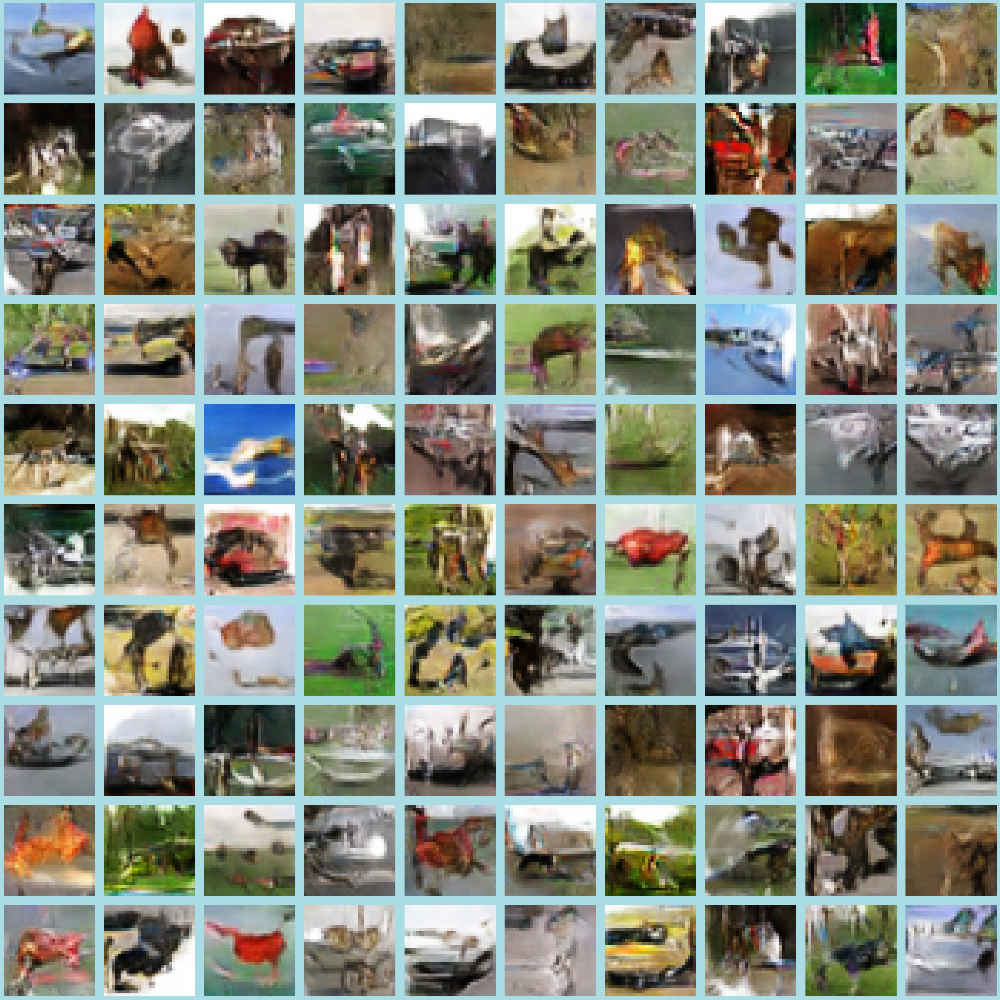

4/4 [==============================] - 0s 2ms/step


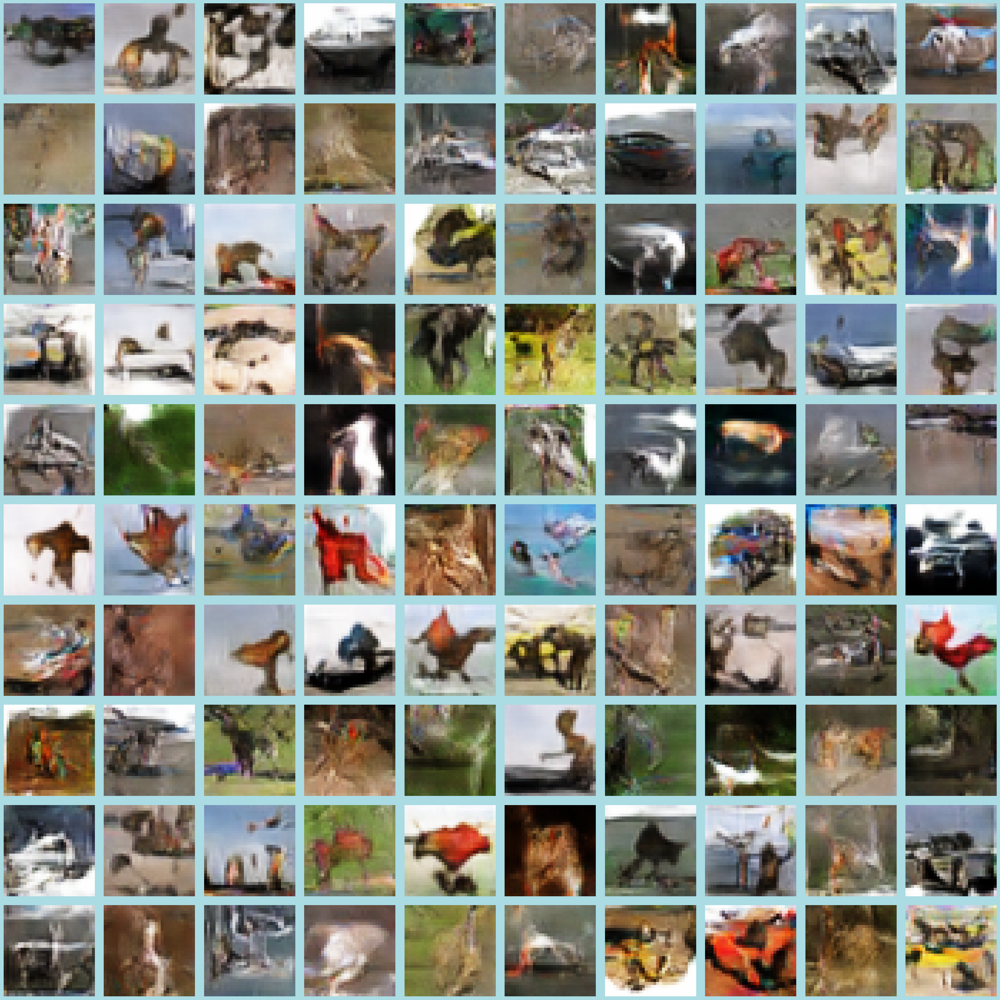

4/4 [==============================] - 0s 2ms/step


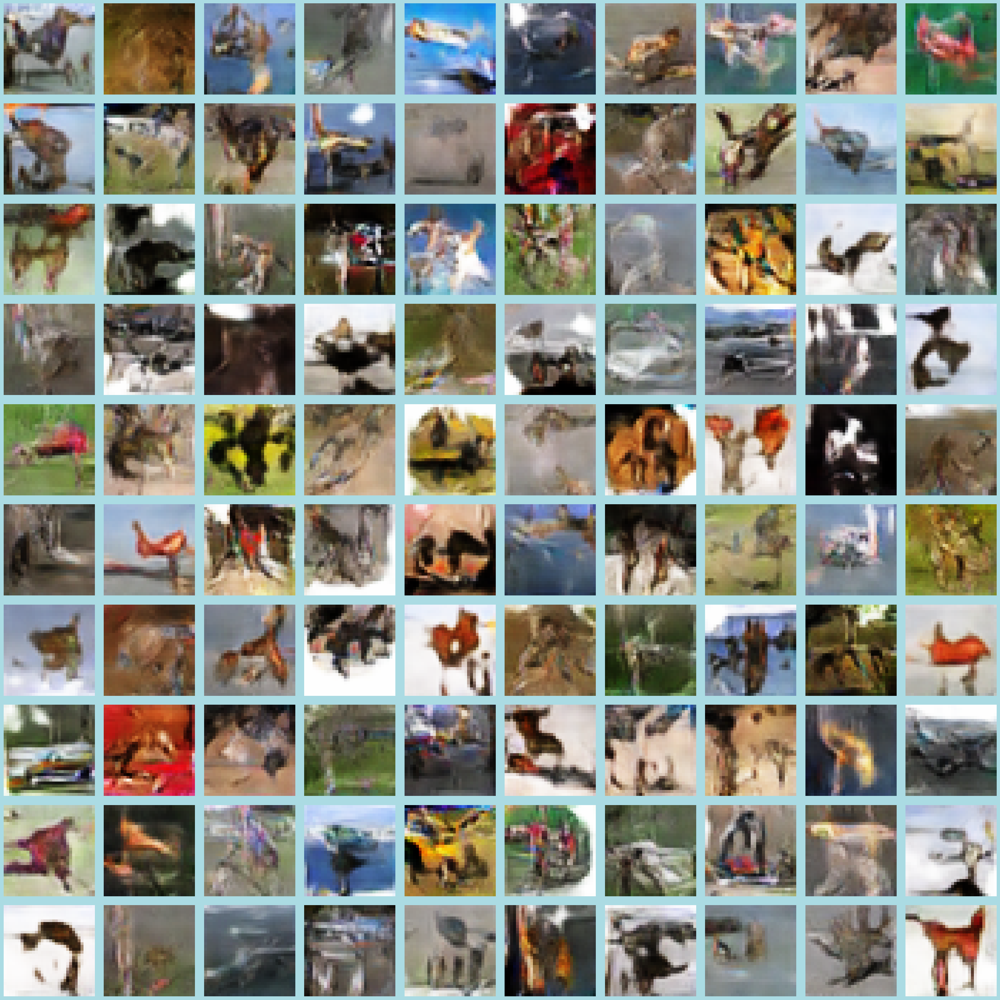

4/4 [==============================] - 0s 2ms/step


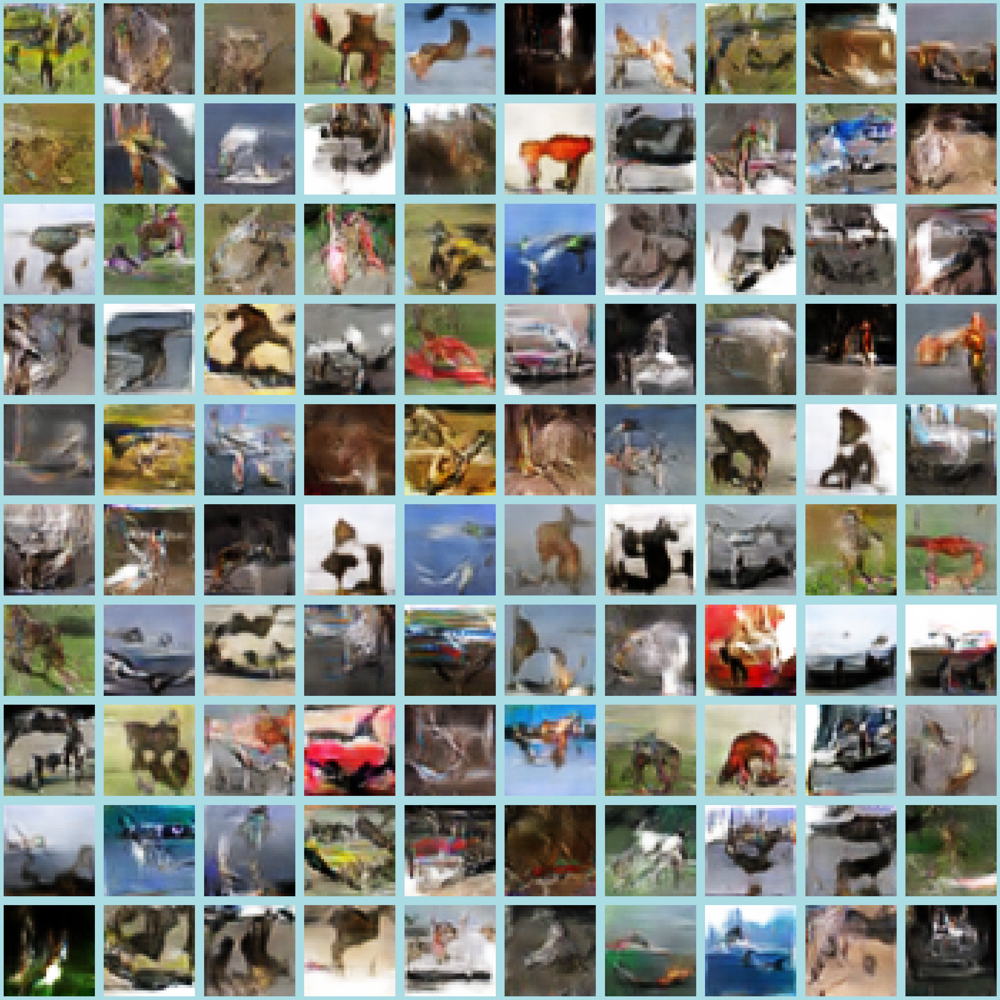

4/4 [==============================] - 0s 2ms/step


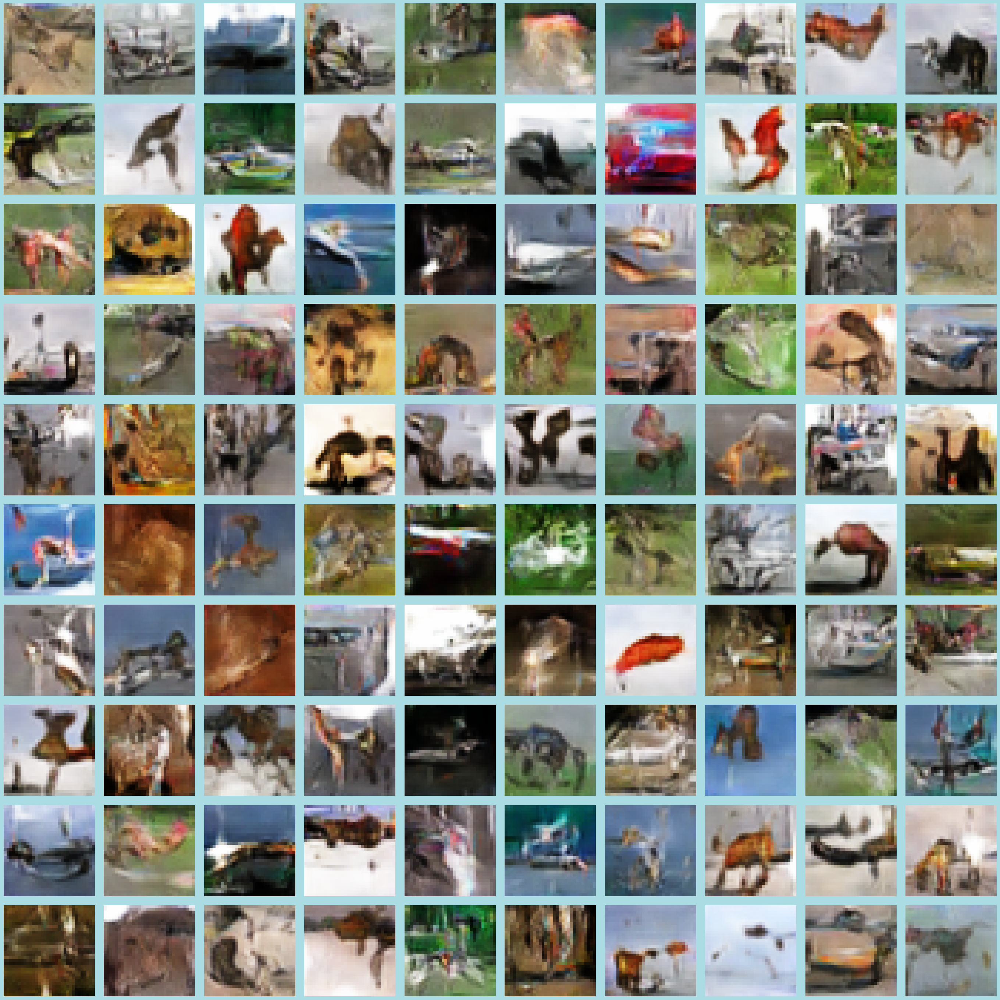

4/4 [==============================] - 0s 2ms/step


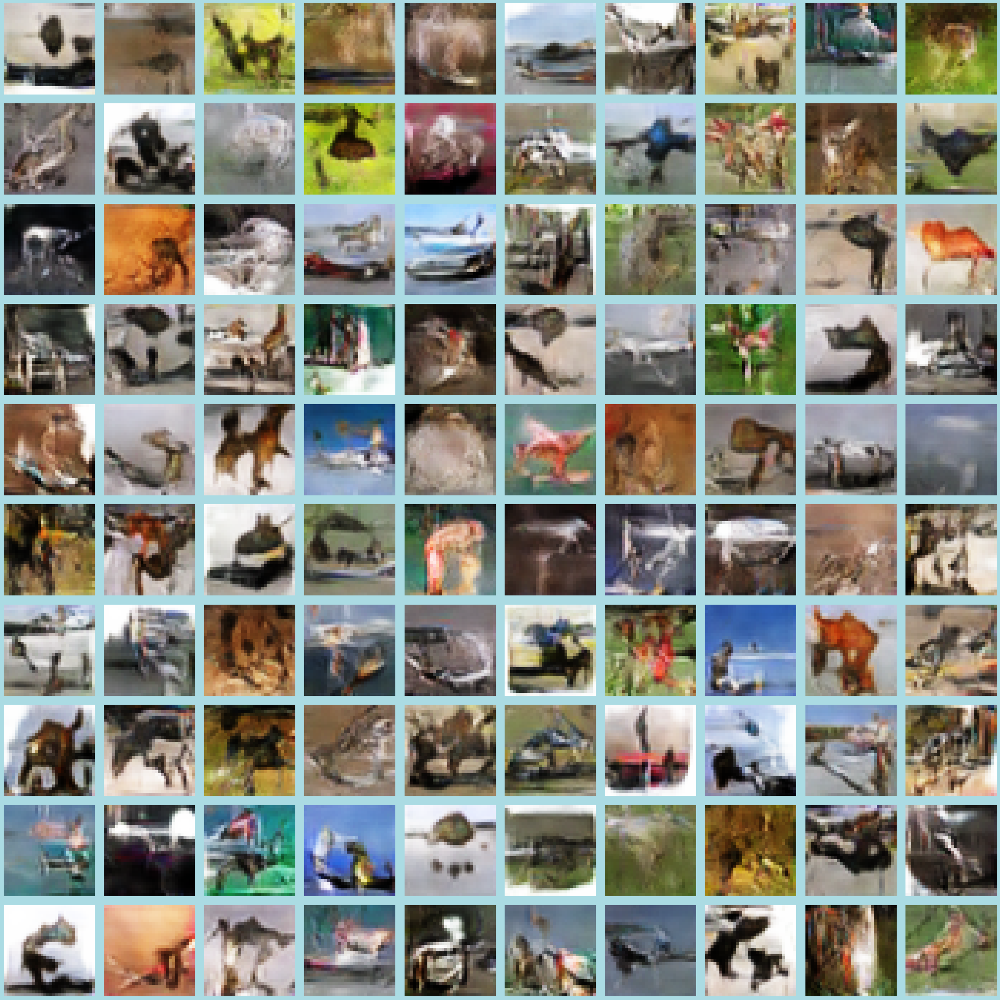

4/4 [==============================] - 0s 2ms/step


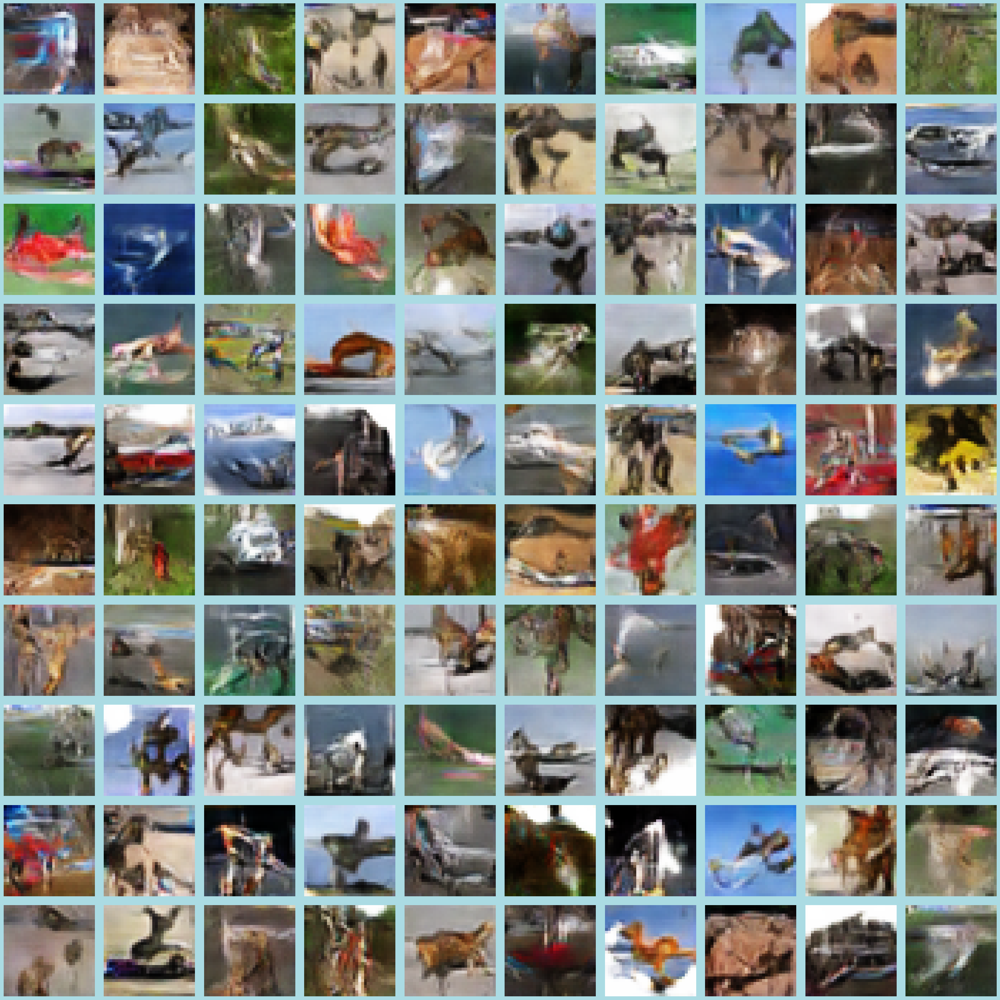

In [112]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

Similar compared to image classifier test

</div>

#### Storing the scores

In [113]:
new_row = {'Model':'ExponentialDecay DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_8['d_loss'][-1], 'g_loss':gan_history_8['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Non-Outlier DCGAN 3,46.075019,2.945318e-02,0.686637,0.746695
1,Sharpened Image DCGAN 3,680163.777727,3.370699e+07,0.684277,0.750914
2,Improved Data Generator DCGAN 3,700665.890898,3.764938e+07,0.689118,0.726457
3,CutMix DCGAN 3,51.564493,3.489228e-02,0.686637,0.746695
4,Oversample DCGAN 3,64.013066,4.585502e-02,0.647558,0.915615
5,CosineDecay DCGAN 3,46.440363,2.945601e-02,0.685025,0.751231
6,ExponentialDecay DCGAN 3,49.036579,3.086610e-02,0.683575,0.761838


### Best Model: Outlier DCGAN-3 FID 46

In [114]:
full_scores.to_csv('full_scores5.csv')